In [2]:
%matplotlib inline

import tensorflow as tf
import numpy as np
import time
import random
import sys
import os
import tensorflow.contrib.slim as slim
from nets.vgg import vgg_16 as vgg
from nets.vgg import vgg_arg_scope
import preprocessing.imagenet_utils as imagenet_utils
import preprocessing.vgg as preprocessing
import PIL.Image as Image
import glob
from matplotlib import pyplot as plt
#from imagenet_classes import class_names
from collections import defaultdict
#from io import StringIO
from pathlib import Path
from skimage import io
from skimage.transform import resize
import math
from scipy import signal
import pandas as pd
from MASC_core import MASC_core

try:
    xrange
except NameError:
    xrange = range

In [3]:
# Helper Functions 

def load_image(img_path):
    print("Loading image")
    img = np.array(Image.open(img_path))
    #img = imresize(img, (224, 224))
    # Converting shape from [224,224,3] tp [1,224,224,3]
    #x = np.expand_dims(img, axis=0)
    # Converting RGB to BGR for VGG
    #x = x[:,:,:,::-1]
    return img

    
def image_crop(im, bbox):
    return im[bbox[0]:bbox[0]+bbox[2], bbox[1]:bbox[1]+bbox[3],:]


def gauss2D(shape,sigma):
    m,n = [(ss-1.)/2. for ss in shape]
    y,x = np.ogrid[-m:m+1,-n:n+1]
    h = np.exp( -(x*x + y*y) / (2.*sigma*sigma) )
    h[ h < np.finfo(h.dtype).eps*h.max() ] = 0
    sumh = h.sum()
    if sumh != 0:
        h /= sumh
    return h


# importing the model

model_path = './modelparams/vgg_16.ckpt'
labels_to_names, label_names = imagenet_utils.create_readable_names_for_imagenet_labels()



search_displays_data = pd.read_excel('object_array_displays_fixation_data/object_array_displays_data_present.xlsx')

test_images_dir = "object_array_displays_fixation_data/search_displays"


#search_target = 892  # Microwave: 651      Wall clock = 892   Analog clock =       teddy bear =  850

cates = ['clock' ,'crib','fan','garbage_can','microwave_oven','rug','socks','teddy_bear','tent']

imagenet_cat_dict = {
    'clock' : 409,
    'crib'  : 520,
    'fan'   : 545,
    'garbage_can'    : 412,
    'microwave_oven' : 651,
    'rug'   : 741,
    'socks' : 806,
    'teddy_bear'     : 850,
    'tent'  : 672 
}


[-500 -400 -300 -200 -100    0  100  200  300  400  500]
crib    520
object_array_displays_fixation_data/search_displays/present_002.png
Loading image


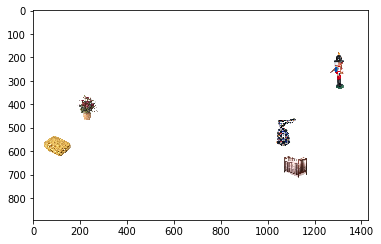

(893, 1428, 3)
Eye_movement  1
Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use standard file APIs to check for files with this prefix.
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt
Instructions for updating:
Create a `tf.sparse.SparseTensor` and use `tf.sparse.to_dense` instead.
Instructions for updating:
Deprecated in favor of operator or tf.math.divide.


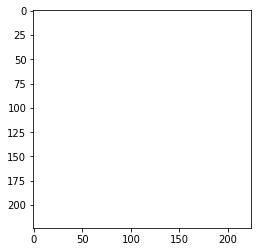

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


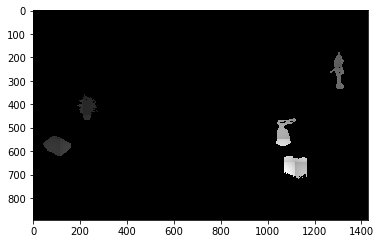

0.9782210288727381


/home/ec2-user/SageMaker/BCN/MASC_core.py:16: RuntimeWarning: invalid value encountered in true_divide
  phi=np.arctan( np.divide(np.multiply(np.exp(u/RETINA_BU), np.sin(v/RETINA_BV) ), np.multiply(np.exp(u/RETINA_BU) , np.cos(v/RETINA_BV))-1.0))


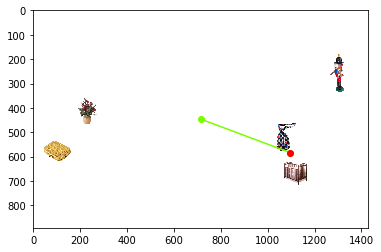

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


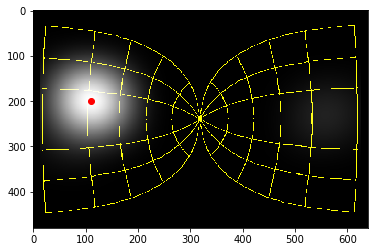

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


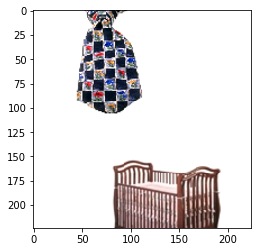

['Fixated area of the image and the classificatoin results']
0	 category: Windsor tie; confidence:8.0470,	labelID: n04591157 906
1	 category: muzzle; confidence:7.5890,	labelID: n03803284 676
2	 category: bow tie, bow-tie, bowtie; confidence:6.8861,	labelID: n02883205 457
3	 category: necklace; confidence:6.7759,	labelID: n03814906 679
4	 category: hamper; confidence:6.3930,	labelID: n03482405 588
Priority map


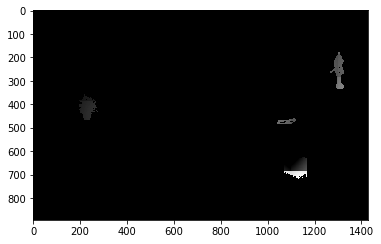

0.9416335465503367


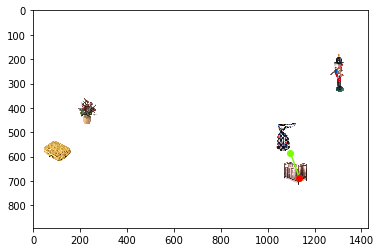

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


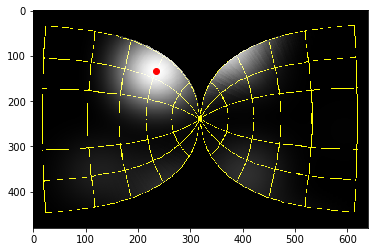

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


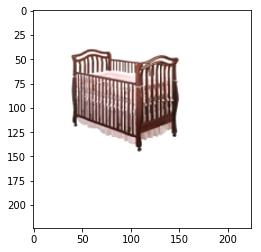

['Fixated area of the image and the classificatoin results']
0	 category: cradle; confidence:12.8651,	labelID: n03125729 516
1	 category: crib, cot; confidence:12.7539,	labelID: n03131574 520
2	 category: bassinet; confidence:9.5316,	labelID: n02804414 431
3	 category: studio couch, day bed; confidence:9.5160,	labelID: n04344873 831
4	 category: plate rack; confidence:8.4960,	labelID: n03961711 729


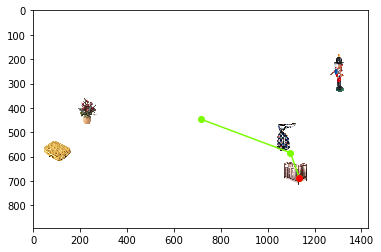

rug    741
object_array_displays_fixation_data/search_displays/present_004.png
Loading image


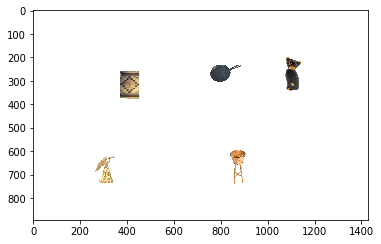

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


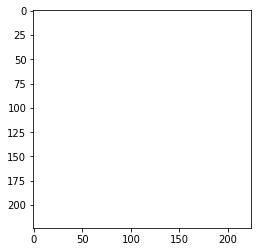

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


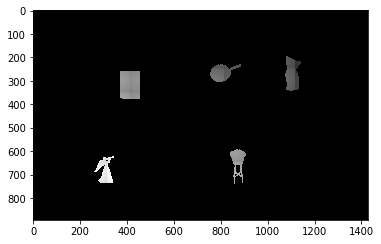

0.9189302805356355


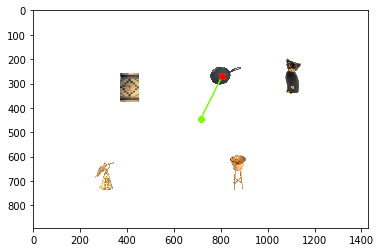

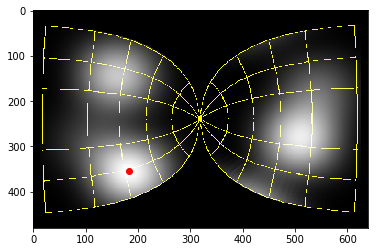

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


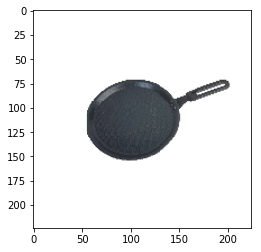

['Fixated area of the image and the classificatoin results']
0	 category: microphone, mike; confidence:9.0636,	labelID: n03759954 650
1	 category: strainer; confidence:8.2707,	labelID: n04332243 828
2	 category: nail; confidence:7.8843,	labelID: n03804744 677
3	 category: whistle; confidence:7.8317,	labelID: n04579432 902
4	 category: frying pan, frypan, skillet; confidence:7.3573,	labelID: n03400231 567
Priority map


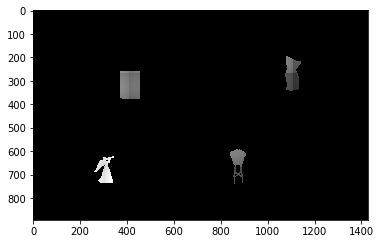

0.9645325436922773


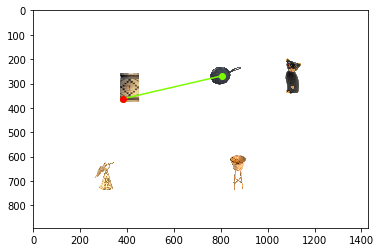

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


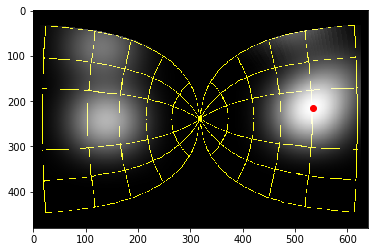

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


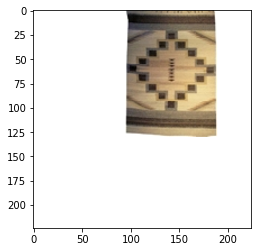

['Fixated area of the image and the classificatoin results']
0	 category: paper towel; confidence:6.4366,	labelID: n03887697 700
1	 category: lighter, light, igniter, ignitor; confidence:5.7942,	labelID: n03666591 626
2	 category: oil filter; confidence:5.6437,	labelID: n03843555 686
3	 category: abacus; confidence:5.4940,	labelID: n02666196 398
4	 category: turnstile; confidence:5.4282,	labelID: n04501370 877
Priority map


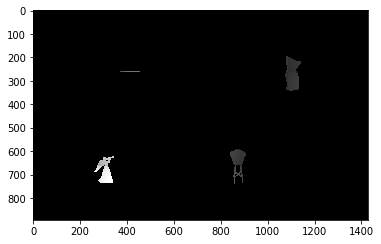

0.9745397394978195


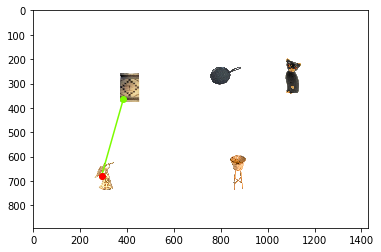

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


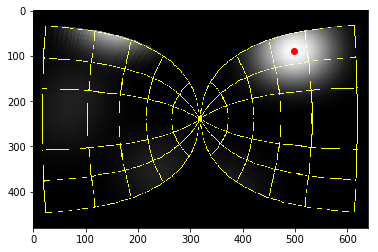

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


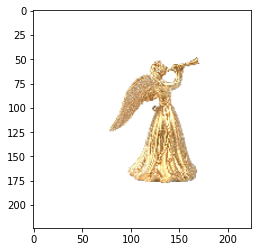

['Fixated area of the image and the classificatoin results']
0	 category: starfish, sea star; confidence:6.2277,	labelID: n02317335 327
1	 category: necklace; confidence:5.4246,	labelID: n03814906 679
2	 category: conch; confidence:5.4160,	labelID: n01943899 112
3	 category: stole; confidence:4.9867,	labelID: n04325704 824
4	 category: banana; confidence:4.8888,	labelID: n07753592 954
Priority map


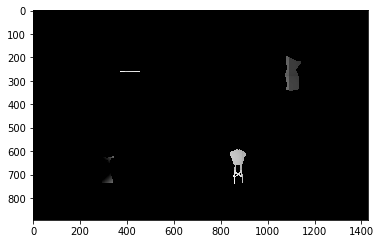

0.5655178609006118


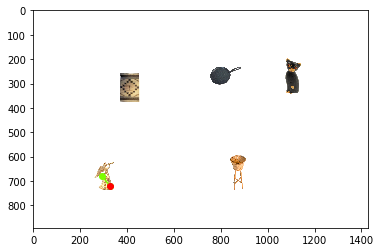

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


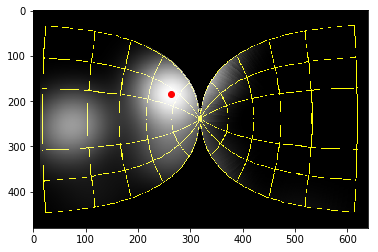

Eye_movement  5
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


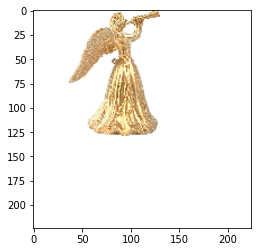

['Fixated area of the image and the classificatoin results']
0	 category: necklace; confidence:6.2680,	labelID: n03814906 679
1	 category: table lamp; confidence:5.1233,	labelID: n04380533 846
2	 category: chime, bell, gong; confidence:4.9958,	labelID: n03017168 494
3	 category: lampshade, lamp shade; confidence:4.8572,	labelID: n03637318 619
4	 category: mortarboard; confidence:4.7721,	labelID: n03787032 667
Priority map


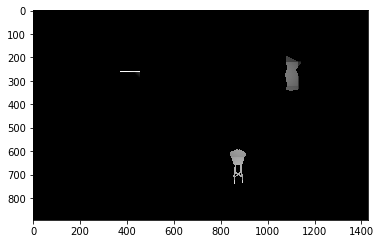

0.6396900290415627


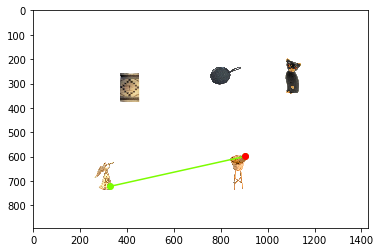

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


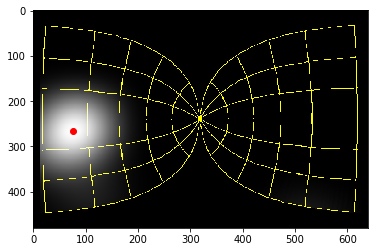

Eye_movement  6
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


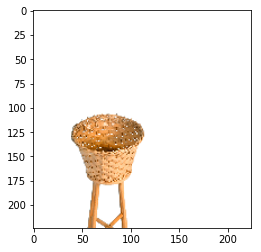

['Fixated area of the image and the classificatoin results']
0	 category: matchstick; confidence:8.7535,	labelID: n03729826 644
1	 category: maraca; confidence:8.6044,	labelID: n03720891 641
2	 category: hourglass; confidence:7.3934,	labelID: n03544143 604
3	 category: drum, membranophone, tympan; confidence:7.1215,	labelID: n03249569 541
4	 category: thimble; confidence:7.0894,	labelID: n04423845 855
Priority map


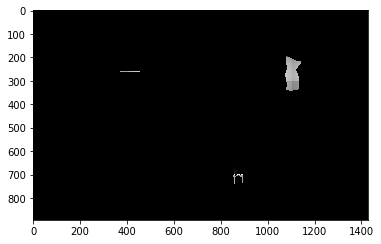

0.62751366812229


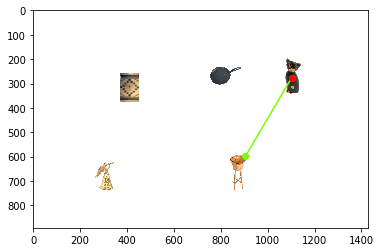

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


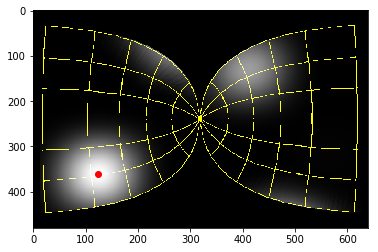

Eye_movement  7
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


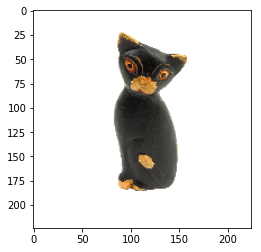

['Fixated area of the image and the classificatoin results']
0	 category: indri, indris, Indri indri, Indri brevicaudatus; confidence:8.5149,	labelID: n02500267 384
1	 category: Egyptian cat; confidence:7.3924,	labelID: n02124075 285
2	 category: knee pad; confidence:7.2999,	labelID: n03623198 615
3	 category: mask; confidence:6.8394,	labelID: n03724870 643
4	 category: ski mask; confidence:6.2312,	labelID: n04229816 796
Priority map


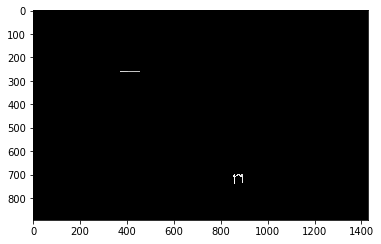

0.4615771479306851


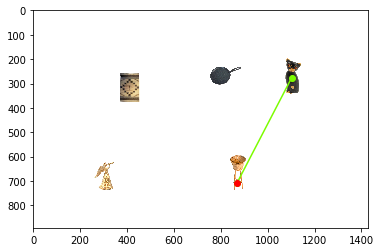

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


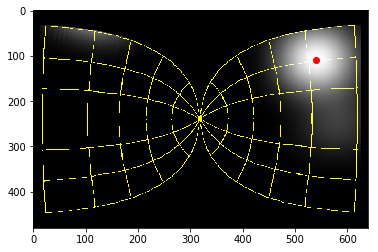

Eye_movement  8
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


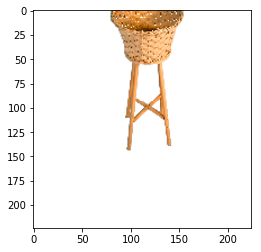

['Fixated area of the image and the classificatoin results']
0	 category: drum, membranophone, tympan; confidence:8.8142,	labelID: n03249569 541
1	 category: matchstick; confidence:7.9038,	labelID: n03729826 644
2	 category: gong, tam-tam; confidence:7.7999,	labelID: n03447721 577
3	 category: chime, bell, gong; confidence:7.5059,	labelID: n03017168 494
4	 category: microphone, mike; confidence:7.1734,	labelID: n03759954 650
Priority map


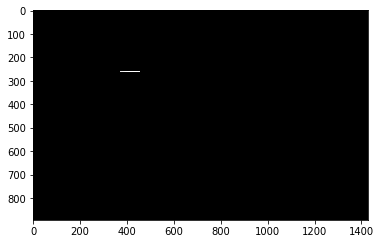

0.37812801120857675


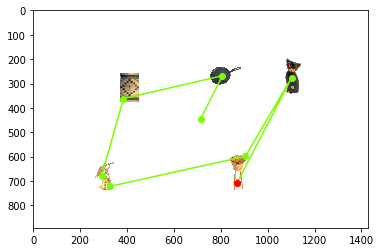

teddy_bear    850
object_array_displays_fixation_data/search_displays/present_008.png
Loading image


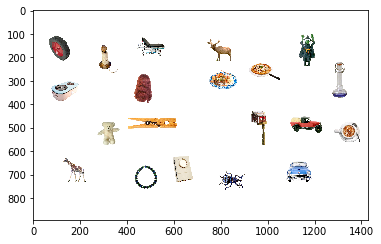

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


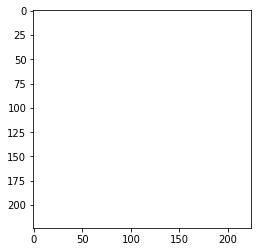

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


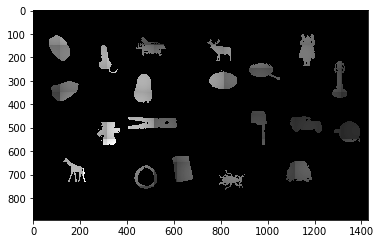

0.8676339741560739


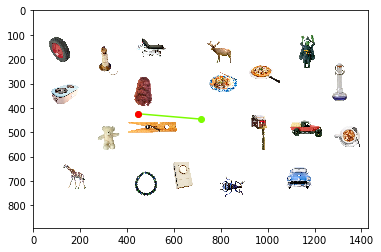

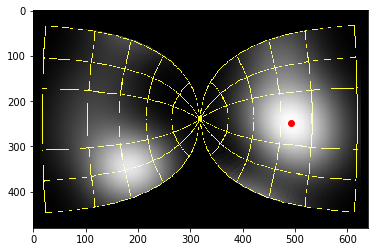

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


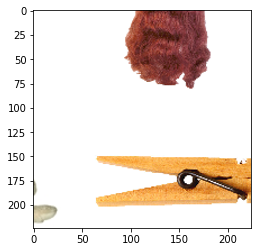

['Fixated area of the image and the classificatoin results']
0	 category: hair slide; confidence:7.1172,	labelID: n03476684 584
1	 category: hook, claw; confidence:7.0107,	labelID: n03532672 600
2	 category: maraca; confidence:5.8334,	labelID: n03720891 641
3	 category: nail; confidence:5.7628,	labelID: n03804744 677
4	 category: matchstick; confidence:5.6364,	labelID: n03729826 644
Priority map


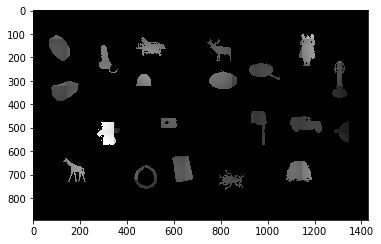

1.0


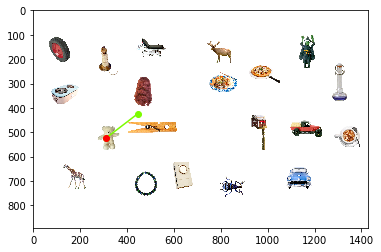

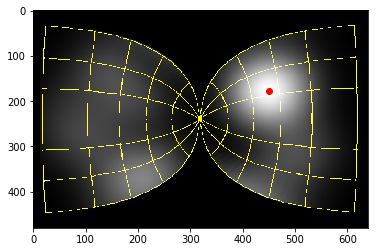

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


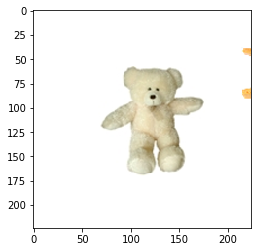

['Fixated area of the image and the classificatoin results']
0	 category: teddy, teddy bear; confidence:9.2478,	labelID: n04399382 850
1	 category: ice bear, polar bear, Ursus Maritimus, Thalarctos maritimus; confidence:8.0697,	labelID: n02134084 296
2	 category: nipple; confidence:6.8624,	labelID: n03825788 680
3	 category: rubber eraser, rubber, pencil eraser; confidence:5.4411,	labelID: n04116512 767
4	 category: golden retriever; confidence:5.3020,	labelID: n02099601 207


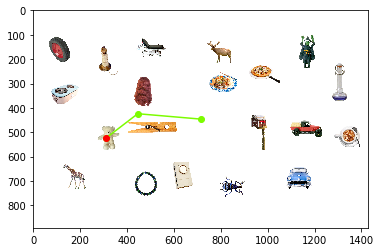

rug    741
object_array_displays_fixation_data/search_displays/present_009.png
Loading image


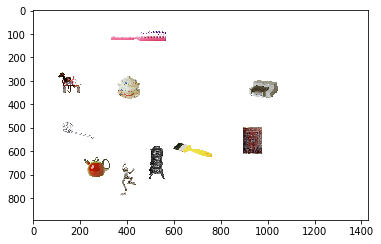

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


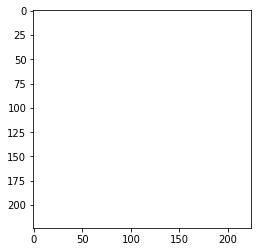

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


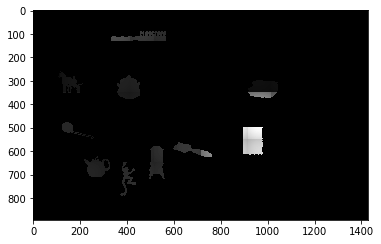

0.9947035790149673


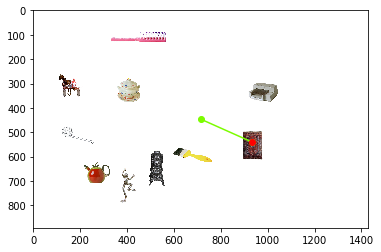

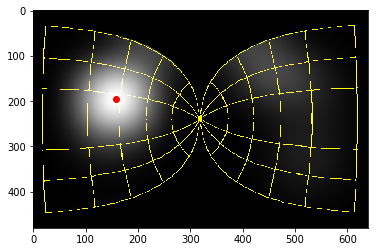

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


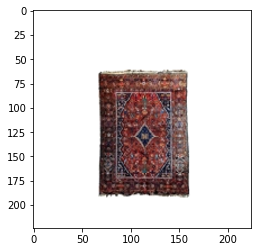

['Fixated area of the image and the classificatoin results']
0	 category: prayer rug, prayer mat; confidence:13.4533,	labelID: n03998194 741
1	 category: doormat, welcome mat; confidence:8.9704,	labelID: n03223299 539
2	 category: Windsor tie; confidence:7.9152,	labelID: n04591157 906
3	 category: wallet, billfold, notecase, pocketbook; confidence:7.3613,	labelID: n04548362 893
4	 category: wool, woolen, woollen; confidence:7.2638,	labelID: n04599235 911


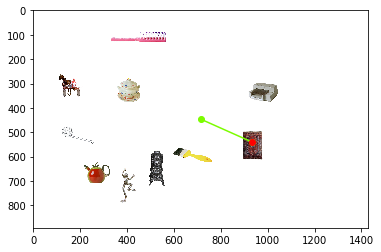

microwave_oven    651
object_array_displays_fixation_data/search_displays/present_017.png
Loading image


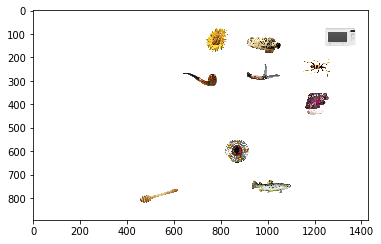

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


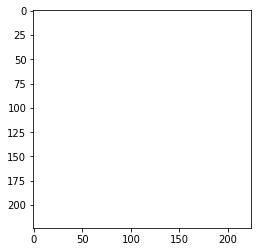

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


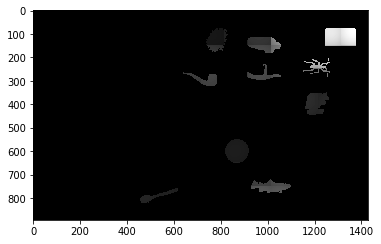

0.67257343892761


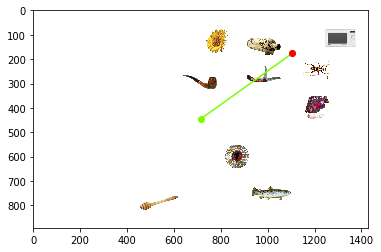

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


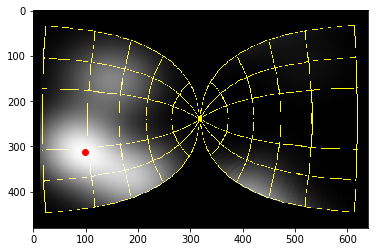

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


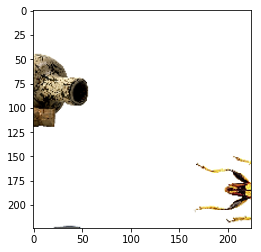

['Fixated area of the image and the classificatoin results']
0	 category: weevil; confidence:7.1750,	labelID: n02177972 307
1	 category: rhinoceros beetle; confidence:5.6870,	labelID: n02174001 306
2	 category: acorn; confidence:5.4370,	labelID: n12267677 988
3	 category: tick; confidence:5.2763,	labelID: n01776313 78
4	 category: pencil sharpener; confidence:5.2507,	labelID: n03908714 710
Priority map


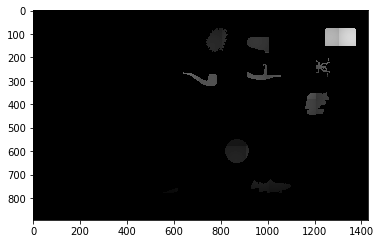

0.8751646073162948


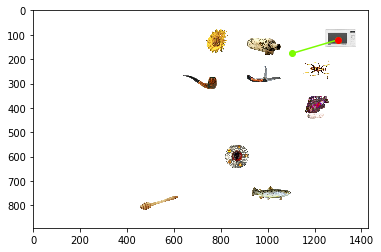

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


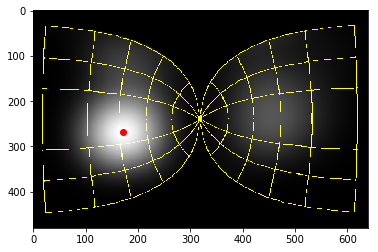

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


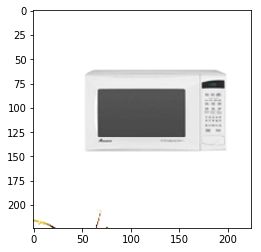

['Fixated area of the image and the classificatoin results']
0	 category: radio, wireless; confidence:8.4369,	labelID: n04041544 754
1	 category: microwave, microwave oven; confidence:7.3138,	labelID: n03761084 651
2	 category: loudspeaker, speaker, speaker unit, loudspeaker system, speaker system; confidence:6.9453,	labelID: n03691459 632
3	 category: digital clock; confidence:6.8311,	labelID: n03196217 530
4	 category: projector; confidence:6.6257,	labelID: n04009552 745


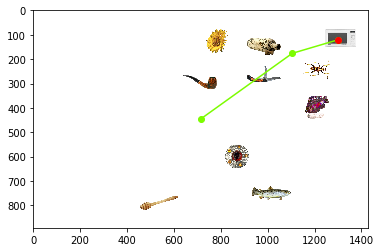

tent    672
object_array_displays_fixation_data/search_displays/present_019.png
Loading image


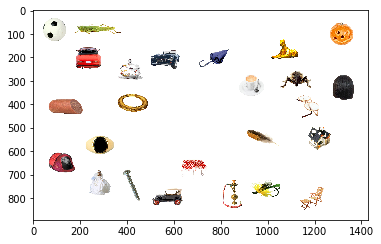

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


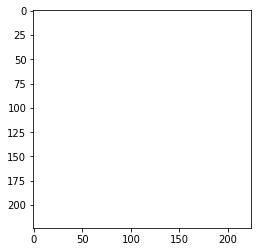

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


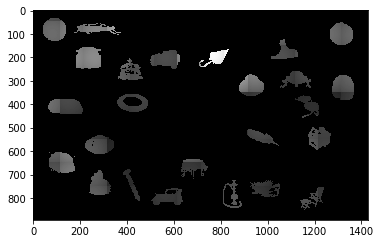

0.9159651612681173


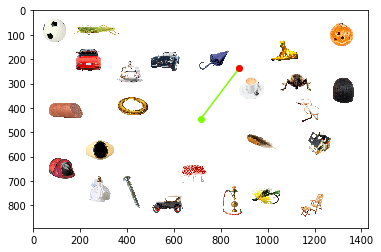

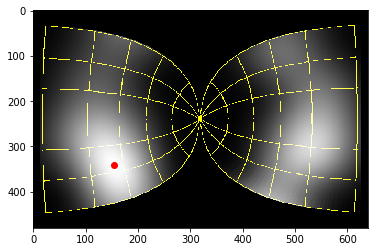

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


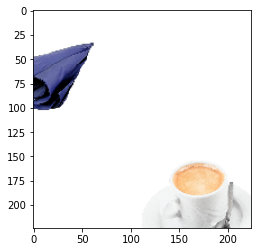

['Fixated area of the image and the classificatoin results']
0	 category: espresso maker; confidence:6.9902,	labelID: n03297495 550
1	 category: mortarboard; confidence:6.9158,	labelID: n03787032 667
2	 category: cup; confidence:6.2065,	labelID: n07930864 968
3	 category: coffeepot; confidence:5.7787,	labelID: n03063689 505
4	 category: piggy bank, penny bank; confidence:5.6813,	labelID: n03935335 719
Priority map


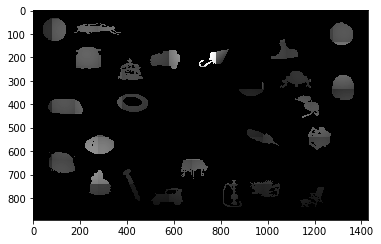

0.9197741213471906


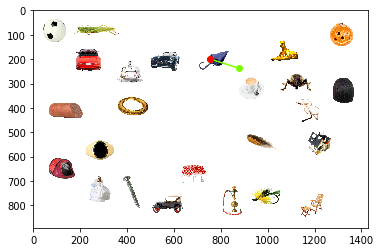

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


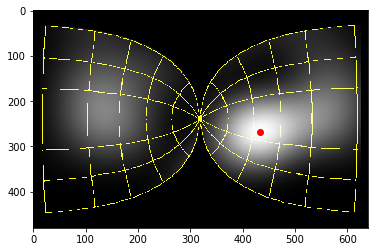

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


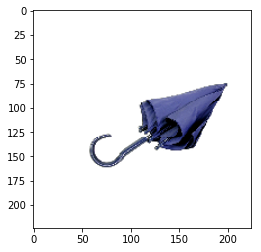

['Fixated area of the image and the classificatoin results']
0	 category: hook, claw; confidence:7.2267,	labelID: n03532672 600
1	 category: stretcher; confidence:7.1363,	labelID: n04336792 830
2	 category: tricycle, trike, velocipede; confidence:6.4523,	labelID: n04482393 870
3	 category: vacuum, vacuum cleaner; confidence:5.7840,	labelID: n04517823 882
4	 category: muzzle; confidence:5.5620,	labelID: n03803284 676
Priority map


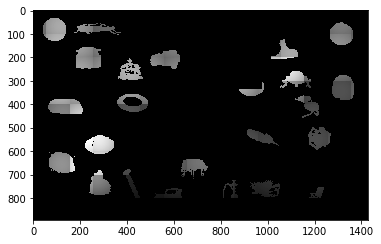

0.45659751074170685


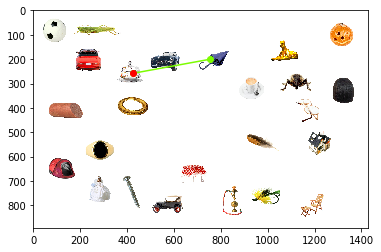

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


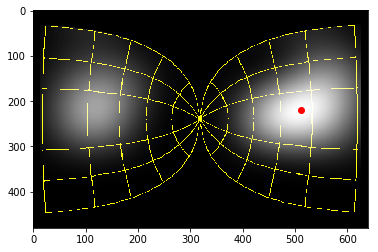

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


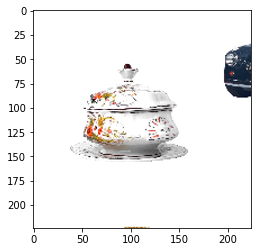

['Fixated area of the image and the classificatoin results']
0	 category: teapot; confidence:5.9134,	labelID: n04398044 849
1	 category: stove; confidence:5.7920,	labelID: n04330267 827
2	 category: snowmobile; confidence:5.7621,	labelID: n04252077 802
3	 category: coffeepot; confidence:5.2138,	labelID: n03063689 505
4	 category: Dutch oven; confidence:5.1898,	labelID: n03259280 544
Priority map


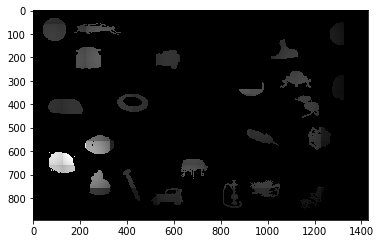

0.9920676152680321


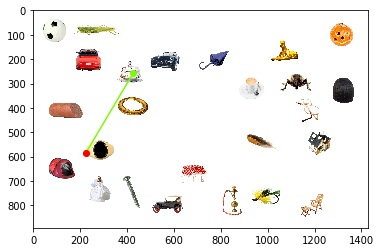

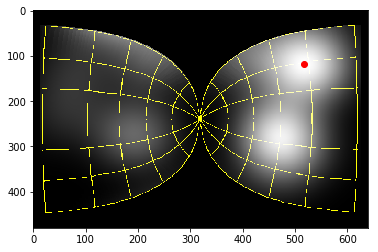

Eye_movement  5
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


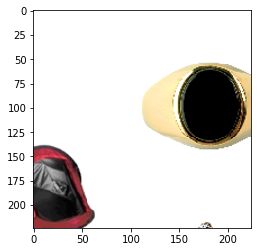

['Fixated area of the image and the classificatoin results']
0	 category: pencil sharpener; confidence:7.8457,	labelID: n03908714 710
1	 category: binoculars, field glasses, opera glasses; confidence:7.5399,	labelID: n02841315 447
2	 category: loupe, jeweler's loupe; confidence:6.8532,	labelID: n03692522 633
3	 category: whistle; confidence:6.3122,	labelID: n04579432 902
4	 category: buckle; confidence:6.2168,	labelID: n02910353 464
Priority map


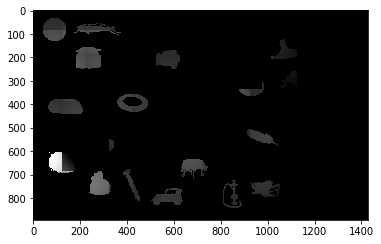

0.9997417935346383


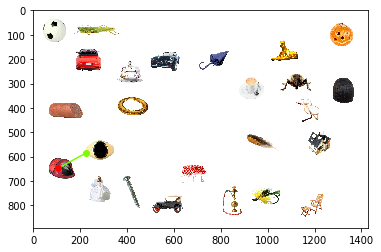

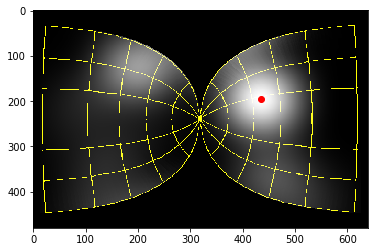

Eye_movement  6
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


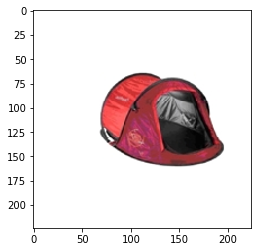

['Fixated area of the image and the classificatoin results']
0	 category: sandal; confidence:8.3434,	labelID: n04133789 774
1	 category: sleeping bag; confidence:8.0697,	labelID: n04235860 797
2	 category: mountain tent; confidence:7.3905,	labelID: n03792972 672
3	 category: pencil sharpener; confidence:7.3668,	labelID: n03908714 710
4	 category: sunglasses, dark glasses, shades; confidence:6.9280,	labelID: n04356056 837


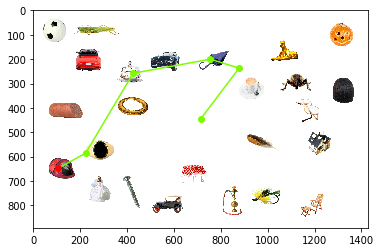

garbage_can    412
object_array_displays_fixation_data/search_displays/present_020.png
Loading image


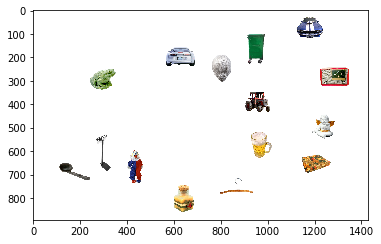

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


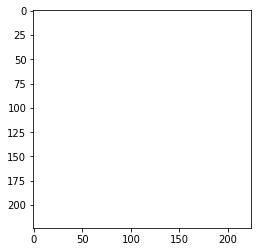

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


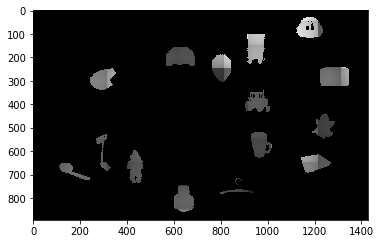

0.6743054810254969


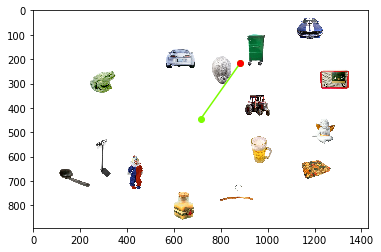

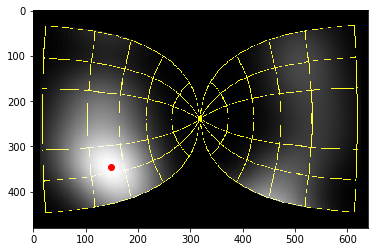

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


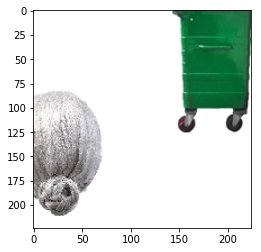

['Fixated area of the image and the classificatoin results']
0	 category: barrow, garden cart, lawn cart, wheelbarrow; confidence:6.6334,	labelID: n02797295 428
1	 category: desk; confidence:6.4022,	labelID: n03179701 526
2	 category: thresher, thrasher, threshing machine; confidence:6.2910,	labelID: n04428191 856
3	 category: hook, claw; confidence:6.1948,	labelID: n03532672 600
4	 category: barrel, cask; confidence:5.6801,	labelID: n02795169 427
Priority map


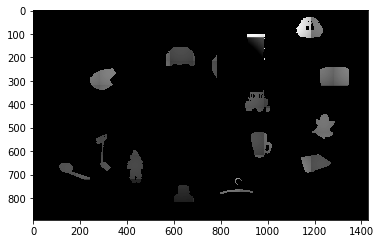

0.8444336043193983


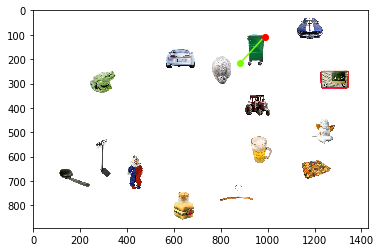

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


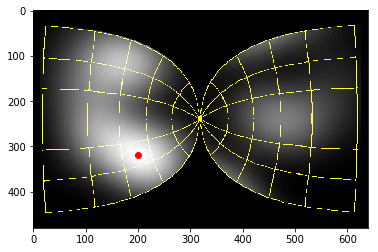

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


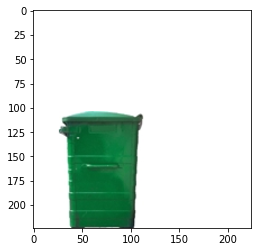

['Fixated area of the image and the classificatoin results']
0	 category: bucket, pail; confidence:8.8809,	labelID: n02909870 463
1	 category: barrel, cask; confidence:7.5219,	labelID: n02795169 427
2	 category: ashcan, trash can, garbage can, wastebin, ash bin, ash-bin, ashbin, dustbin, trash barrel, trash bin; confidence:7.2843,	labelID: n02747177 412
3	 category: shopping basket; confidence:7.1963,	labelID: n04204238 790
4	 category: measuring cup; confidence:6.7836,	labelID: n03733805 647


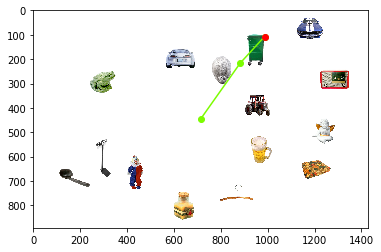

microwave_oven    651
object_array_displays_fixation_data/search_displays/present_021.png
Loading image


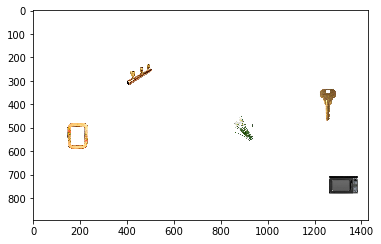

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


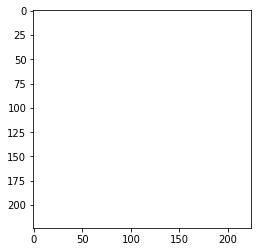

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


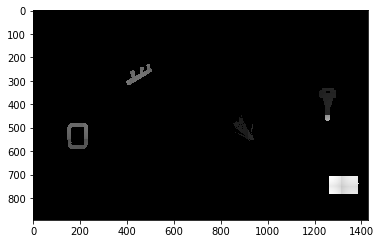

0.6662442175625002


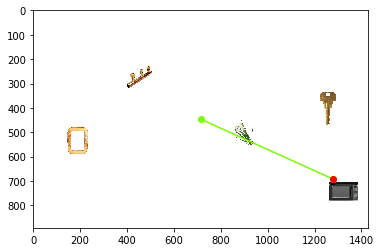

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


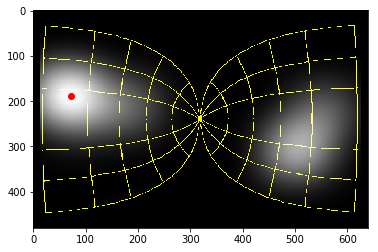

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


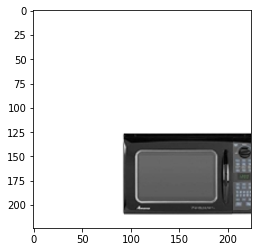

['Fixated area of the image and the classificatoin results']
0	 category: radio, wireless; confidence:8.7713,	labelID: n04041544 754
1	 category: digital clock; confidence:8.4143,	labelID: n03196217 530
2	 category: CD player; confidence:7.9029,	labelID: n02988304 485
3	 category: microwave, microwave oven; confidence:7.7172,	labelID: n03761084 651
4	 category: tape player; confidence:7.7121,	labelID: n04392985 848


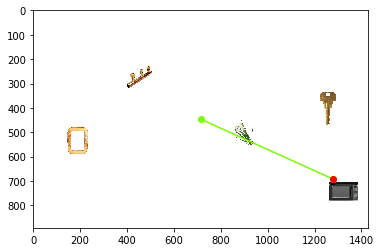

garbage_can    412
object_array_displays_fixation_data/search_displays/present_022.png
Loading image


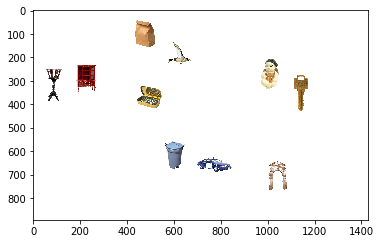

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


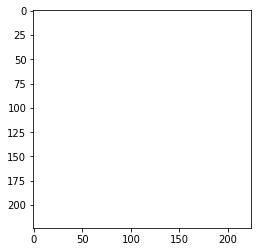

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


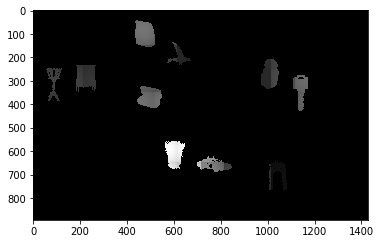

0.9927578606917498


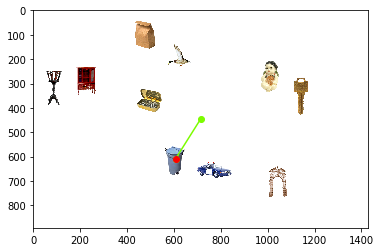

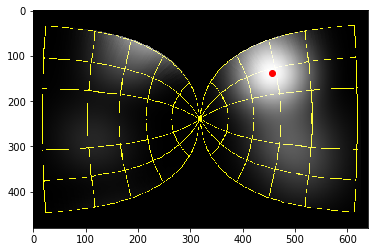

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


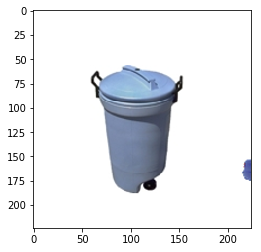

['Fixated area of the image and the classificatoin results']
0	 category: bucket, pail; confidence:12.0058,	labelID: n02909870 463
1	 category: ashcan, trash can, garbage can, wastebin, ash bin, ash-bin, ashbin, dustbin, trash barrel, trash bin; confidence:10.3354,	labelID: n02747177 412
2	 category: water jug; confidence:9.2995,	labelID: n04560804 899
3	 category: barrel, cask; confidence:8.9434,	labelID: n02795169 427
4	 category: Dutch oven; confidence:8.7057,	labelID: n03259280 544


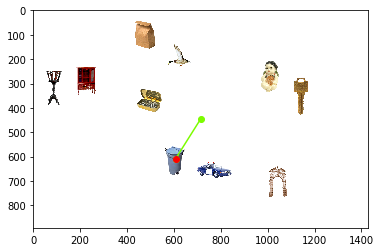

socks    806
object_array_displays_fixation_data/search_displays/present_025.png
Loading image


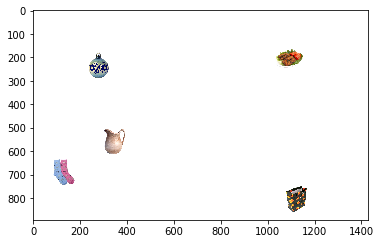

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


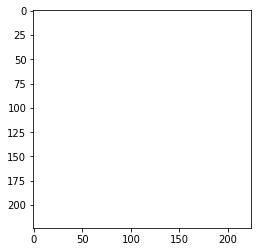

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


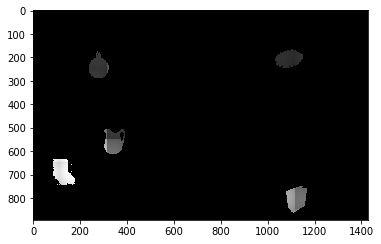

0.646576187508389


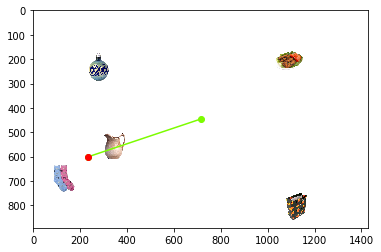

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


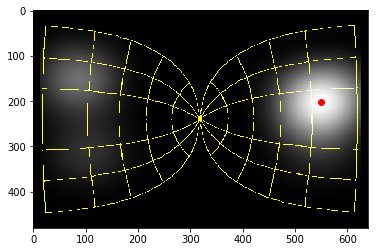

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


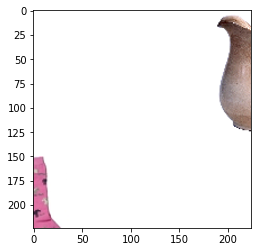

['Fixated area of the image and the classificatoin results']
0	 category: pitcher, ewer; confidence:7.4304,	labelID: n03950228 725
1	 category: teapot; confidence:7.1433,	labelID: n04398044 849
2	 category: albatross, mollymawk; confidence:5.8703,	labelID: n02058221 146
3	 category: partridge; confidence:5.6637,	labelID: n01807496 86
4	 category: ruffed grouse, partridge, Bonasa umbellus; confidence:5.6596,	labelID: n01797886 82
Priority map


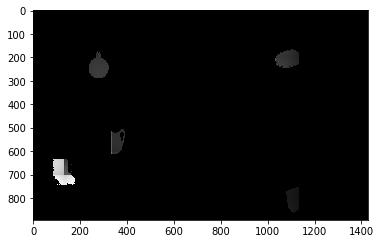

0.9676538304127262


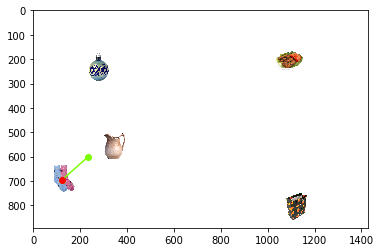

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


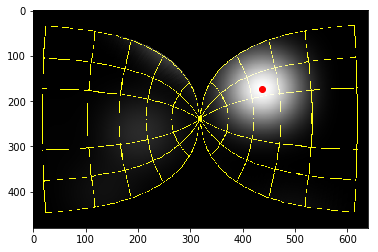

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


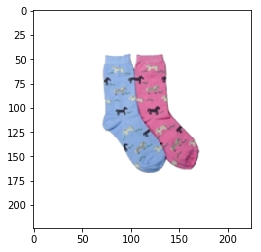

['Fixated area of the image and the classificatoin results']
0	 category: sock; confidence:9.2275,	labelID: n04254777 806
1	 category: Christmas stocking; confidence:8.4782,	labelID: n03026506 496
2	 category: diaper, nappy, napkin; confidence:7.3966,	labelID: n03188531 529
3	 category: Band Aid; confidence:6.9958,	labelID: n02786058 419
4	 category: mitten; confidence:6.7782,	labelID: n03775071 658


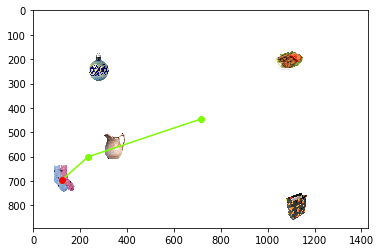

clock    409
object_array_displays_fixation_data/search_displays/present_028.png
Loading image


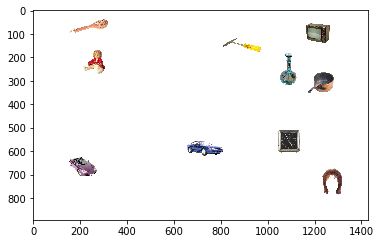

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


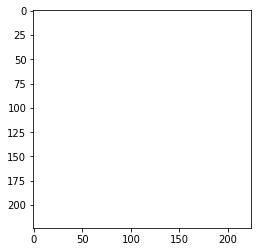

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


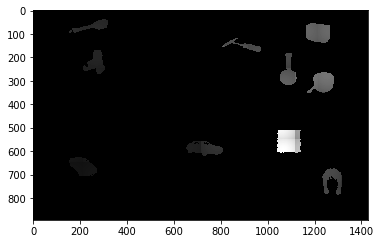

1.0


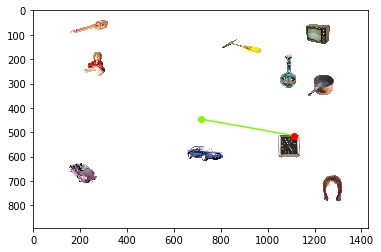

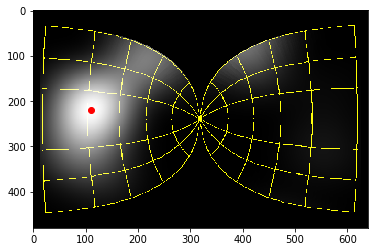

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


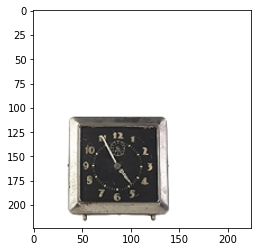

['Fixated area of the image and the classificatoin results']
0	 category: digital clock; confidence:9.7212,	labelID: n03196217 530
1	 category: analog clock; confidence:9.6869,	labelID: n02708093 409
2	 category: wall clock; confidence:9.3380,	labelID: n04548280 892
3	 category: magnetic compass; confidence:8.1616,	labelID: n03706229 635
4	 category: switch, electric switch, electrical switch; confidence:7.9662,	labelID: n04372370 844


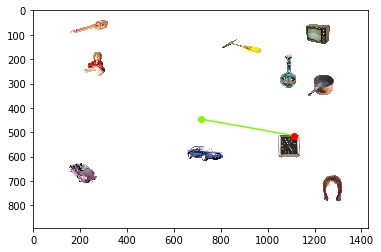

teddy_bear    850
object_array_displays_fixation_data/search_displays/present_031.png
Loading image


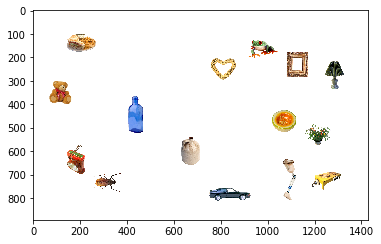

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


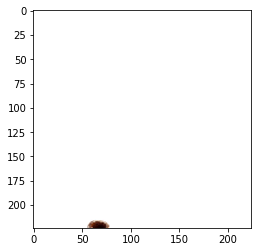

['Fixated area of the image and the classificatoin results']
0	 category: buckeye, horse chestnut, conker; confidence:3.6423,	labelID: n12768682 990
1	 category: nail; confidence:3.3187,	labelID: n03804744 677
2	 category: tick; confidence:3.1214,	labelID: n01776313 78
3	 category: acorn; confidence:2.9743,	labelID: n12267677 988
4	 category: ladybug, ladybeetle, lady beetle, ladybird, ladybird beetle; confidence:2.8912,	labelID: n02165456 301
Priority map


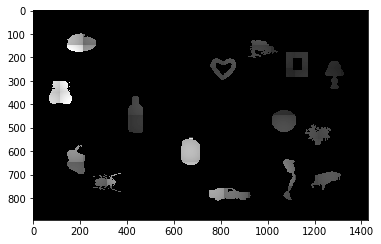

0.8828482181405851


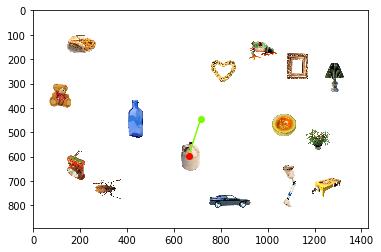

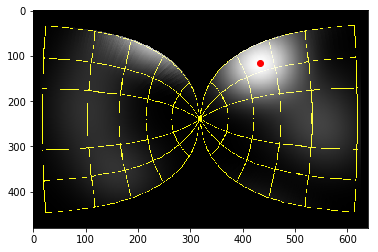

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


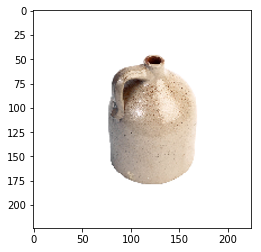

['Fixated area of the image and the classificatoin results']
0	 category: saltshaker, salt shaker; confidence:8.3568,	labelID: n04131690 773
1	 category: whiskey jug; confidence:8.1100,	labelID: n04579145 901
2	 category: piggy bank, penny bank; confidence:6.9409,	labelID: n03935335 719
3	 category: earthstar; confidence:6.7837,	labelID: n13044778 995
4	 category: teapot; confidence:6.1684,	labelID: n04398044 849
Priority map


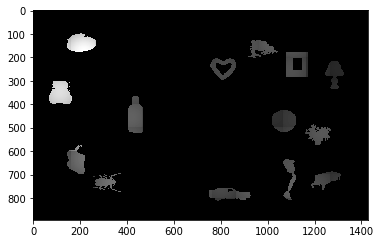

0.8188596449641723


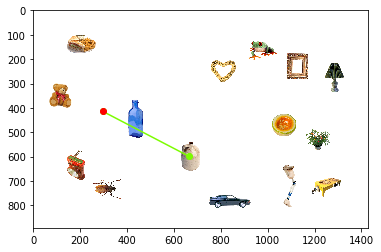

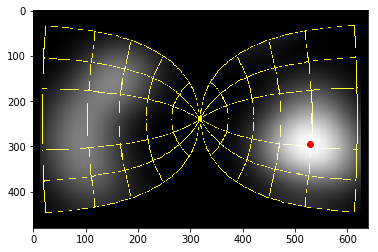

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


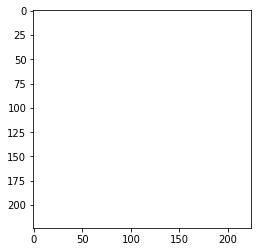

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


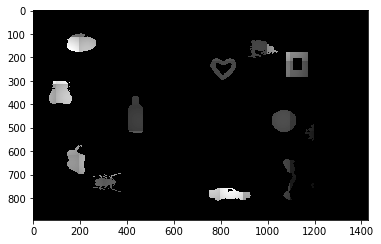

0.8160918400931549


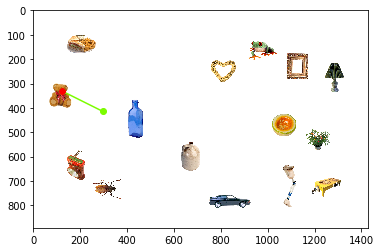

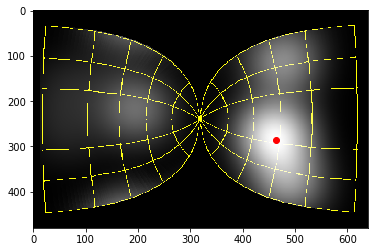

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


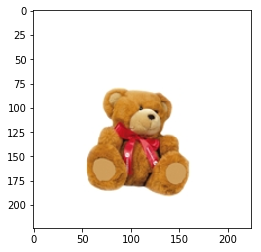

['Fixated area of the image and the classificatoin results']
0	 category: teddy, teddy bear; confidence:11.2108,	labelID: n04399382 850
1	 category: hamper; confidence:9.0275,	labelID: n03482405 588
2	 category: hair slide; confidence:7.9799,	labelID: n03476684 584
3	 category: pill bottle; confidence:7.9731,	labelID: n03937543 720
4	 category: pretzel; confidence:7.9655,	labelID: n07695742 932


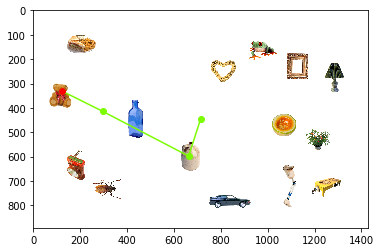

garbage_can    412
object_array_displays_fixation_data/search_displays/present_033.png
Loading image


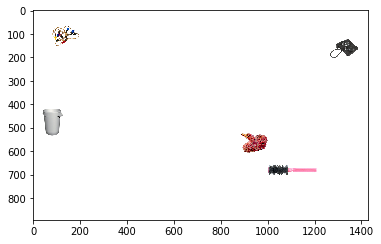

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


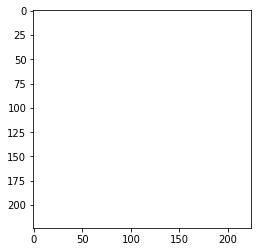

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


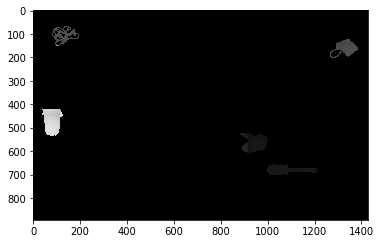

0.6956125060037637


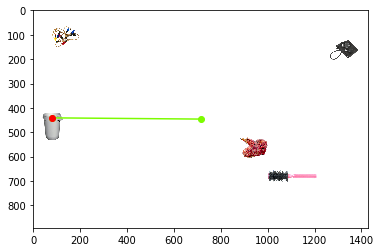

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


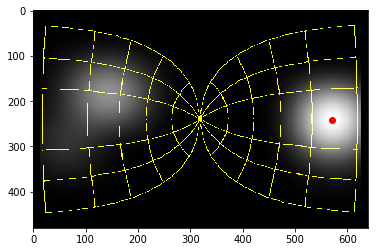

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


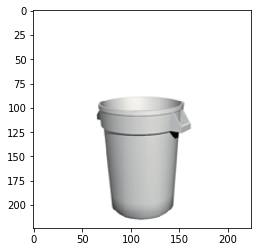

['Fixated area of the image and the classificatoin results']
0	 category: bucket, pail; confidence:12.5562,	labelID: n02909870 463
1	 category: measuring cup; confidence:10.3645,	labelID: n03733805 647
2	 category: ashcan, trash can, garbage can, wastebin, ash bin, ash-bin, ashbin, dustbin, trash barrel, trash bin; confidence:9.9839,	labelID: n02747177 412
3	 category: mortar; confidence:8.6532,	labelID: n03786901 666
4	 category: milk can; confidence:8.6286,	labelID: n03764736 653


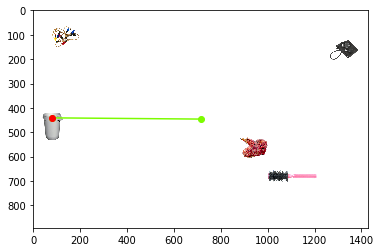

crib    520
object_array_displays_fixation_data/search_displays/present_036.png
Loading image


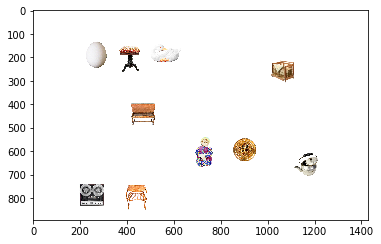

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


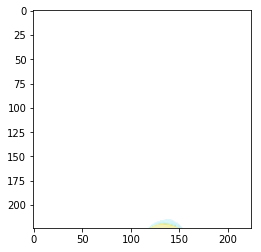

['Fixated area of the image and the classificatoin results']
0	 category: tennis ball; confidence:7.1445,	labelID: n04409515 852
1	 category: Granny Smith; confidence:5.5327,	labelID: n07742313 948
2	 category: maraca; confidence:4.8815,	labelID: n03720891 641
3	 category: croquet ball; confidence:4.5639,	labelID: n03134739 522
4	 category: golf ball; confidence:4.3461,	labelID: n03445777 574
Priority map


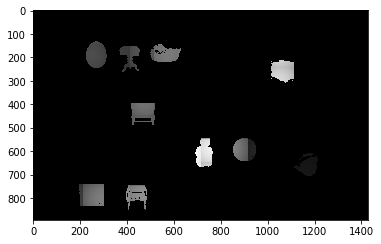

0.9478760237586997


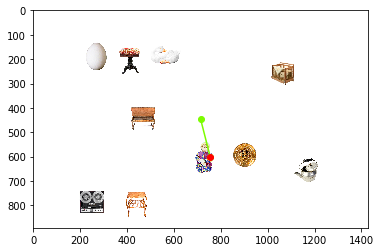

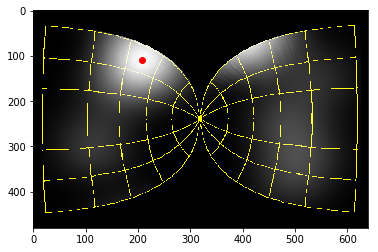

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


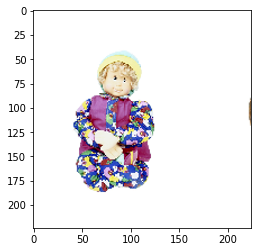

['Fixated area of the image and the classificatoin results']
0	 category: teddy, teddy bear; confidence:7.2123,	labelID: n04399382 850
1	 category: hair slide; confidence:6.7238,	labelID: n03476684 584
2	 category: pajama, pyjama, pj's, jammies; confidence:6.7231,	labelID: n03877472 697
3	 category: rubber eraser, rubber, pencil eraser; confidence:6.4235,	labelID: n04116512 767
4	 category: Band Aid; confidence:6.3201,	labelID: n02786058 419
Priority map


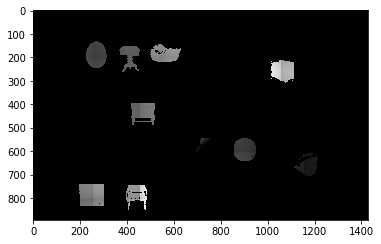

0.7562449703298583


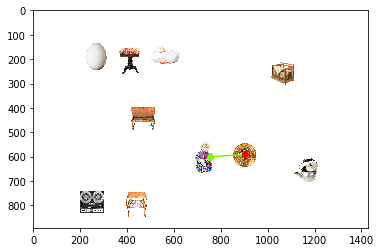

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


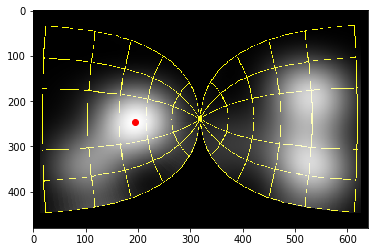

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


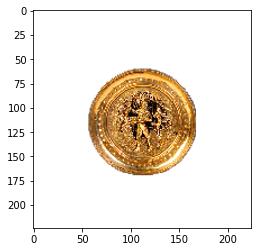

['Fixated area of the image and the classificatoin results']
0	 category: magnetic compass; confidence:7.2879,	labelID: n03706229 635
1	 category: barometer; confidence:6.1080,	labelID: n02794156 426
2	 category: gong, tam-tam; confidence:6.0349,	labelID: n03447721 577
3	 category: snail; confidence:4.9998,	labelID: n01944390 113
4	 category: tick; confidence:4.9376,	labelID: n01776313 78
Priority map


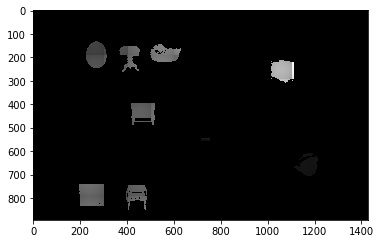

0.7863599272986739


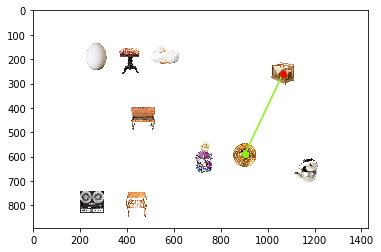

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


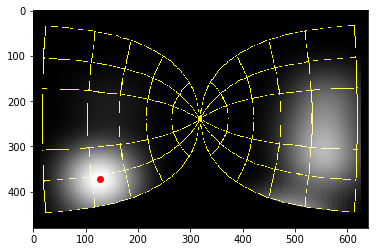

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


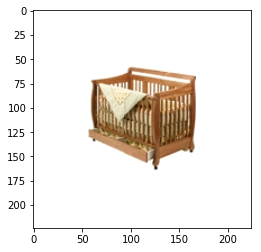

['Fixated area of the image and the classificatoin results']
0	 category: cradle; confidence:11.9420,	labelID: n03125729 516
1	 category: crib, cot; confidence:11.3488,	labelID: n03131574 520
2	 category: plate rack; confidence:11.1788,	labelID: n03961711 729
3	 category: hamper; confidence:10.6771,	labelID: n03482405 588
4	 category: folding chair; confidence:8.8855,	labelID: n03376595 559


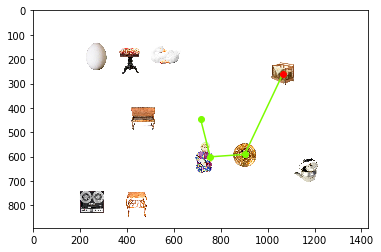

tent    672
object_array_displays_fixation_data/search_displays/present_040.png
Loading image


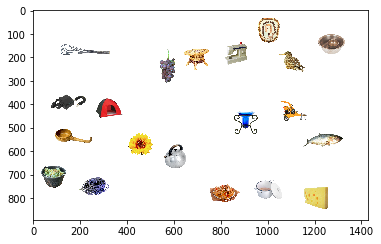

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


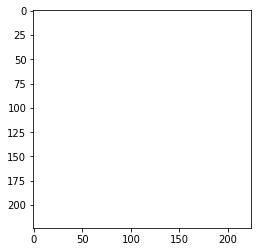

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


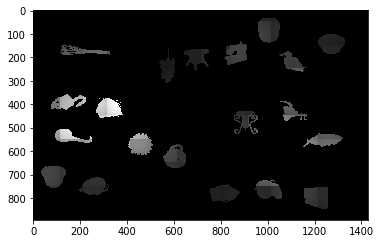

0.9093898767347651


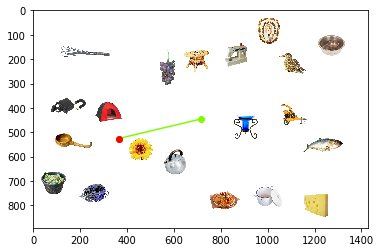

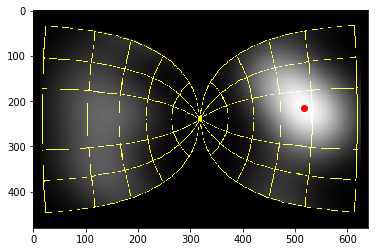

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


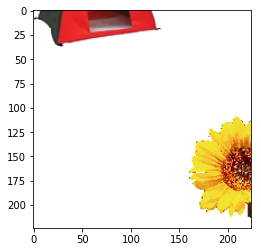

['Fixated area of the image and the classificatoin results']
0	 category: daisy; confidence:6.2190,	labelID: n11939491 985
1	 category: umbrella; confidence:5.3916,	labelID: n04507155 879
2	 category: birdhouse; confidence:5.2375,	labelID: n02843684 448
3	 category: pinwheel; confidence:5.0635,	labelID: n03944341 723
4	 category: mortarboard; confidence:4.9918,	labelID: n03787032 667
Priority map


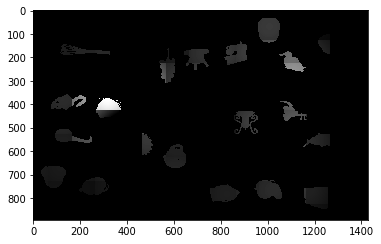

0.9884119242989335


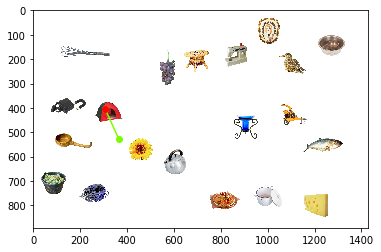

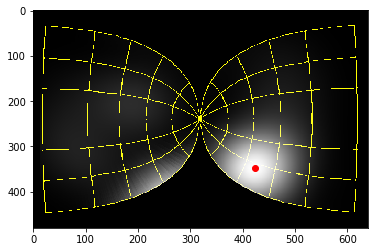

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


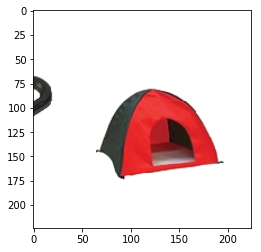

['Fixated area of the image and the classificatoin results']
0	 category: umbrella; confidence:9.6174,	labelID: n04507155 879
1	 category: parachute, chute; confidence:7.7550,	labelID: n03888257 701
2	 category: mountain tent; confidence:7.7521,	labelID: n03792972 672
3	 category: hook, claw; confidence:7.0707,	labelID: n03532672 600
4	 category: mortarboard; confidence:7.0167,	labelID: n03787032 667


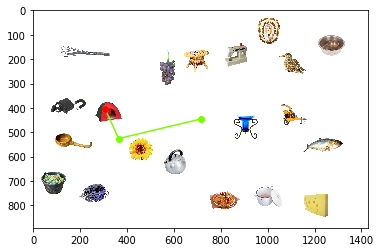

fan    545
object_array_displays_fixation_data/search_displays/present_044.png
Loading image


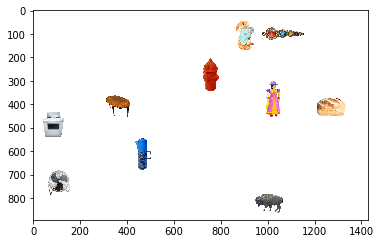

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


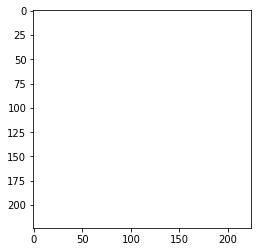

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


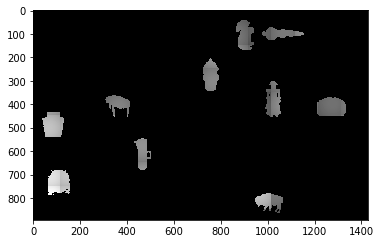

0.998231110503116


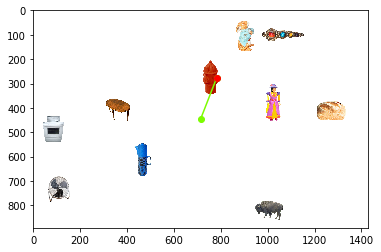

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


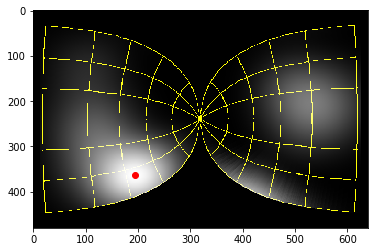

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


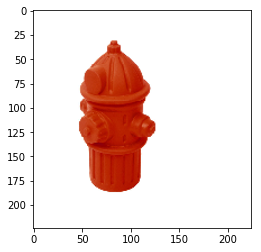

['Fixated area of the image and the classificatoin results']
0	 category: nipple; confidence:9.6933,	labelID: n03825788 680
1	 category: water bottle; confidence:8.5708,	labelID: n04557648 898
2	 category: pencil sharpener; confidence:8.3014,	labelID: n03908714 710
3	 category: saltshaker, salt shaker; confidence:7.6020,	labelID: n04131690 773
4	 category: whistle; confidence:7.2991,	labelID: n04579432 902
Priority map


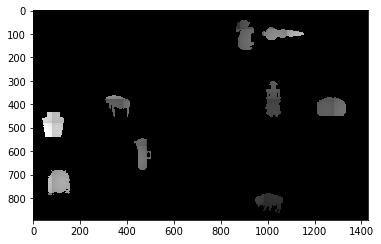

0.9975448180099379


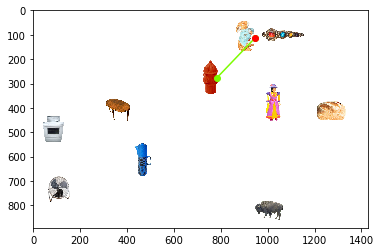

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


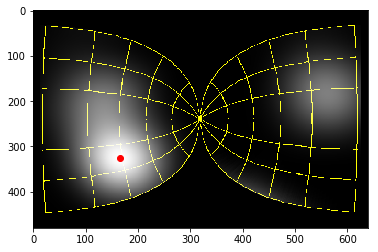

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


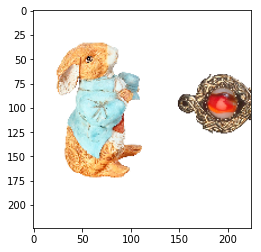

['Fixated area of the image and the classificatoin results']
0	 category: teddy, teddy bear; confidence:9.1672,	labelID: n04399382 850
1	 category: necklace; confidence:8.6527,	labelID: n03814906 679
2	 category: bib; confidence:7.4881,	labelID: n02834397 443
3	 category: hair slide; confidence:7.1737,	labelID: n03476684 584
4	 category: knot; confidence:6.8994,	labelID: n03627232 616
Priority map


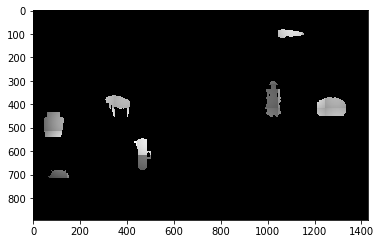

0.6837852200501916


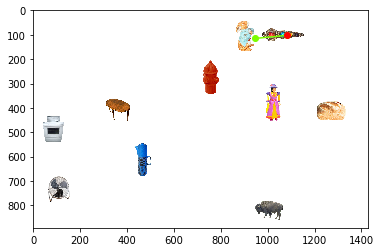

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


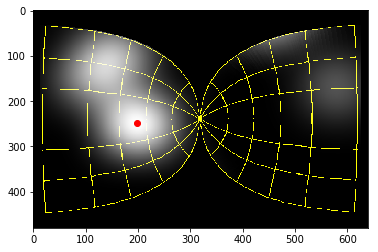

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


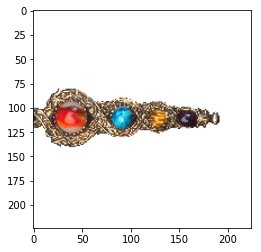

['Fixated area of the image and the classificatoin results']
0	 category: necklace; confidence:15.5514,	labelID: n03814906 679
1	 category: hair slide; confidence:14.6841,	labelID: n03476684 584
2	 category: chain; confidence:11.6609,	labelID: n02999410 488
3	 category: letter opener, paper knife, paperknife; confidence:10.5725,	labelID: n03658185 623
4	 category: bottlecap; confidence:10.0703,	labelID: n02877765 455
Priority map


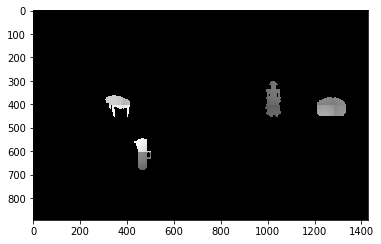

0.9737656717927258


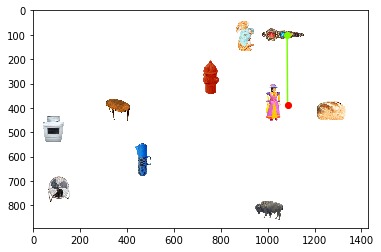

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


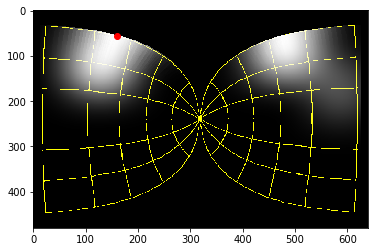

Eye_movement  5
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


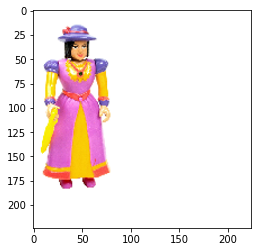

['Fixated area of the image and the classificatoin results']
0	 category: whistle; confidence:5.5117,	labelID: n04579432 902
1	 category: swing; confidence:5.4256,	labelID: n04371774 843
2	 category: tricycle, trike, velocipede; confidence:5.4030,	labelID: n04482393 870
3	 category: swimming trunks, bathing trunks; confidence:4.9253,	labelID: n04371430 842
4	 category: stretcher; confidence:4.8848,	labelID: n04336792 830
Priority map


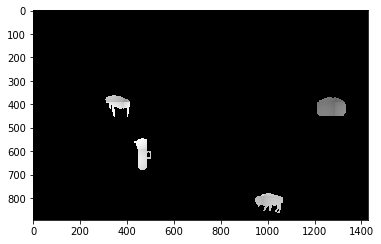

0.7326639962157555


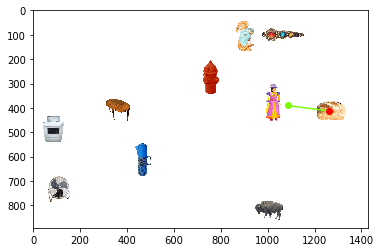

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


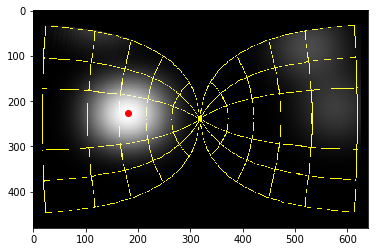

Eye_movement  6
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


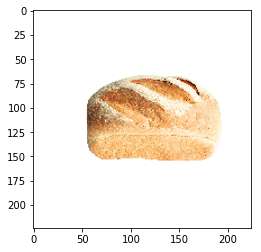

['Fixated area of the image and the classificatoin results']
0	 category: French loaf; confidence:14.7377,	labelID: n07684084 930
1	 category: toaster; confidence:10.8570,	labelID: n04442312 859
2	 category: face powder; confidence:9.1308,	labelID: n03314780 551
3	 category: rubber eraser, rubber, pencil eraser; confidence:8.8606,	labelID: n04116512 767
4	 category: clog, geta, patten, sabot; confidence:8.6625,	labelID: n03047690 502
Priority map


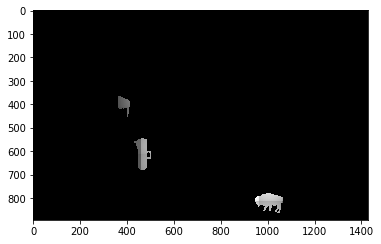

0.8482615783974714


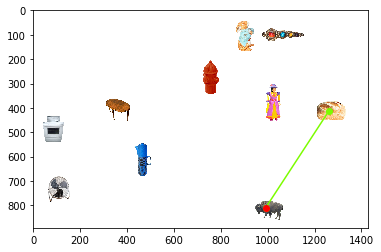

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


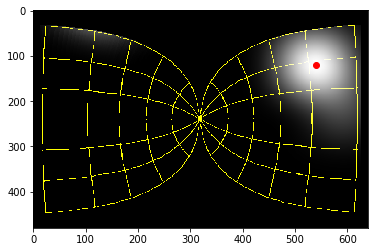

Eye_movement  7
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


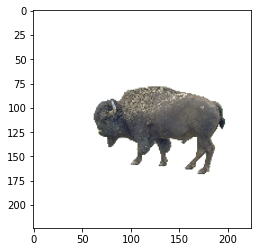

['Fixated area of the image and the classificatoin results']
0	 category: bison; confidence:12.1699,	labelID: n02410509 347
1	 category: wild boar, boar, Sus scrofa; confidence:9.5621,	labelID: n02396427 342
2	 category: ibex, Capra ibex; confidence:9.3634,	labelID: n02417914 350
3	 category: hog, pig, grunter, squealer, Sus scrofa; confidence:9.3229,	labelID: n02395406 341
4	 category: warthog; confidence:8.2421,	labelID: n02397096 343
Priority map


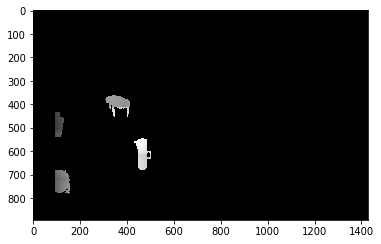

0.6995360221021378


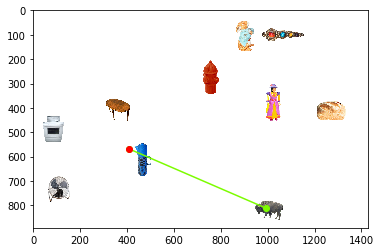

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


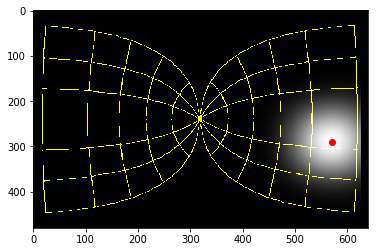

Eye_movement  8
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


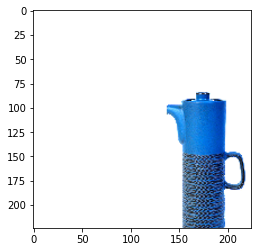

['Fixated area of the image and the classificatoin results']
0	 category: swab, swob, mop; confidence:10.1139,	labelID: n04367480 840
1	 category: lighter, light, igniter, ignitor; confidence:9.7596,	labelID: n03666591 626
2	 category: water bottle; confidence:9.4279,	labelID: n04557648 898
3	 category: pole; confidence:7.7885,	labelID: n03976657 733
4	 category: reel; confidence:7.6169,	labelID: n04067472 758
Priority map


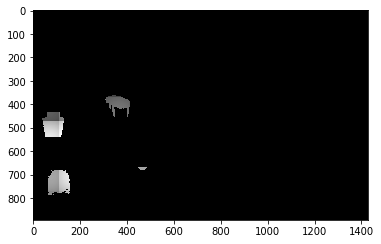

0.7711776743628308


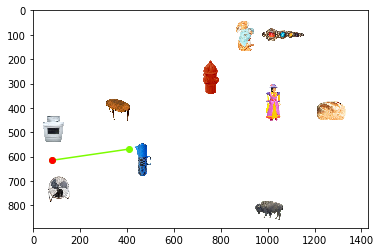

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


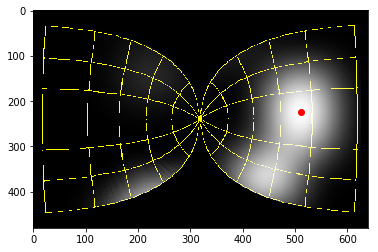

Eye_movement  9
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


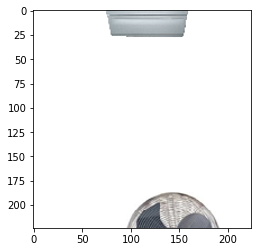

['Fixated area of the image and the classificatoin results']
0	 category: spotlight, spot; confidence:9.4636,	labelID: n04286575 818
1	 category: microphone, mike; confidence:9.3312,	labelID: n03759954 650
2	 category: electric fan, blower; confidence:7.8525,	labelID: n03271574 545
3	 category: hand blower, blow dryer, blow drier, hair dryer, hair drier; confidence:7.5041,	labelID: n03483316 589
4	 category: radio, wireless; confidence:7.4045,	labelID: n04041544 754


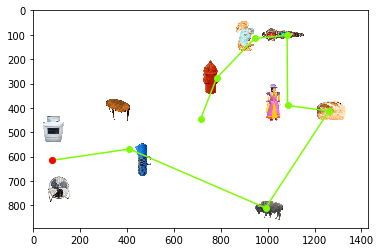

socks    806
object_array_displays_fixation_data/search_displays/present_045.png
Loading image


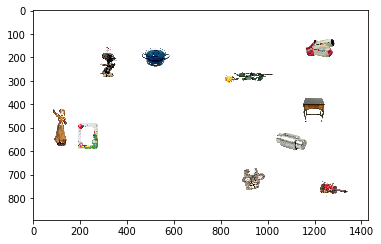

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


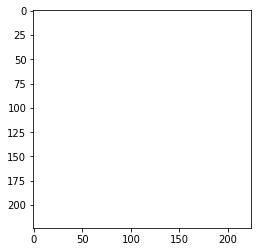

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


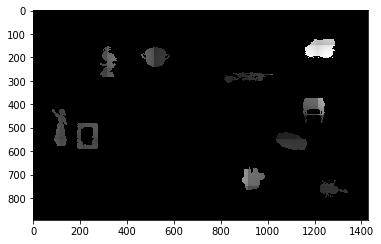

0.8659611327381489


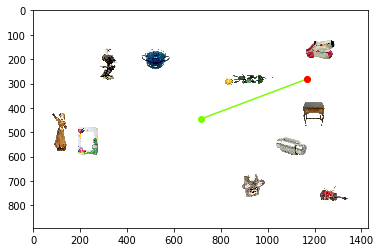

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


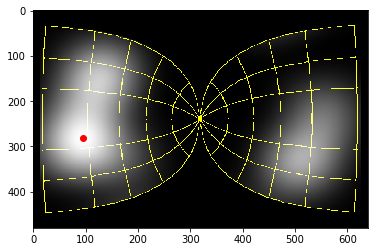

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


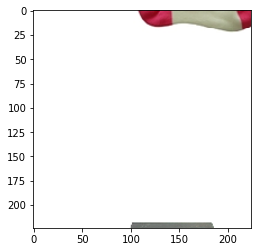

['Fixated area of the image and the classificatoin results']
0	 category: balance beam, beam; confidence:8.3344,	labelID: n02777292 416
1	 category: dumbbell; confidence:7.3544,	labelID: n03255030 543
2	 category: punching bag, punch bag, punching ball, punchball; confidence:6.7889,	labelID: n04023962 747
3	 category: power drill; confidence:6.3830,	labelID: n03995372 740
4	 category: matchstick; confidence:6.3412,	labelID: n03729826 644
Priority map


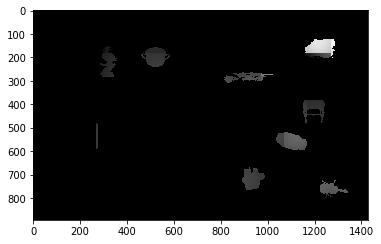

0.8759813754011694


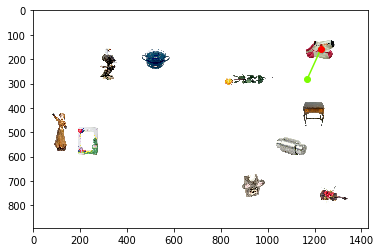

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


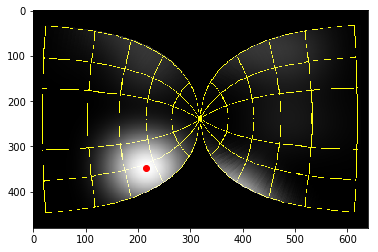

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


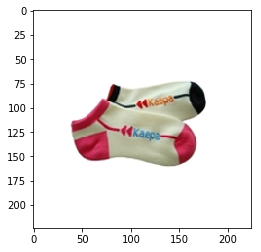

['Fixated area of the image and the classificatoin results']
0	 category: hair slide; confidence:8.2737,	labelID: n03476684 584
1	 category: screwdriver; confidence:7.9071,	labelID: n04154565 784
2	 category: whistle; confidence:7.6564,	labelID: n04579432 902
3	 category: maraca; confidence:7.1426,	labelID: n03720891 641
4	 category: can opener, tin opener; confidence:7.0353,	labelID: n02951585 473
Priority map


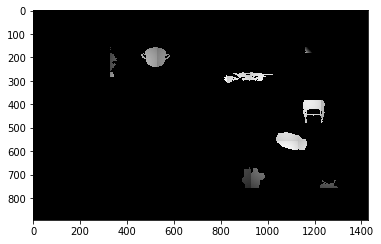

0.22904114030471945


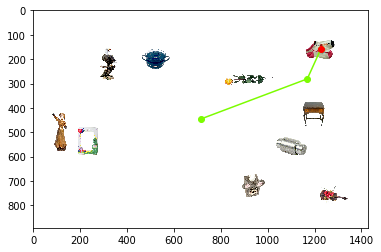

crib    520
object_array_displays_fixation_data/search_displays/present_046.png
Loading image


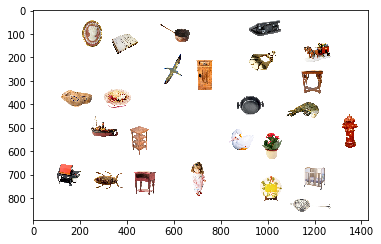

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


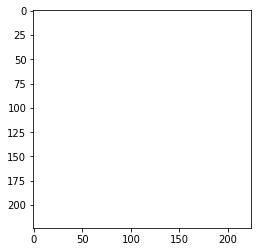

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


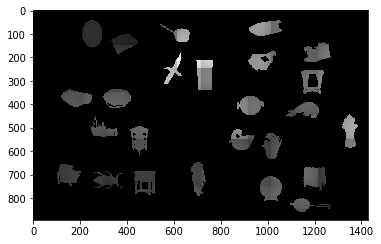

0.9731135812600099


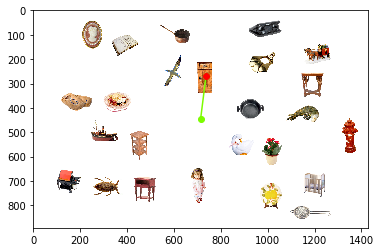

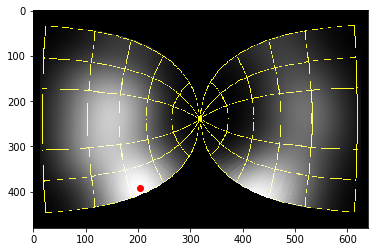

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


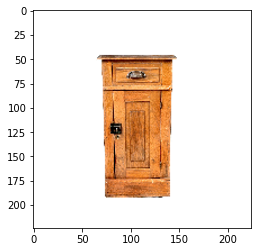

['Fixated area of the image and the classificatoin results']
0	 category: wardrobe, closet, press; confidence:11.0691,	labelID: n04550184 894
1	 category: file, file cabinet, filing cabinet; confidence:10.0452,	labelID: n03337140 553
2	 category: desk; confidence:9.2306,	labelID: n03179701 526
3	 category: chiffonier, commode; confidence:8.7949,	labelID: n03016953 493
4	 category: medicine chest, medicine cabinet; confidence:8.1743,	labelID: n03742115 648
Priority map


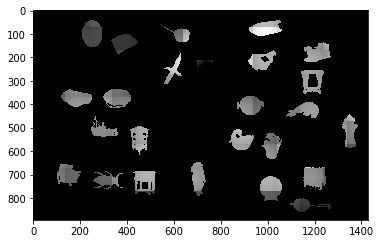

0.785045832042248


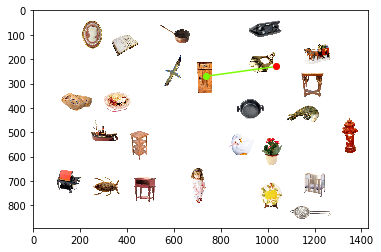

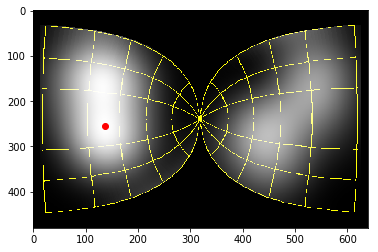

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


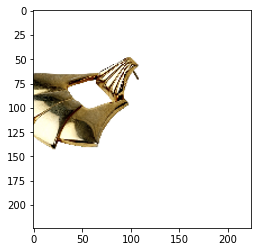

['Fixated area of the image and the classificatoin results']
0	 category: hair slide; confidence:9.4367,	labelID: n03476684 584
1	 category: sandal; confidence:8.8852,	labelID: n04133789 774
2	 category: scabbard; confidence:7.8584,	labelID: n04141327 777
3	 category: muzzle; confidence:7.6693,	labelID: n03803284 676
4	 category: buckle; confidence:7.6194,	labelID: n02910353 464
Priority map


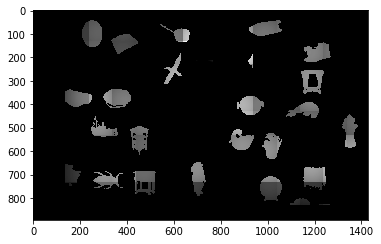

0.7817518825098807


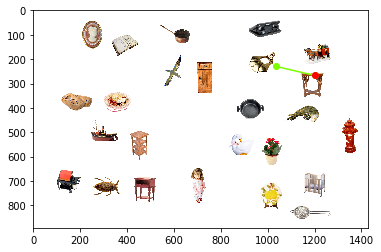

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


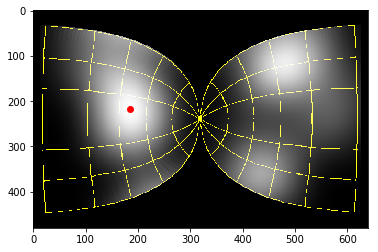

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


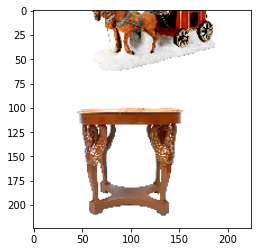

['Fixated area of the image and the classificatoin results']
0	 category: cradle; confidence:8.5171,	labelID: n03125729 516
1	 category: bloodhound, sleuthhound; confidence:8.0980,	labelID: n02088466 163
2	 category: dining table, board; confidence:7.8461,	labelID: n03201208 532
3	 category: throne; confidence:7.7880,	labelID: n04429376 857
4	 category: chiffonier, commode; confidence:7.2534,	labelID: n03016953 493
Priority map


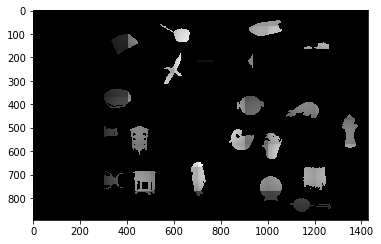

0.911290159232493


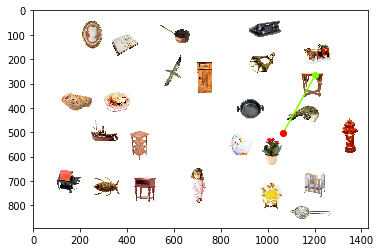

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


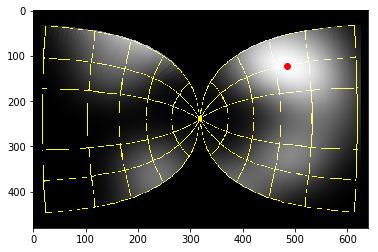

Eye_movement  5
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


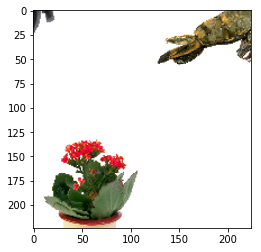

['Fixated area of the image and the classificatoin results']
0	 category: pot, flowerpot; confidence:7.5286,	labelID: n03991062 738
1	 category: hip, rose hip, rosehip; confidence:5.8939,	labelID: n12620546 989
2	 category: vase; confidence:5.7541,	labelID: n04522168 883
3	 category: bulbul; confidence:5.7483,	labelID: n01560419 16
4	 category: long-horned beetle, longicorn, longicorn beetle; confidence:5.1973,	labelID: n02168699 303
Priority map


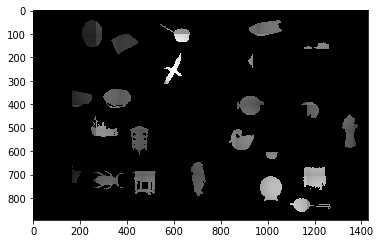

1.0


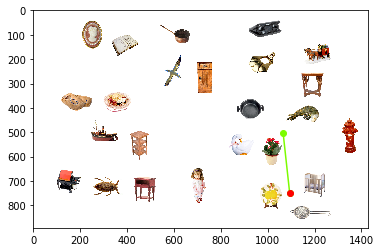

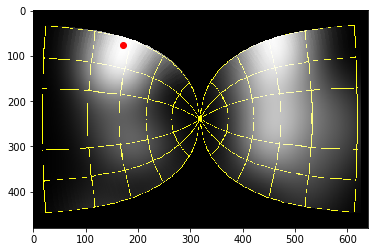

Eye_movement  6
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


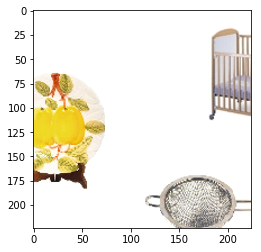

['Fixated area of the image and the classificatoin results']
0	 category: crib, cot; confidence:9.9480,	labelID: n03131574 520
1	 category: plate rack; confidence:9.8473,	labelID: n03961711 729
2	 category: cradle; confidence:9.1863,	labelID: n03125729 516
3	 category: bassinet; confidence:7.8206,	labelID: n02804414 431
4	 category: electric fan, blower; confidence:7.6686,	labelID: n03271574 545


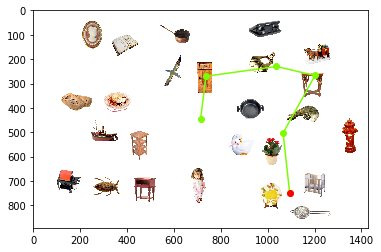

socks    806
object_array_displays_fixation_data/search_displays/present_053.png
Loading image


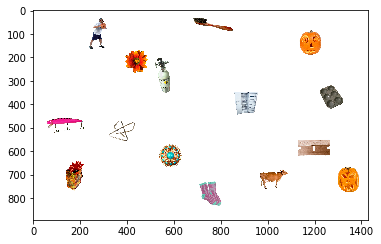

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


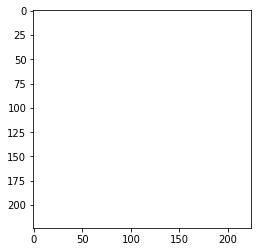

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


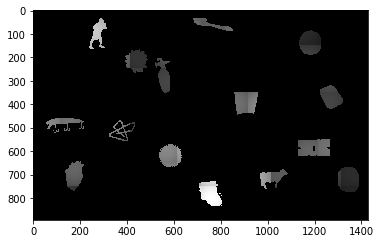

0.7547165311181825


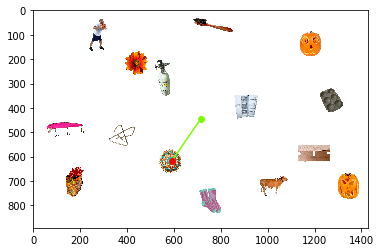

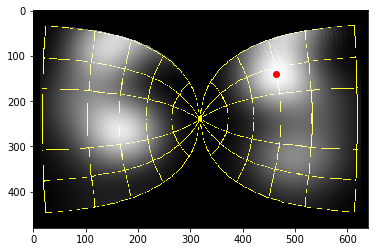

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


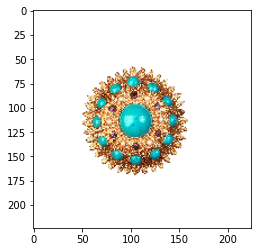

['Fixated area of the image and the classificatoin results']
0	 category: hair slide; confidence:13.2407,	labelID: n03476684 584
1	 category: necklace; confidence:10.6704,	labelID: n03814906 679
2	 category: bolo tie, bolo, bola tie, bola; confidence:8.6687,	labelID: n02865351 451
3	 category: bottlecap; confidence:8.3663,	labelID: n02877765 455
4	 category: buckle; confidence:7.5359,	labelID: n02910353 464
Priority map


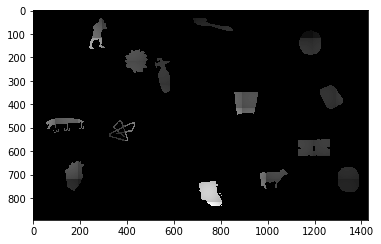

0.9050930044779488


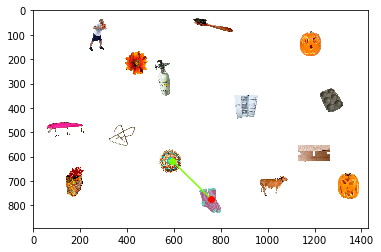

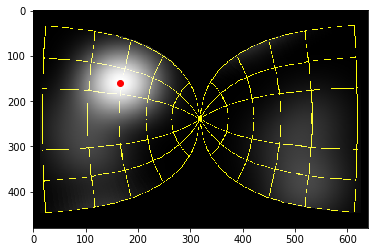

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


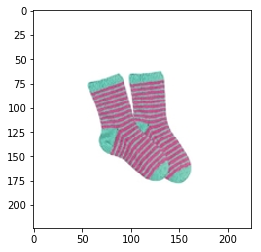

['Fixated area of the image and the classificatoin results']
0	 category: Christmas stocking; confidence:8.3983,	labelID: n03026506 496
1	 category: sock; confidence:8.1067,	labelID: n04254777 806
2	 category: diaper, nappy, napkin; confidence:7.8821,	labelID: n03188531 529
3	 category: mitten; confidence:7.0500,	labelID: n03775071 658
4	 category: hair slide; confidence:6.4753,	labelID: n03476684 584


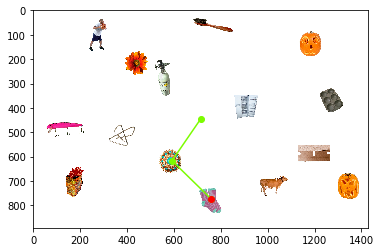

tent    672
object_array_displays_fixation_data/search_displays/present_060.png
Loading image


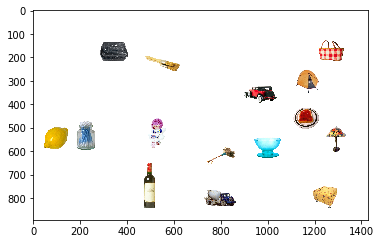

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


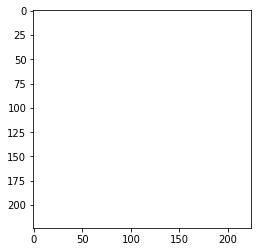

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


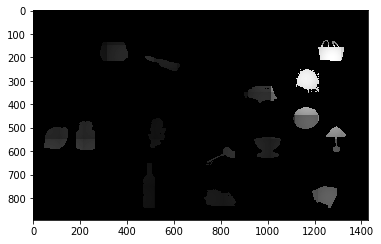

0.9644153211277942


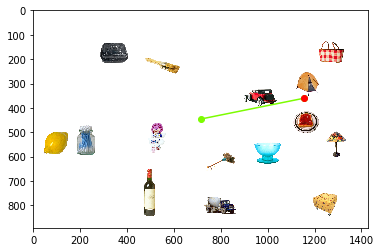

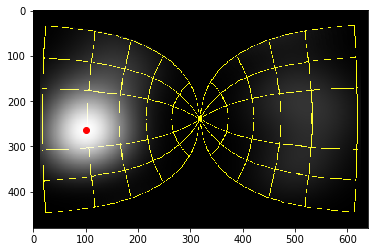

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


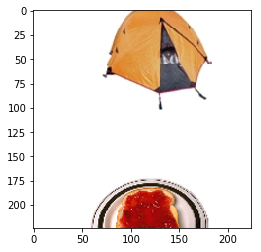

['Fixated area of the image and the classificatoin results']
0	 category: mountain tent; confidence:8.6995,	labelID: n03792972 672
1	 category: wall clock; confidence:7.8046,	labelID: n04548280 892
2	 category: cradle; confidence:7.4941,	labelID: n03125729 516
3	 category: umbrella; confidence:7.3566,	labelID: n04507155 879
4	 category: hamper; confidence:7.1965,	labelID: n03482405 588


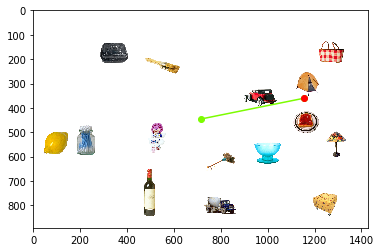

fan    545
object_array_displays_fixation_data/search_displays/present_062.png
Loading image


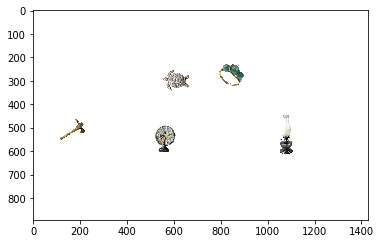

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


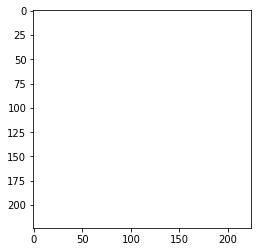

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


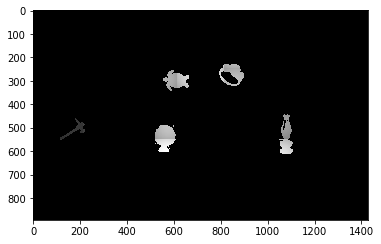

0.9933492408451209


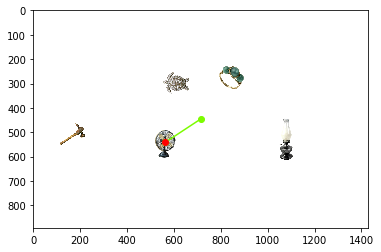

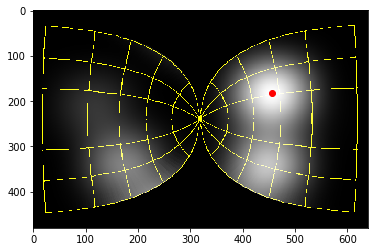

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


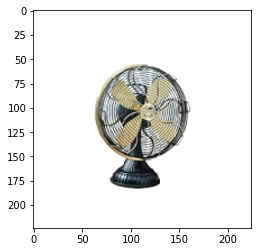

['Fixated area of the image and the classificatoin results']
0	 category: electric fan, blower; confidence:13.2802,	labelID: n03271574 545
1	 category: spotlight, spot; confidence:11.5977,	labelID: n04286575 818
2	 category: space heater; confidence:8.0517,	labelID: n04265275 811
3	 category: tennis ball; confidence:7.6151,	labelID: n04409515 852
4	 category: strainer; confidence:7.5878,	labelID: n04332243 828


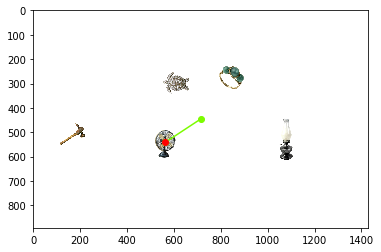

clock    409
object_array_displays_fixation_data/search_displays/present_066.png
Loading image


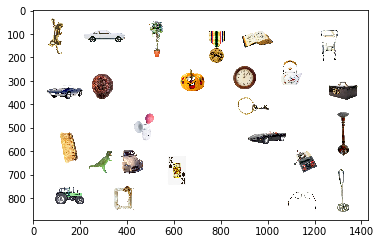

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


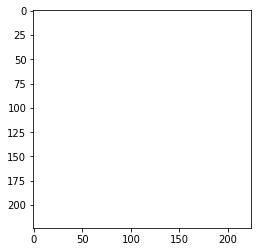

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


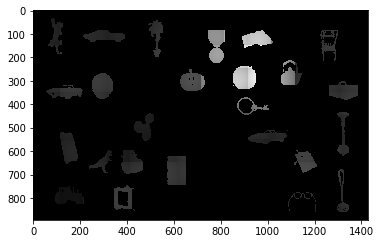

0.9335737763645812


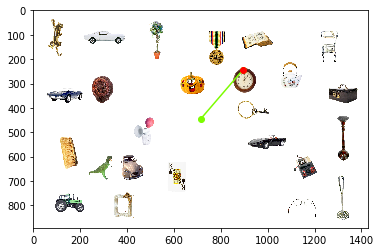

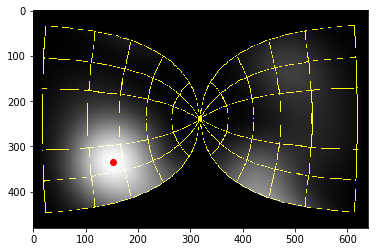

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


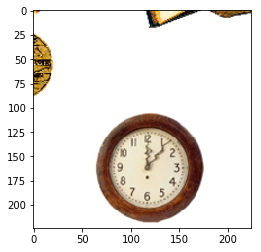

['Fixated area of the image and the classificatoin results']
0	 category: analog clock; confidence:10.6862,	labelID: n02708093 409
1	 category: wall clock; confidence:10.2368,	labelID: n04548280 892
2	 category: barometer; confidence:8.8343,	labelID: n02794156 426
3	 category: magnetic compass; confidence:8.6314,	labelID: n03706229 635
4	 category: stopwatch, stop watch; confidence:7.7376,	labelID: n04328186 826


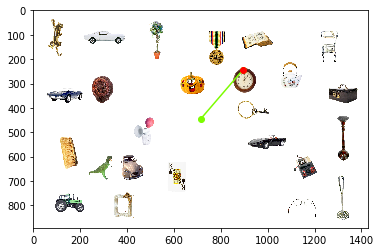

garbage_can    412
object_array_displays_fixation_data/search_displays/present_070.png
Loading image


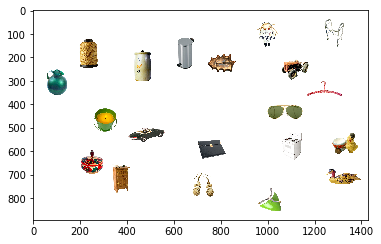

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


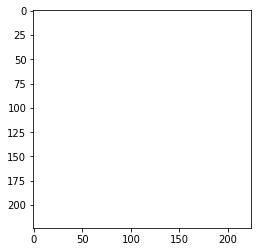

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


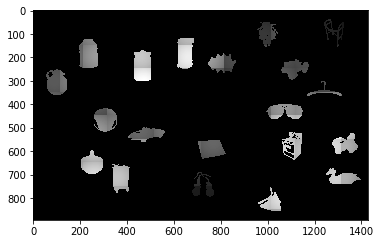

0.9475081687583657


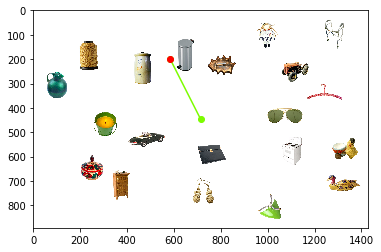

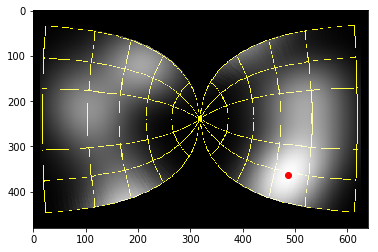

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


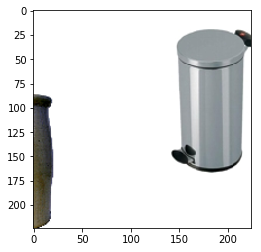

['Fixated area of the image and the classificatoin results']
0	 category: binoculars, field glasses, opera glasses; confidence:8.0254,	labelID: n02841315 447
1	 category: measuring cup; confidence:7.9431,	labelID: n03733805 647
2	 category: coffeepot; confidence:7.8269,	labelID: n03063689 505
3	 category: pencil sharpener; confidence:7.8040,	labelID: n03908714 710
4	 category: soap dispenser; confidence:7.6676,	labelID: n04254120 804
Priority map


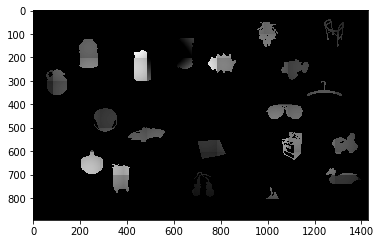

0.899266202915658


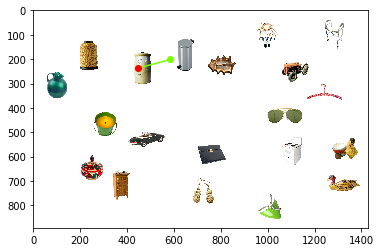

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


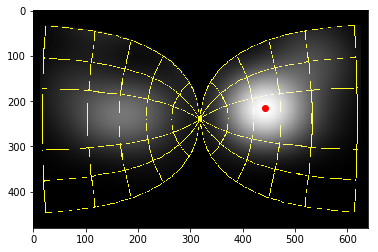

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


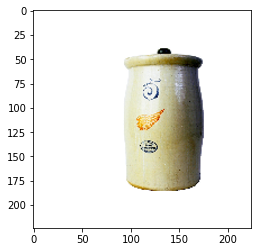

['Fixated area of the image and the classificatoin results']
0	 category: milk can; confidence:7.3867,	labelID: n03764736 653
1	 category: saltshaker, salt shaker; confidence:7.0295,	labelID: n04131690 773
2	 category: water jug; confidence:6.7792,	labelID: n04560804 899
3	 category: bucket, pail; confidence:6.7711,	labelID: n02909870 463
4	 category: pitcher, ewer; confidence:6.5776,	labelID: n03950228 725
Priority map


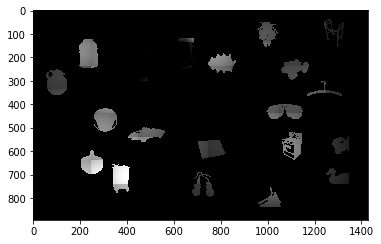

0.870889042193421


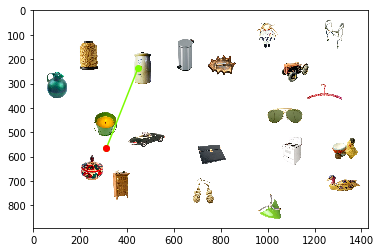

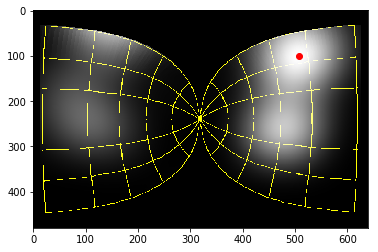

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


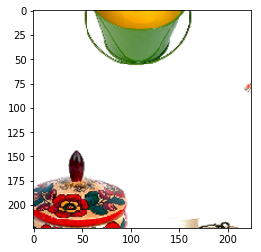

['Fixated area of the image and the classificatoin results']
0	 category: candle, taper, wax light; confidence:8.7490,	labelID: n02948072 470
1	 category: eggnog; confidence:7.4522,	labelID: n07932039 969
2	 category: table lamp; confidence:6.9599,	labelID: n04380533 846
3	 category: tennis ball; confidence:6.4623,	labelID: n04409515 852
4	 category: red wine; confidence:6.4219,	labelID: n07892512 966
Priority map


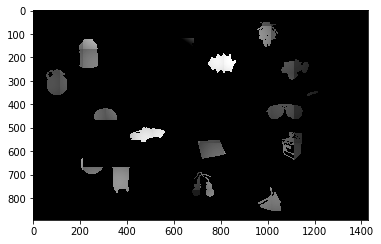

0.7712803271456977


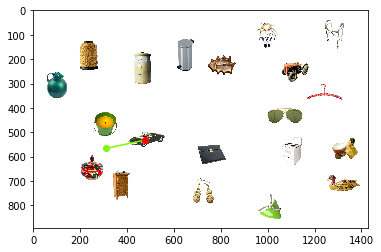

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


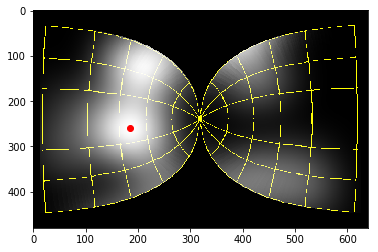

Eye_movement  5
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


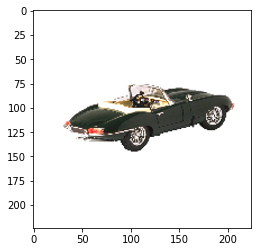

['Fixated area of the image and the classificatoin results']
0	 category: half track; confidence:10.1939,	labelID: n03478589 586
1	 category: warplane, military plane; confidence:10.0859,	labelID: n04552348 895
2	 category: tow truck, tow car, wrecker; confidence:9.7285,	labelID: n04461696 864
3	 category: amphibian, amphibious vehicle; confidence:9.0757,	labelID: n02704792 408
4	 category: tank, army tank, armored combat vehicle, armoured combat vehicle; confidence:8.6983,	labelID: n04389033 847
Priority map


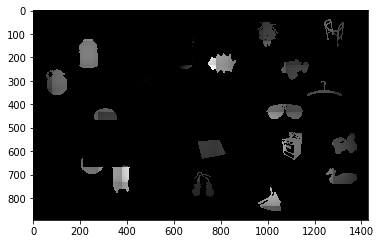

0.8518001907514917


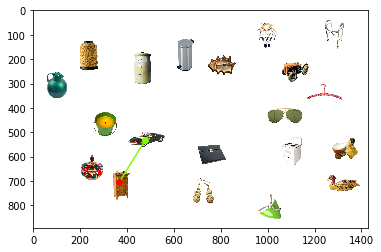

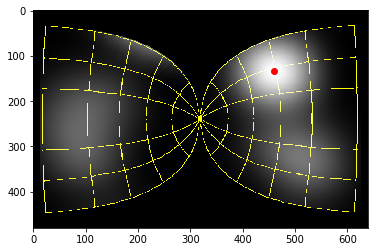

Eye_movement  6
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


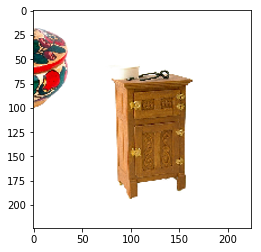

['Fixated area of the image and the classificatoin results']
0	 category: chest; confidence:8.5973,	labelID: n03014705 492
1	 category: hamper; confidence:7.9043,	labelID: n03482405 588
2	 category: desk; confidence:7.1462,	labelID: n03179701 526
3	 category: chiffonier, commode; confidence:6.8488,	labelID: n03016953 493
4	 category: crate; confidence:6.6584,	labelID: n03127925 519
Priority map


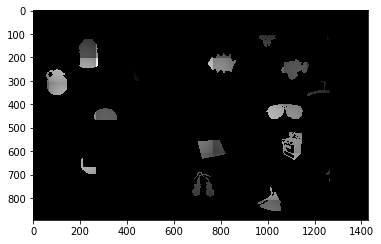

0.6434637859615518


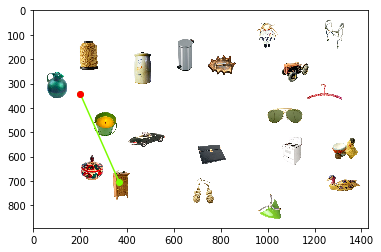

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


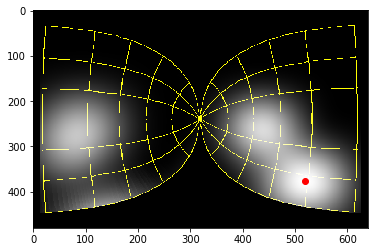

Eye_movement  7
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


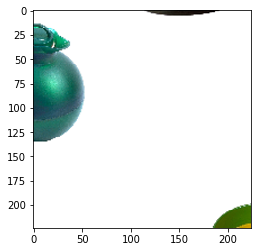

['Fixated area of the image and the classificatoin results']
0	 category: necklace; confidence:6.3482,	labelID: n03814906 679
1	 category: joystick; confidence:5.9211,	labelID: n03602883 613
2	 category: Granny Smith; confidence:5.5669,	labelID: n07742313 948
3	 category: tennis ball; confidence:5.3465,	labelID: n04409515 852
4	 category: mouse, computer mouse; confidence:5.2539,	labelID: n03793489 673
Priority map


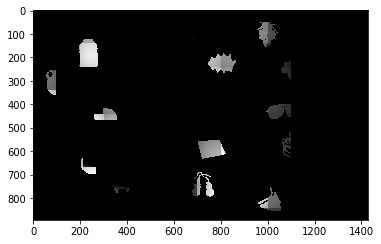

0.6174718628364368


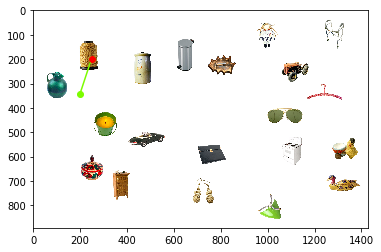

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


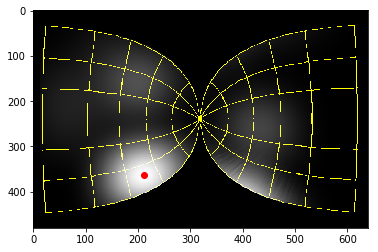

Eye_movement  8
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


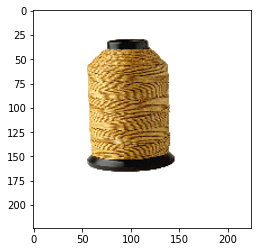

['Fixated area of the image and the classificatoin results']
0	 category: pill bottle; confidence:8.8517,	labelID: n03937543 720
1	 category: hamper; confidence:8.5134,	labelID: n03482405 588
2	 category: thimble; confidence:8.4296,	labelID: n04423845 855
3	 category: lighter, light, igniter, ignitor; confidence:8.2101,	labelID: n03666591 626
4	 category: saltshaker, salt shaker; confidence:7.8995,	labelID: n04131690 773
Priority map


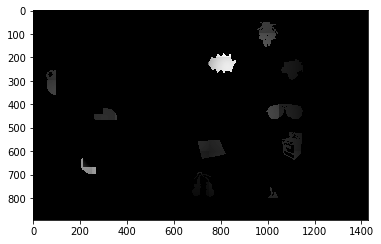

0.8859647160465511


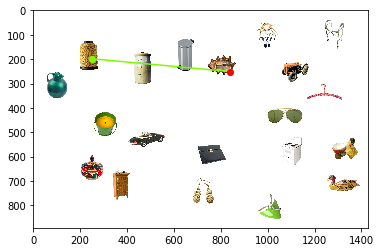

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


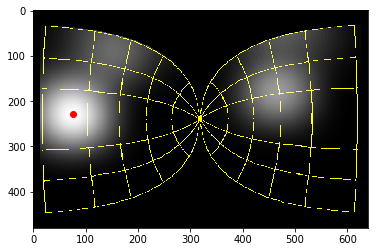

Eye_movement  9
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


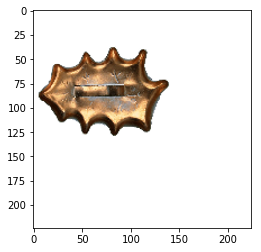

['Fixated area of the image and the classificatoin results']
0	 category: pencil sharpener; confidence:13.6479,	labelID: n03908714 710
1	 category: bottlecap; confidence:13.2310,	labelID: n02877765 455
2	 category: wall clock; confidence:12.9152,	labelID: n04548280 892
3	 category: conch; confidence:11.4612,	labelID: n01943899 112
4	 category: flatworm, platyhelminth; confidence:11.3361,	labelID: n01924916 110
Priority map


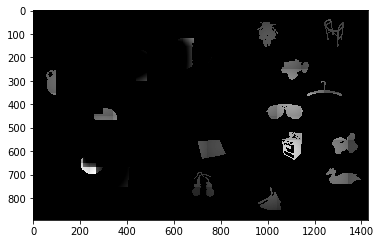

0.8661335088682313


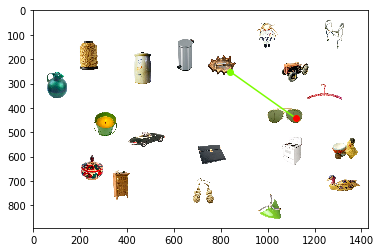

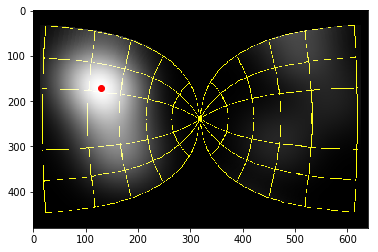

Eye_movement  10
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


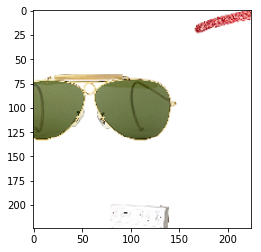

['Fixated area of the image and the classificatoin results']
0	 category: sunglass; confidence:10.4801,	labelID: n04355933 836
1	 category: sunglasses, dark glasses, shades; confidence:10.1943,	labelID: n04356056 837
2	 category: tennis ball; confidence:9.9376,	labelID: n04409515 852
3	 category: whistle; confidence:8.4024,	labelID: n04579432 902
4	 category: bib; confidence:7.3735,	labelID: n02834397 443
Priority map


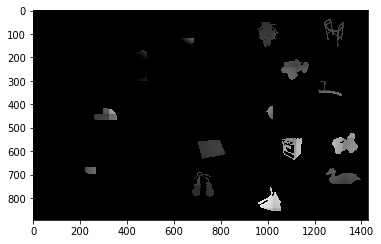

0.7237547822644135


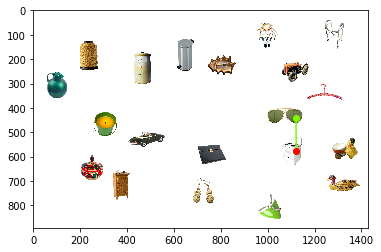

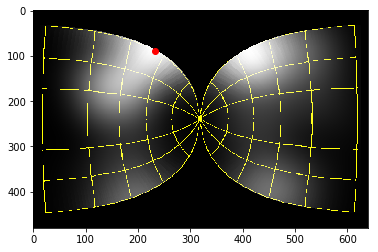

Eye_movement  11
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


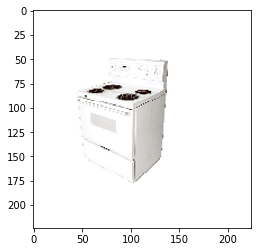

['Fixated area of the image and the classificatoin results']
0	 category: photocopier; confidence:12.4530,	labelID: n03924679 713
1	 category: printer; confidence:11.8160,	labelID: n04004767 742
2	 category: switch, electric switch, electrical switch; confidence:10.2001,	labelID: n04372370 844
3	 category: file, file cabinet, filing cabinet; confidence:9.0440,	labelID: n03337140 553
4	 category: toaster; confidence:8.7740,	labelID: n04442312 859
Priority map


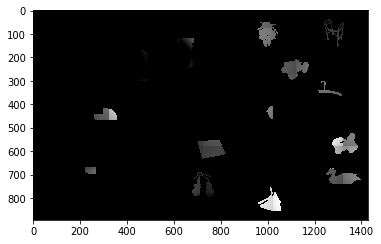

0.7768072733192819


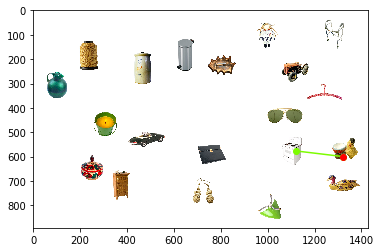

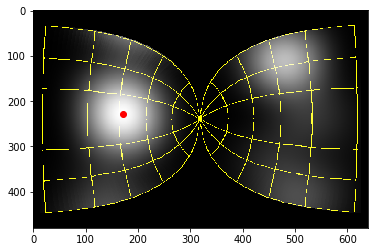

Eye_movement  12
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


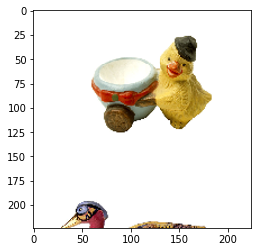

['Fixated area of the image and the classificatoin results']
0	 category: teddy, teddy bear; confidence:5.5521,	labelID: n04399382 850
1	 category: hamper; confidence:5.4945,	labelID: n03482405 588
2	 category: croquet ball; confidence:5.3351,	labelID: n03134739 522
3	 category: maraca; confidence:4.8530,	labelID: n03720891 641
4	 category: fig; confidence:4.4117,	labelID: n07753113 952
Priority map


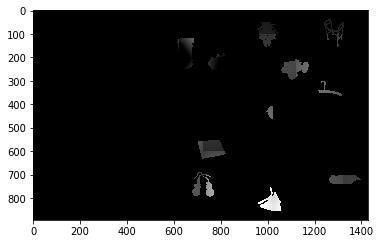

0.7620280406868026


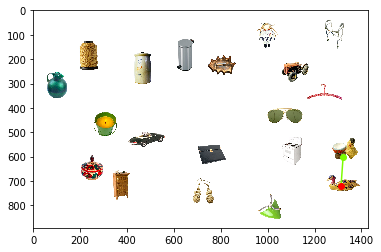

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


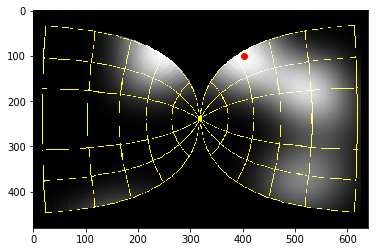

Eye_movement  13
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


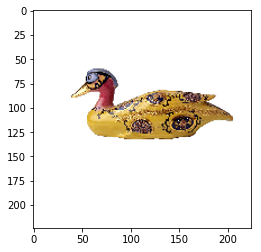

['Fixated area of the image and the classificatoin results']
0	 category: banana; confidence:6.6568,	labelID: n07753592 954
1	 category: tailed frog, bell toad, ribbed toad, tailed toad, Ascaphus trui; confidence:6.3903,	labelID: n01644900 32
2	 category: vine snake; confidence:5.9245,	labelID: n01739381 59
3	 category: tree frog, tree-frog; confidence:5.8348,	labelID: n01644373 31
4	 category: European fire salamander, Salamandra salamandra; confidence:5.0478,	labelID: n01629819 25
Priority map


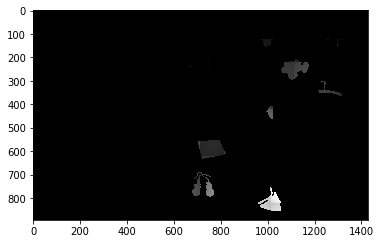

0.967593139801879


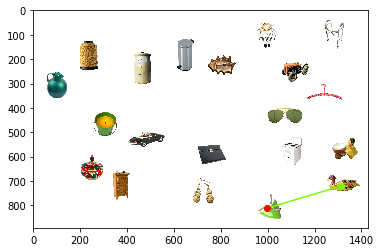

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


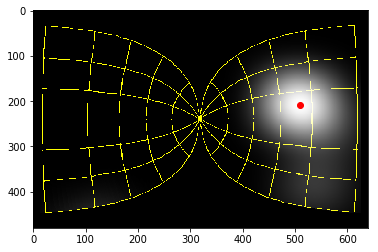

Eye_movement  14
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


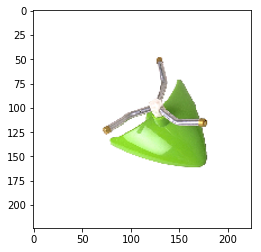

['Fixated area of the image and the classificatoin results']
0	 category: sandal; confidence:7.0972,	labelID: n04133789 774
1	 category: hair slide; confidence:7.0288,	labelID: n03476684 584
2	 category: shovel; confidence:6.2405,	labelID: n04208210 792
3	 category: necklace; confidence:6.2295,	labelID: n03814906 679
4	 category: purse; confidence:6.1833,	labelID: n04026417 748
Priority map


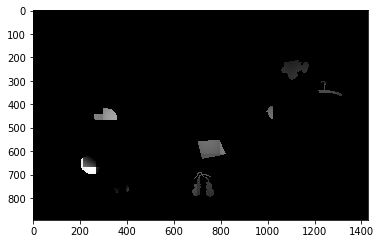

0.7319859899138044


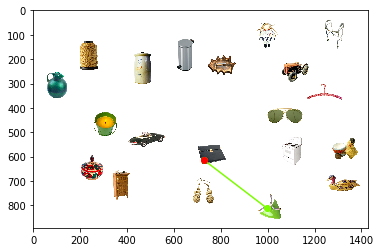

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


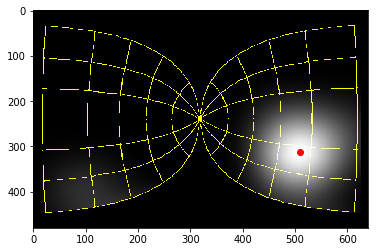

Eye_movement  15
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


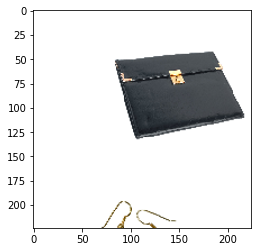

['Fixated area of the image and the classificatoin results']
0	 category: mortarboard; confidence:7.9833,	labelID: n03787032 667
1	 category: wallet, billfold, notecase, pocketbook; confidence:7.4007,	labelID: n04548362 893
2	 category: binder, ring-binder; confidence:6.9415,	labelID: n02840245 446
3	 category: purse; confidence:6.6118,	labelID: n04026417 748
4	 category: envelope; confidence:6.5659,	labelID: n03291819 549
Priority map


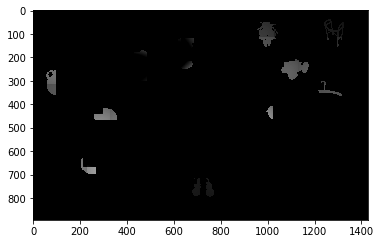

0.8998521499261642


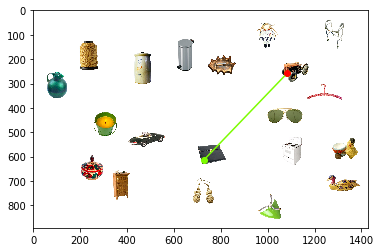

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


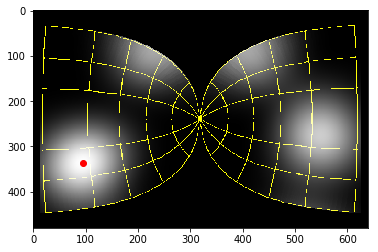

Eye_movement  16
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


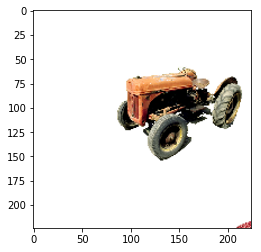

['Fixated area of the image and the classificatoin results']
0	 category: half track; confidence:10.0607,	labelID: n03478589 586
1	 category: lawn mower, mower; confidence:9.5952,	labelID: n03649909 621
2	 category: tractor; confidence:9.5475,	labelID: n04465501 866
3	 category: tow truck, tow car, wrecker; confidence:8.8217,	labelID: n04461696 864
4	 category: plow, plough; confidence:7.7593,	labelID: n03967562 730
Priority map


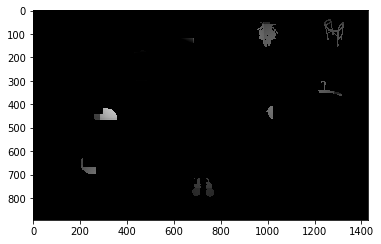

0.6619371651017479


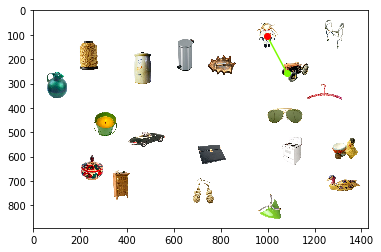

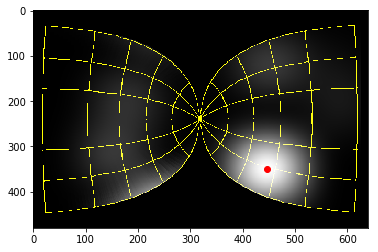

Eye_movement  17
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


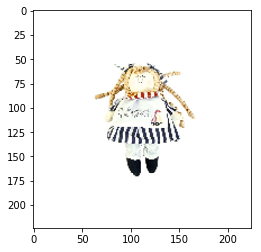

['Fixated area of the image and the classificatoin results']
0	 category: screw; confidence:5.2124,	labelID: n04153751 783
1	 category: nail; confidence:5.1341,	labelID: n03804744 677
2	 category: jersey, T-shirt, tee shirt; confidence:4.6421,	labelID: n03595614 610
3	 category: wall clock; confidence:4.4059,	labelID: n04548280 892
4	 category: necklace; confidence:4.2322,	labelID: n03814906 679
Priority map


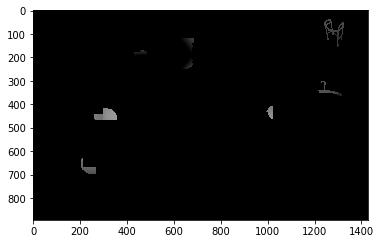

0.7609644309391694


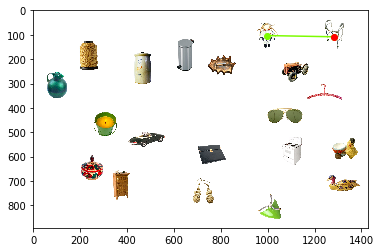

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


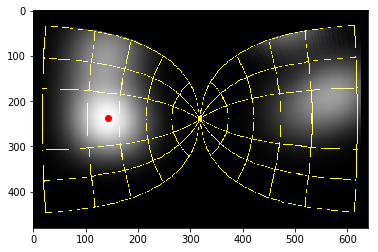

Eye_movement  18
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


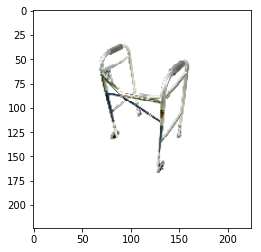

['Fixated area of the image and the classificatoin results']
0	 category: folding chair; confidence:11.6275,	labelID: n03376595 559
1	 category: cradle; confidence:8.5573,	labelID: n03125729 516
2	 category: stretcher; confidence:8.0450,	labelID: n04336792 830
3	 category: bassinet; confidence:7.7888,	labelID: n02804414 431
4	 category: plate rack; confidence:7.5928,	labelID: n03961711 729
Priority map


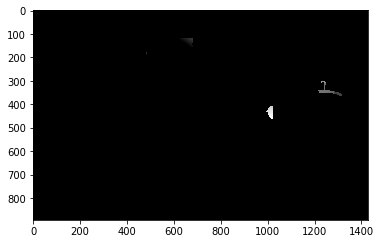

0.4838346840444932


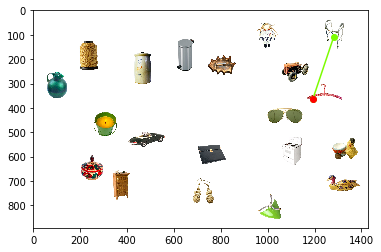

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


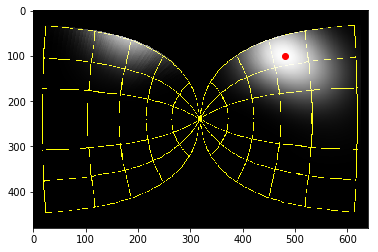

Eye_movement  19
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


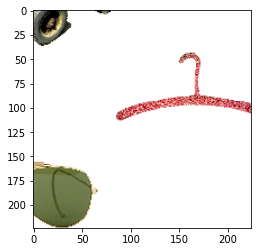

['Fixated area of the image and the classificatoin results']
0	 category: hook, claw; confidence:8.5798,	labelID: n03532672 600
1	 category: necklace; confidence:6.9734,	labelID: n03814906 679
2	 category: whistle; confidence:6.7894,	labelID: n04579432 902
3	 category: parachute, chute; confidence:6.7890,	labelID: n03888257 701
4	 category: chime, bell, gong; confidence:6.6132,	labelID: n03017168 494
Priority map


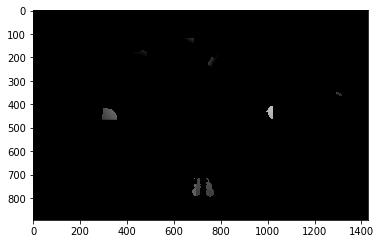

0.5440077647435773


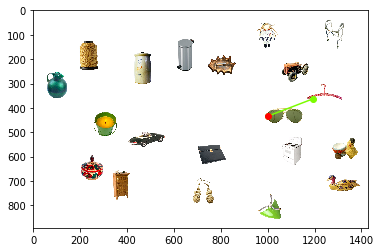

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


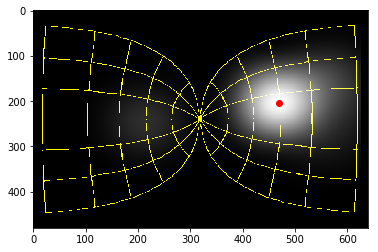

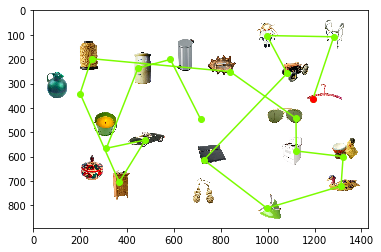

garbage_can    412
object_array_displays_fixation_data/search_displays/present_071.png
Loading image


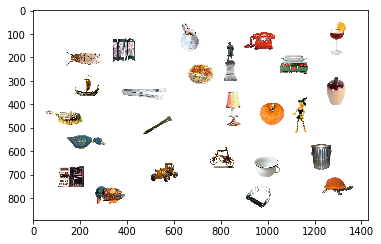

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


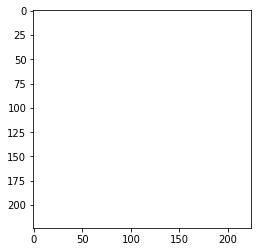

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


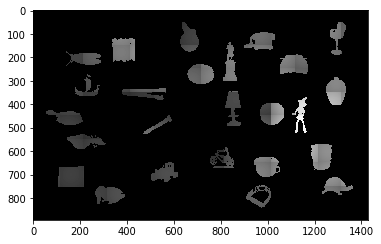

0.9997116718445702


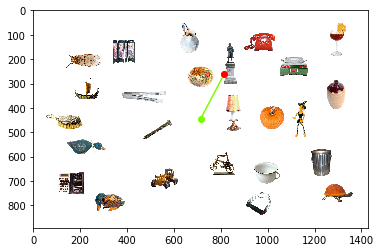

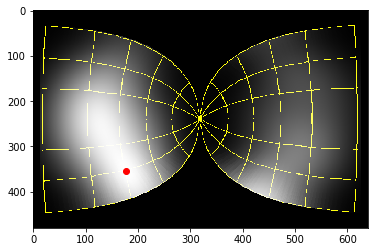

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


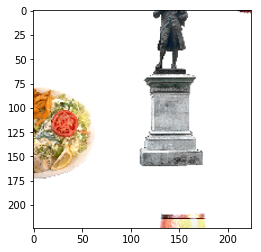

['Fixated area of the image and the classificatoin results']
0	 category: altar; confidence:6.1417,	labelID: n02699494 406
1	 category: table lamp; confidence:6.1302,	labelID: n04380533 846
2	 category: stupa, tope; confidence:5.8269,	labelID: n04346328 832
3	 category: pedestal, plinth, footstall; confidence:5.6562,	labelID: n03903868 708
4	 category: scale, weighing machine; confidence:5.4713,	labelID: n04141975 778
Priority map


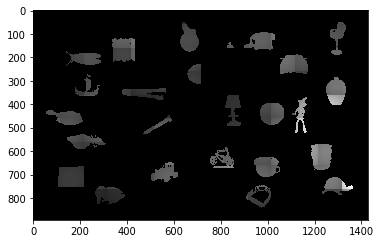

0.8323132368759211


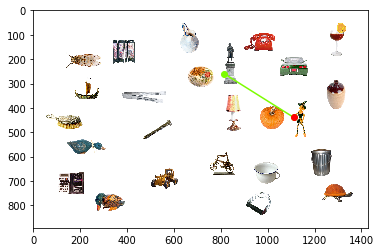

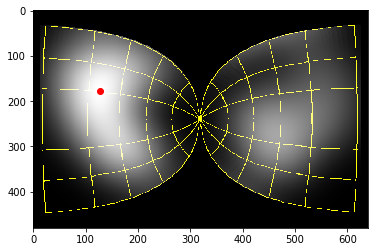

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


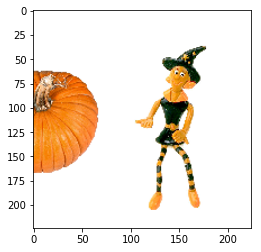

['Fixated area of the image and the classificatoin results']
0	 category: orange; confidence:5.2858,	labelID: n07747607 950
1	 category: necklace; confidence:5.2011,	labelID: n03814906 679
2	 category: maraca; confidence:4.7659,	labelID: n03720891 641
3	 category: bee; confidence:4.5931,	labelID: n02206856 309
4	 category: hair slide; confidence:4.5886,	labelID: n03476684 584
Priority map


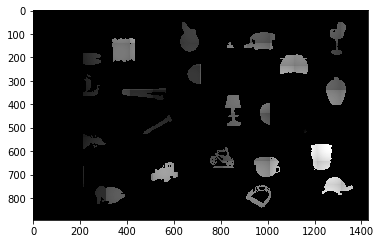

1.0


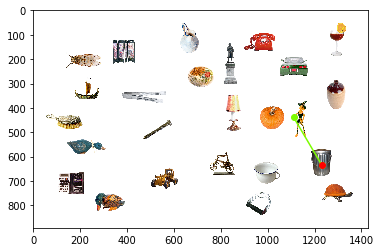

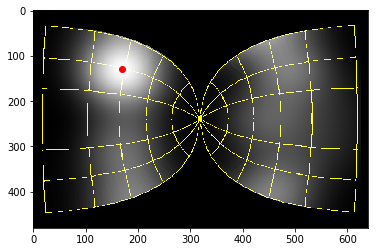

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


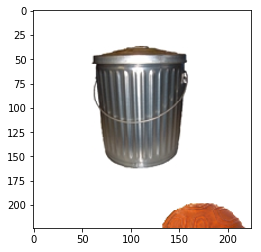

['Fixated area of the image and the classificatoin results']
0	 category: bucket, pail; confidence:9.4008,	labelID: n02909870 463
1	 category: hamper; confidence:8.6073,	labelID: n03482405 588
2	 category: ashcan, trash can, garbage can, wastebin, ash bin, ash-bin, ashbin, dustbin, trash barrel, trash bin; confidence:8.0976,	labelID: n02747177 412
3	 category: barrel, cask; confidence:7.7392,	labelID: n02795169 427
4	 category: strainer; confidence:7.4666,	labelID: n04332243 828


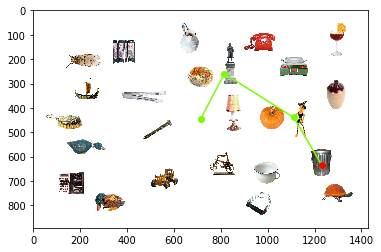

fan    545
object_array_displays_fixation_data/search_displays/present_072.png
Loading image


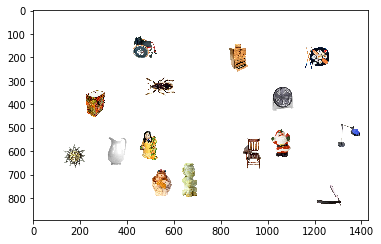

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


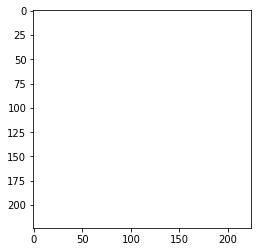

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


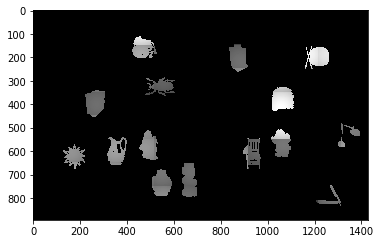

0.8580565309998737


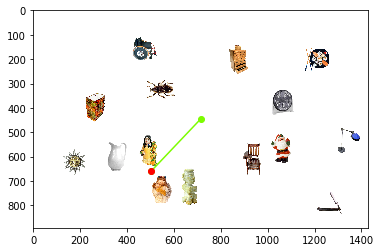

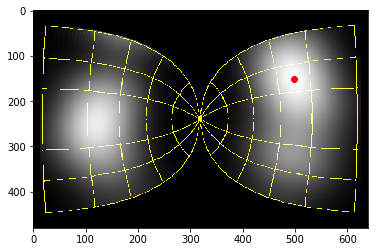

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


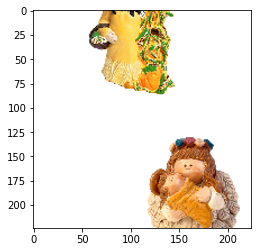

['Fixated area of the image and the classificatoin results']
0	 category: teddy, teddy bear; confidence:6.7413,	labelID: n04399382 850
1	 category: hamper; confidence:6.7127,	labelID: n03482405 588
2	 category: hoopskirt, crinoline; confidence:6.5699,	labelID: n03534580 601
3	 category: necklace; confidence:6.4800,	labelID: n03814906 679
4	 category: swing; confidence:6.1807,	labelID: n04371774 843
Priority map


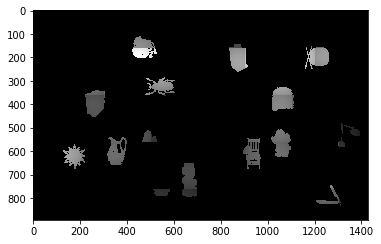

0.9965031897850684


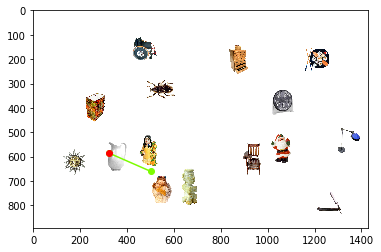

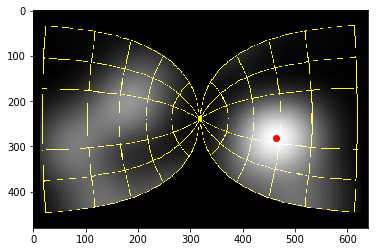

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


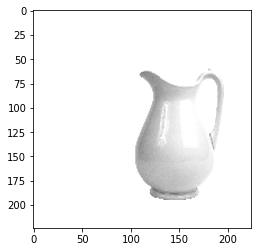

['Fixated area of the image and the classificatoin results']
0	 category: pitcher, ewer; confidence:11.0691,	labelID: n03950228 725
1	 category: water jug; confidence:9.5453,	labelID: n04560804 899
2	 category: vase; confidence:9.4801,	labelID: n04522168 883
3	 category: nipple; confidence:8.9951,	labelID: n03825788 680
4	 category: whiskey jug; confidence:8.5325,	labelID: n04579145 901
Priority map


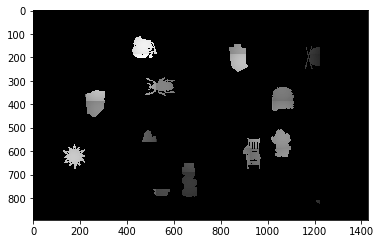

0.9442168975936023


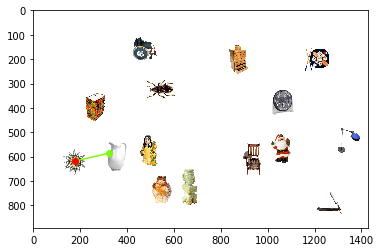

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


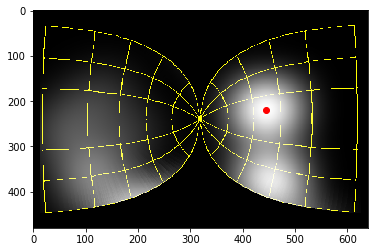

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


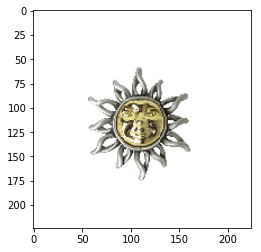

['Fixated area of the image and the classificatoin results']
0	 category: shield, buckler; confidence:10.8222,	labelID: n04192698 787
1	 category: wall clock; confidence:10.6256,	labelID: n04548280 892
2	 category: analog clock; confidence:9.1145,	labelID: n02708093 409
3	 category: bell cote, bell cot; confidence:7.5575,	labelID: n02825657 442
4	 category: stopwatch, stop watch; confidence:7.3478,	labelID: n04328186 826
Priority map


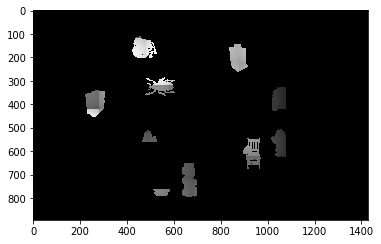

0.7011638292086745


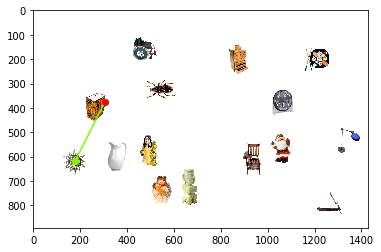

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


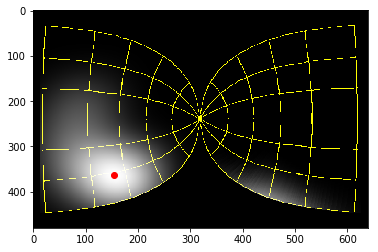

Eye_movement  5
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


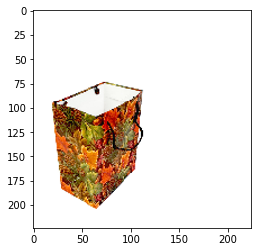

['Fixated area of the image and the classificatoin results']
0	 category: mousetrap; confidence:8.7564,	labelID: n03794056 674
1	 category: hamper; confidence:7.9478,	labelID: n03482405 588
2	 category: carton; confidence:7.7908,	labelID: n02971356 478
3	 category: shopping basket; confidence:7.3754,	labelID: n04204238 790
4	 category: matchstick; confidence:6.7576,	labelID: n03729826 644
Priority map


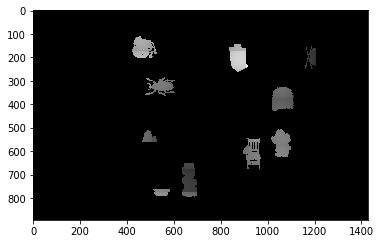

0.9238419827351738


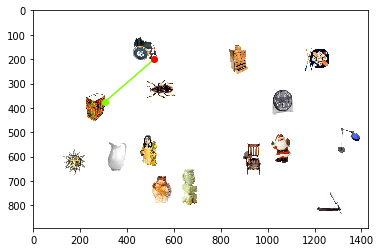

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


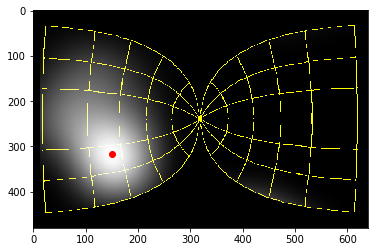

Eye_movement  6
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


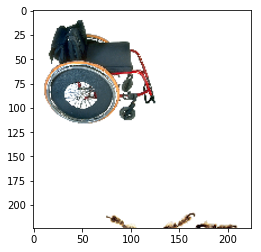

['Fixated area of the image and the classificatoin results']
0	 category: magnetic compass; confidence:7.0545,	labelID: n03706229 635
1	 category: bottlecap; confidence:6.9296,	labelID: n02877765 455
2	 category: analog clock; confidence:6.8006,	labelID: n02708093 409
3	 category: stopwatch, stop watch; confidence:6.3132,	labelID: n04328186 826
4	 category: chain saw, chainsaw; confidence:5.7188,	labelID: n03000684 491
Priority map


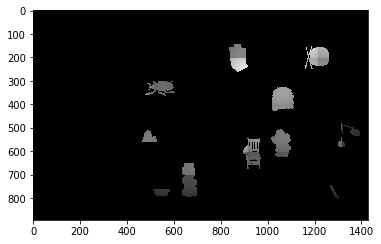

0.9460089187944045


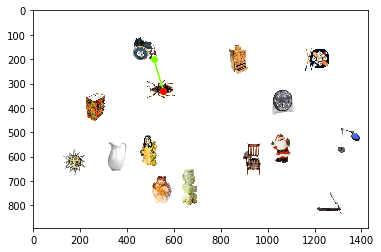

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


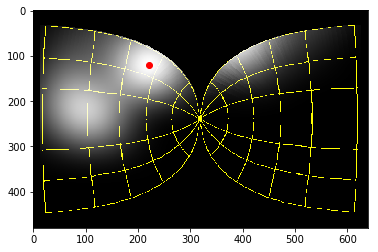

Eye_movement  7
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


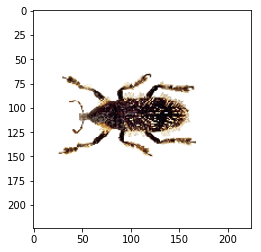

['Fixated area of the image and the classificatoin results']
0	 category: tick; confidence:19.4107,	labelID: n01776313 78
1	 category: weevil; confidence:17.8849,	labelID: n02177972 307
2	 category: rhinoceros beetle; confidence:15.5248,	labelID: n02174001 306
3	 category: leaf beetle, chrysomelid; confidence:15.3137,	labelID: n02169497 304
4	 category: long-horned beetle, longicorn, longicorn beetle; confidence:14.9644,	labelID: n02168699 303
Priority map


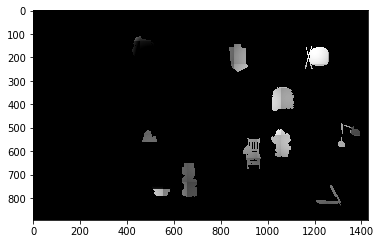

0.9033355903414122


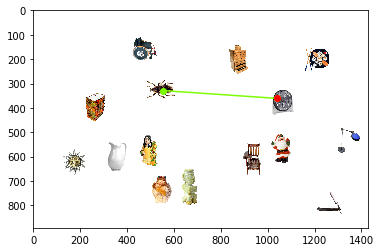

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


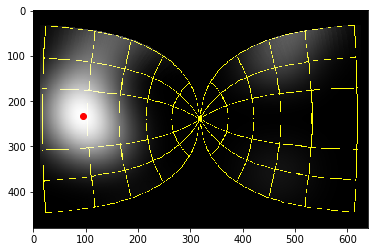

Eye_movement  8
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


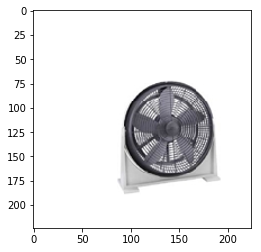

['Fixated area of the image and the classificatoin results']
0	 category: magnetic compass; confidence:9.9923,	labelID: n03706229 635
1	 category: electric fan, blower; confidence:9.8327,	labelID: n03271574 545
2	 category: analog clock; confidence:8.7743,	labelID: n02708093 409
3	 category: barbell; confidence:7.7047,	labelID: n02790996 422
4	 category: scale, weighing machine; confidence:7.6210,	labelID: n04141975 778


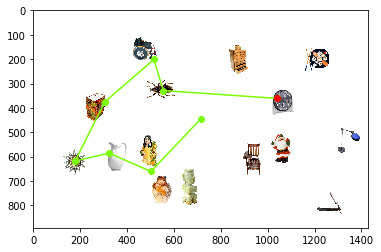

microwave_oven    651
object_array_displays_fixation_data/search_displays/present_073.png
Loading image


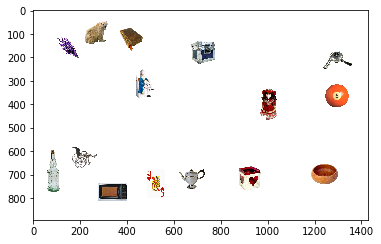

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


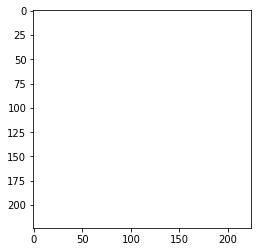

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


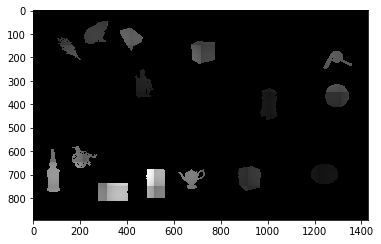

0.9779032845147423


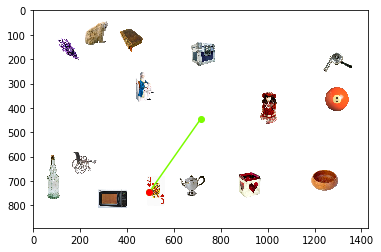

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


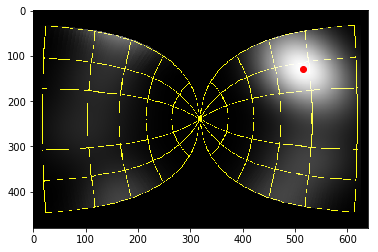

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


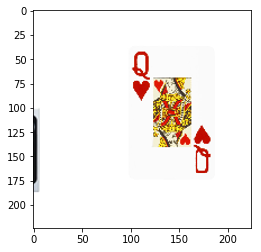

['Fixated area of the image and the classificatoin results']
0	 category: envelope; confidence:7.3957,	labelID: n03291819 549
1	 category: lighter, light, igniter, ignitor; confidence:7.3185,	labelID: n03666591 626
2	 category: jersey, T-shirt, tee shirt; confidence:6.6528,	labelID: n03595614 610
3	 category: punching bag, punch bag, punching ball, punchball; confidence:6.1252,	labelID: n04023962 747
4	 category: refrigerator, icebox; confidence:6.0874,	labelID: n04070727 760
Priority map


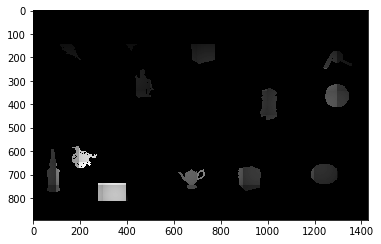

0.9853557853381899


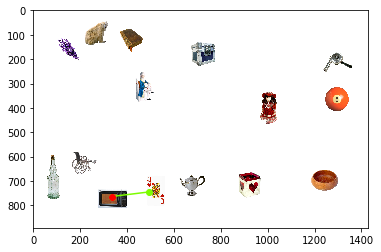

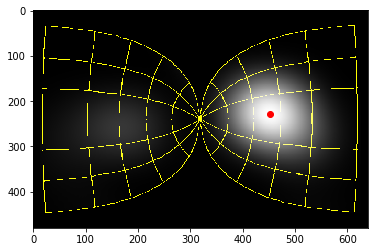

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


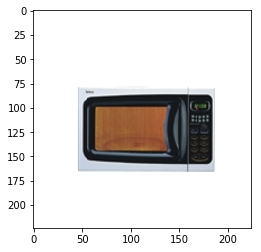

['Fixated area of the image and the classificatoin results']
0	 category: microwave, microwave oven; confidence:11.2016,	labelID: n03761084 651
1	 category: digital clock; confidence:9.3972,	labelID: n03196217 530
2	 category: rotisserie; confidence:7.1434,	labelID: n04111531 766
3	 category: stove; confidence:6.9830,	labelID: n04330267 827
4	 category: digital watch; confidence:6.4218,	labelID: n03197337 531


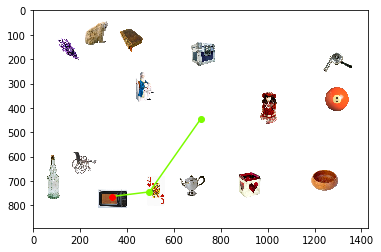

socks    806
object_array_displays_fixation_data/search_displays/present_074.png
Loading image


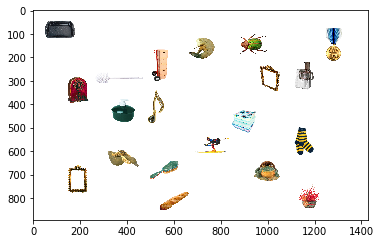

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


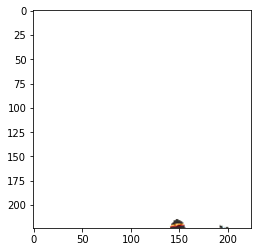

['Fixated area of the image and the classificatoin results']
0	 category: coucal; confidence:3.5997,	labelID: n01824575 91
1	 category: kite; confidence:3.3895,	labelID: n01608432 21
2	 category: ladybug, ladybeetle, lady beetle, ladybird, ladybird beetle; confidence:3.3416,	labelID: n02165456 301
3	 category: chain saw, chainsaw; confidence:3.2899,	labelID: n03000684 491
4	 category: house finch, linnet, Carpodacus mexicanus; confidence:3.1900,	labelID: n01532829 12
Priority map


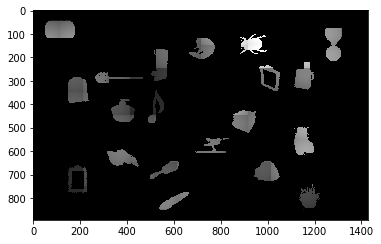

0.9903992990514902


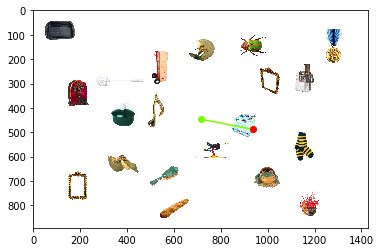

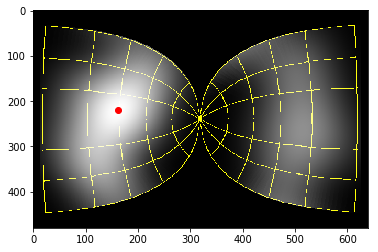

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


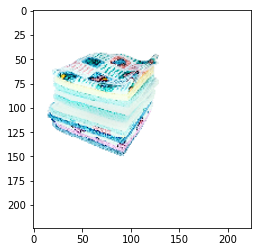

['Fixated area of the image and the classificatoin results']
0	 category: envelope; confidence:6.6240,	labelID: n03291819 549
1	 category: hair slide; confidence:6.5240,	labelID: n03476684 584
2	 category: web site, website, internet site, site; confidence:5.7740,	labelID: n06359193 916
3	 category: safety pin; confidence:5.5722,	labelID: n04127249 772
4	 category: pencil sharpener; confidence:5.4836,	labelID: n03908714 710
Priority map


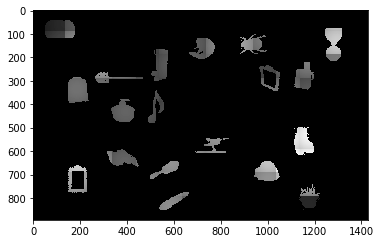

0.9231731481256179


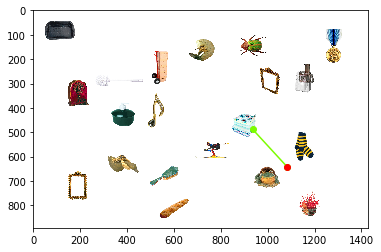

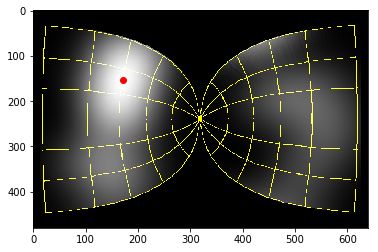

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


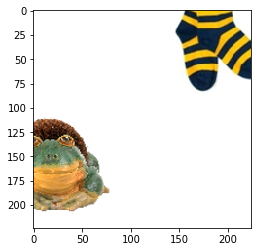

['Fixated area of the image and the classificatoin results']
0	 category: teddy, teddy bear; confidence:7.9668,	labelID: n04399382 850
1	 category: necklace; confidence:7.4293,	labelID: n03814906 679
2	 category: mask; confidence:7.4077,	labelID: n03724870 643
3	 category: piggy bank, penny bank; confidence:6.6075,	labelID: n03935335 719
4	 category: hair slide; confidence:6.3394,	labelID: n03476684 584
Priority map


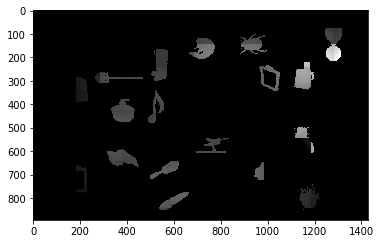

0.9281816364437986


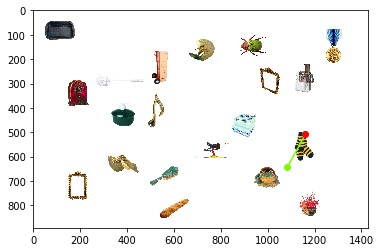

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


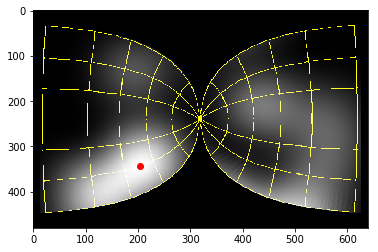

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


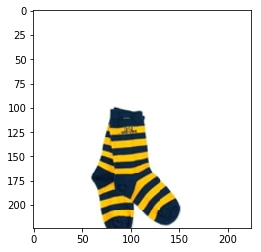

['Fixated area of the image and the classificatoin results']
0	 category: sock; confidence:7.7053,	labelID: n04254777 806
1	 category: Christmas stocking; confidence:6.7928,	labelID: n03026506 496
2	 category: maillot; confidence:5.7860,	labelID: n03710637 638
3	 category: knee pad; confidence:5.4369,	labelID: n03623198 615
4	 category: wool, woolen, woollen; confidence:5.2926,	labelID: n04599235 911


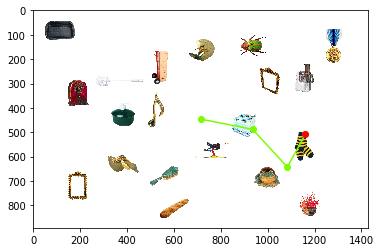

rug    741
object_array_displays_fixation_data/search_displays/present_075.png
Loading image


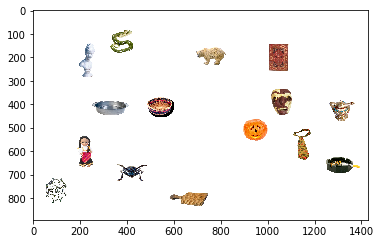

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


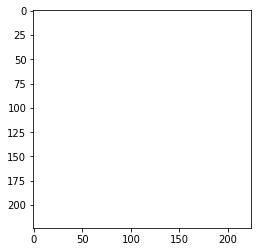

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


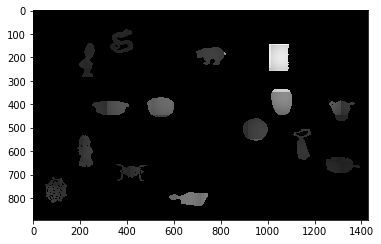

0.8305093658585982


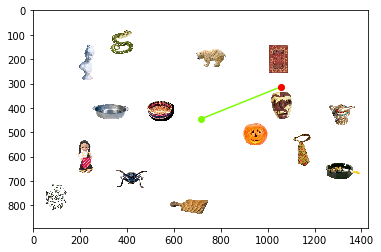

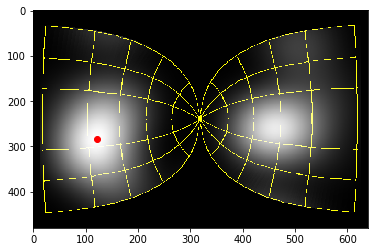

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


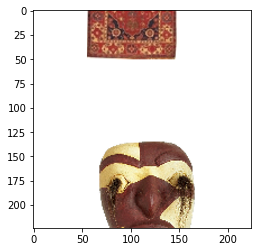

['Fixated area of the image and the classificatoin results']
0	 category: mask; confidence:9.8975,	labelID: n03724870 643
1	 category: chiton, coat-of-mail shell, sea cradle, polyplacophore; confidence:7.2437,	labelID: n01955084 116
2	 category: vestment; confidence:6.9277,	labelID: n04532106 887
3	 category: bow tie, bow-tie, bowtie; confidence:6.4704,	labelID: n02883205 457
4	 category: Band Aid; confidence:6.4458,	labelID: n02786058 419
Priority map


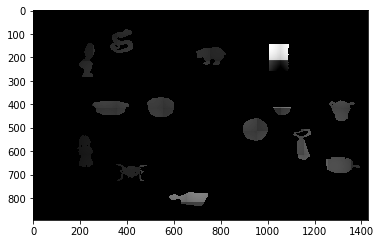

0.9986957125265412


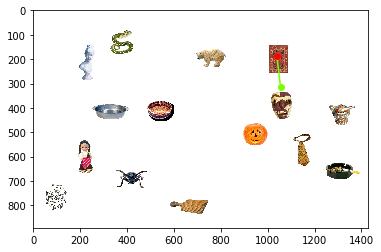

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


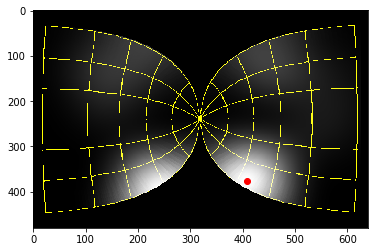

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


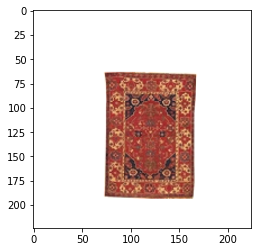

['Fixated area of the image and the classificatoin results']
0	 category: prayer rug, prayer mat; confidence:10.8868,	labelID: n03998194 741
1	 category: doormat, welcome mat; confidence:7.2375,	labelID: n03223299 539
2	 category: Windsor tie; confidence:6.8846,	labelID: n04591157 906
3	 category: vestment; confidence:6.3516,	labelID: n04532106 887
4	 category: wool, woolen, woollen; confidence:5.9147,	labelID: n04599235 911


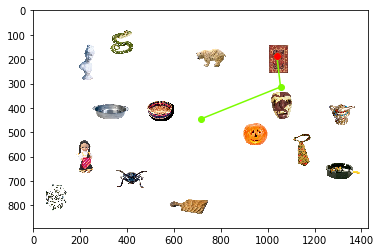

microwave_oven    651
object_array_displays_fixation_data/search_displays/present_076.png
Loading image


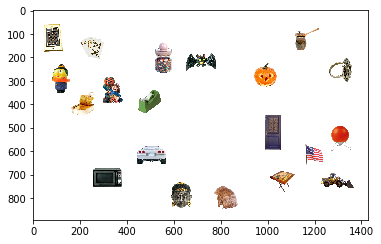

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


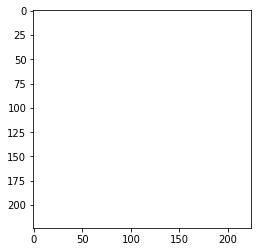

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


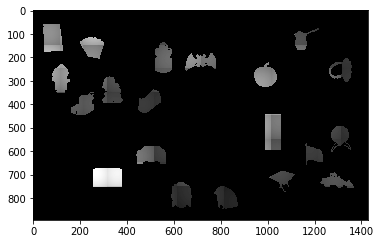

0.7956367121518113


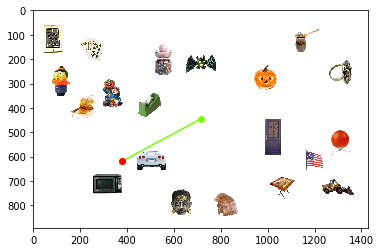

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


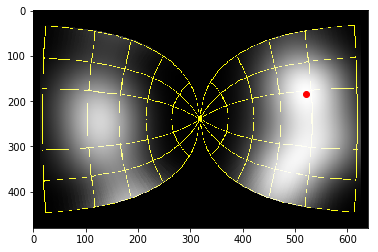

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


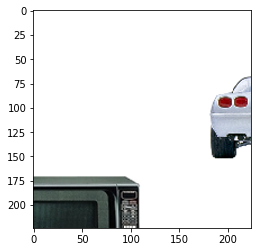

['Fixated area of the image and the classificatoin results']
0	 category: tape player; confidence:7.2608,	labelID: n04392985 848
1	 category: radio, wireless; confidence:7.1797,	labelID: n04041544 754
2	 category: Polaroid camera, Polaroid Land camera; confidence:7.0105,	labelID: n03976467 732
3	 category: space heater; confidence:6.7366,	labelID: n04265275 811
4	 category: cassette player; confidence:6.6543,	labelID: n02979186 482
Priority map


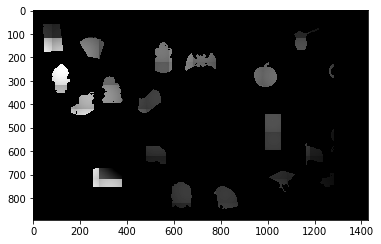

0.9226979977928381


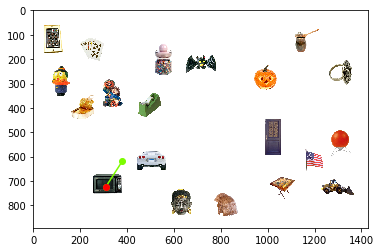

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


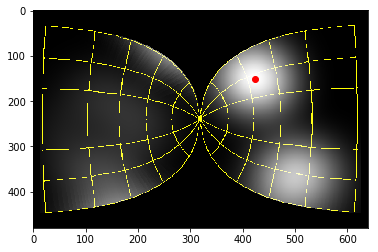

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


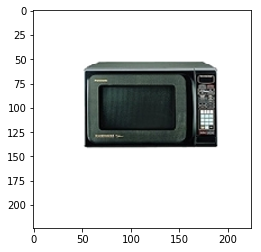

['Fixated area of the image and the classificatoin results']
0	 category: microwave, microwave oven; confidence:10.5319,	labelID: n03761084 651
1	 category: digital clock; confidence:10.1690,	labelID: n03196217 530
2	 category: digital watch; confidence:7.9680,	labelID: n03197337 531
3	 category: radio, wireless; confidence:7.7348,	labelID: n04041544 754
4	 category: Polaroid camera, Polaroid Land camera; confidence:7.6193,	labelID: n03976467 732


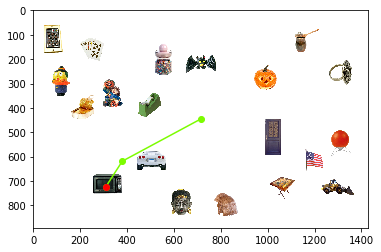

teddy_bear    850
object_array_displays_fixation_data/search_displays/present_077.png
Loading image


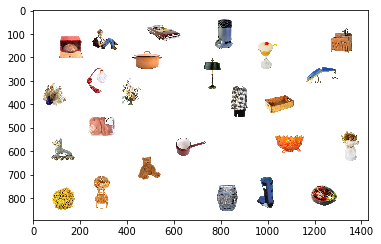

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


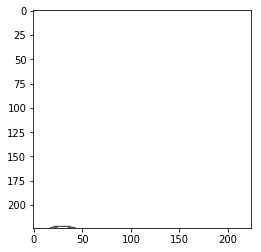

['Fixated area of the image and the classificatoin results']
0	 category: microphone, mike; confidence:3.9170,	labelID: n03759954 650
1	 category: puck, hockey puck; confidence:3.7989,	labelID: n04019541 746
2	 category: corkscrew, bottle screw; confidence:3.7316,	labelID: n03109150 512
3	 category: hook, claw; confidence:3.4177,	labelID: n03532672 600
4	 category: can opener, tin opener; confidence:3.3612,	labelID: n02951585 473
Priority map


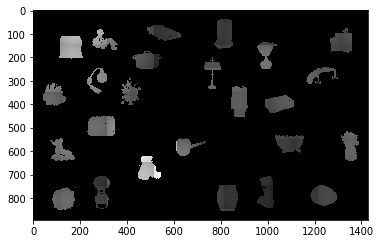

0.9513376883992518


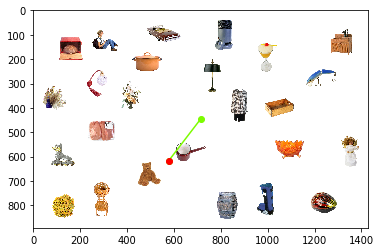

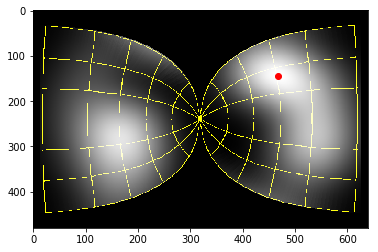

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


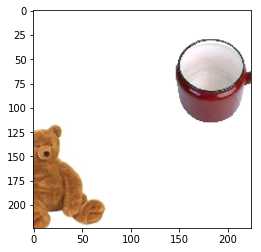

['Fixated area of the image and the classificatoin results']
0	 category: teddy, teddy bear; confidence:9.9919,	labelID: n04399382 850
1	 category: pill bottle; confidence:7.7629,	labelID: n03937543 720
2	 category: nipple; confidence:7.6387,	labelID: n03825788 680
3	 category: cup; confidence:7.3141,	labelID: n07930864 968
4	 category: stethoscope; confidence:6.8169,	labelID: n04317175 823


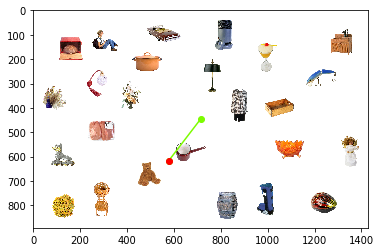

teddy_bear    850
object_array_displays_fixation_data/search_displays/present_079.png
Loading image


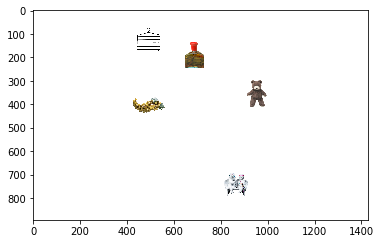

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


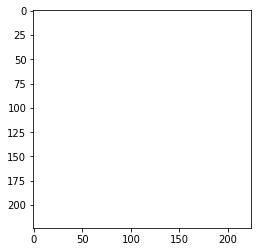

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


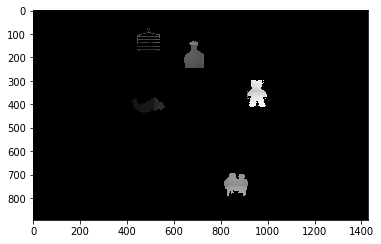

0.997201254614503


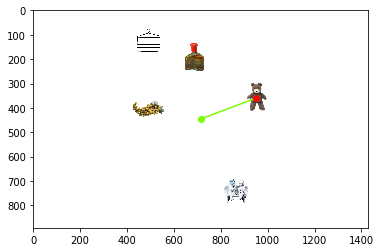

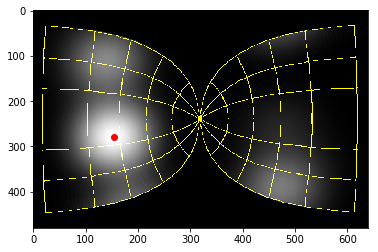

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


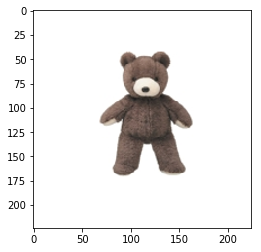

['Fixated area of the image and the classificatoin results']
0	 category: teddy, teddy bear; confidence:12.5729,	labelID: n04399382 850
1	 category: hair slide; confidence:7.3201,	labelID: n03476684 584
2	 category: earthstar; confidence:6.9589,	labelID: n13044778 995
3	 category: toyshop; confidence:6.2655,	labelID: n04462240 865
4	 category: wool, woolen, woollen; confidence:6.1169,	labelID: n04599235 911


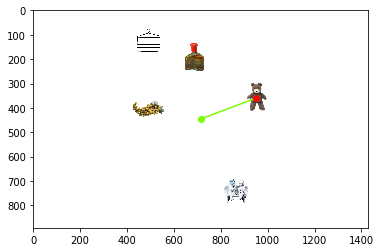

crib    520
object_array_displays_fixation_data/search_displays/present_080.png
Loading image


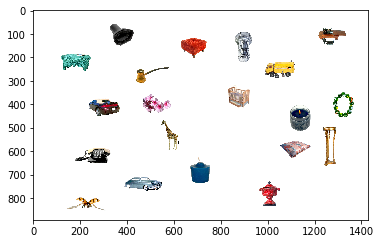

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


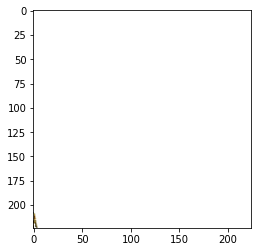

['Fixated area of the image and the classificatoin results']
0	 category: sax, saxophone; confidence:3.6565,	labelID: n04141076 776
1	 category: corkscrew, bottle screw; confidence:3.2337,	labelID: n03109150 512
2	 category: hook, claw; confidence:2.9990,	labelID: n03532672 600
3	 category: red wine; confidence:2.7356,	labelID: n07892512 966
4	 category: quill, quill pen; confidence:2.7271,	labelID: n04033901 749
Priority map


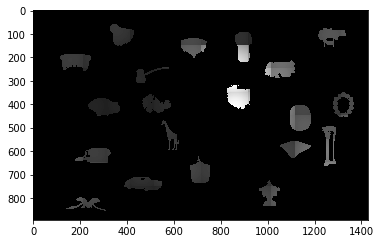

0.9268063464294595


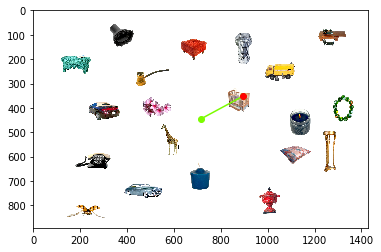

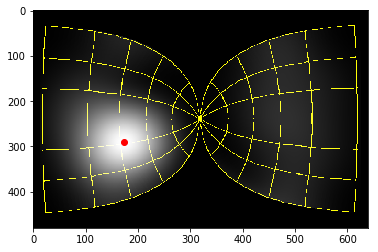

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


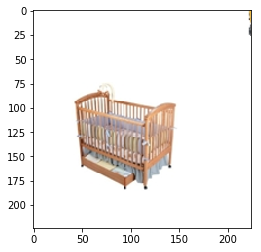

['Fixated area of the image and the classificatoin results']
0	 category: cradle; confidence:13.9719,	labelID: n03125729 516
1	 category: crib, cot; confidence:13.3907,	labelID: n03131574 520
2	 category: shopping basket; confidence:11.0231,	labelID: n04204238 790
3	 category: bassinet; confidence:9.8192,	labelID: n02804414 431
4	 category: hamper; confidence:9.5741,	labelID: n03482405 588


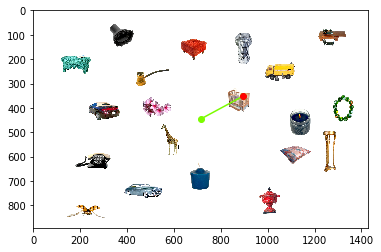

microwave_oven    651
object_array_displays_fixation_data/search_displays/present_085.png
Loading image


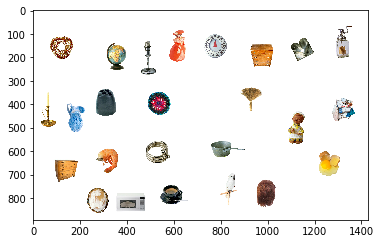

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


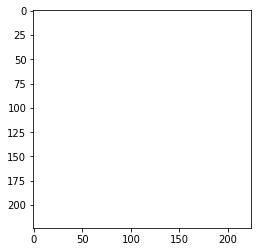

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


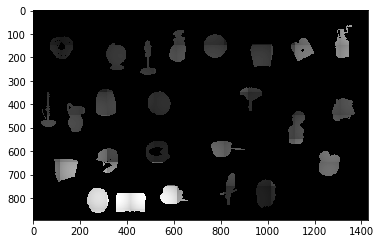

1.0


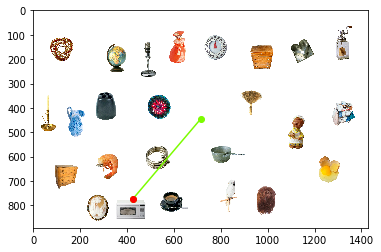

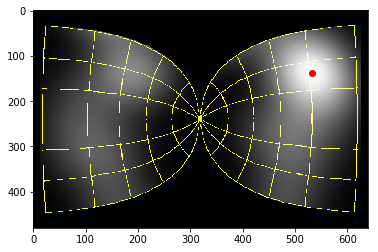

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


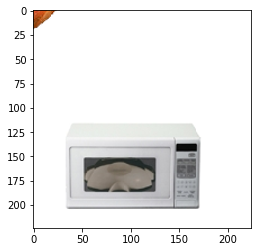

['Fixated area of the image and the classificatoin results']
0	 category: safe; confidence:10.4624,	labelID: n04125021 771
1	 category: printer; confidence:8.9028,	labelID: n04004767 742
2	 category: scale, weighing machine; confidence:8.7442,	labelID: n04141975 778
3	 category: sewing machine; confidence:8.6521,	labelID: n04179913 786
4	 category: microwave, microwave oven; confidence:8.6260,	labelID: n03761084 651


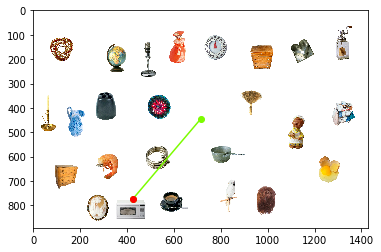

teddy_bear    850
object_array_displays_fixation_data/search_displays/present_088.png
Loading image


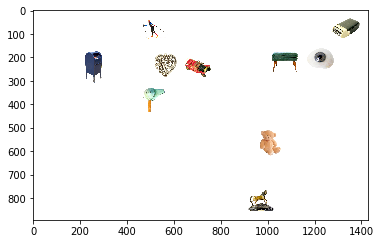

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


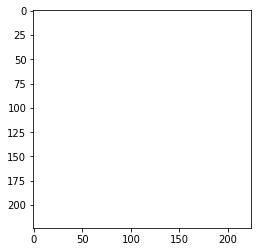

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


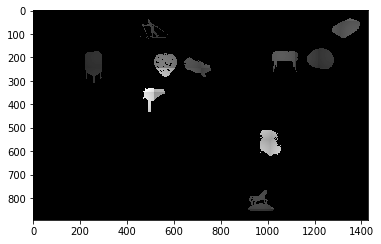

0.9372309687224577


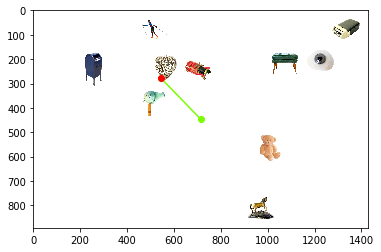

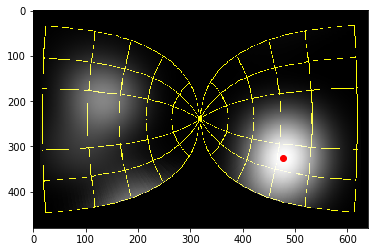

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


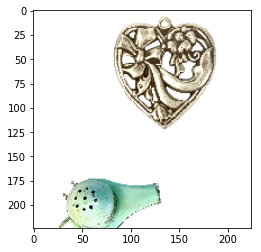

['Fixated area of the image and the classificatoin results']
0	 category: hair slide; confidence:13.2569,	labelID: n03476684 584
1	 category: necklace; confidence:13.0866,	labelID: n03814906 679
2	 category: buckle; confidence:10.6437,	labelID: n02910353 464
3	 category: hook, claw; confidence:9.5259,	labelID: n03532672 600
4	 category: letter opener, paper knife, paperknife; confidence:9.3844,	labelID: n03658185 623
Priority map


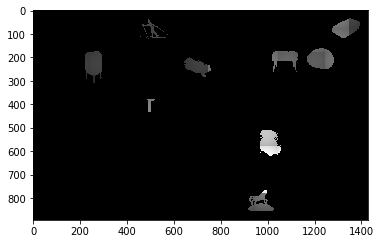

0.8348095614338736


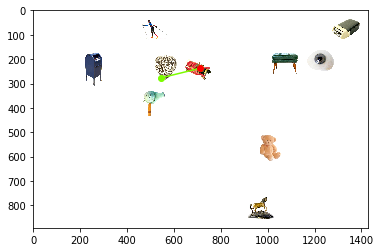

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


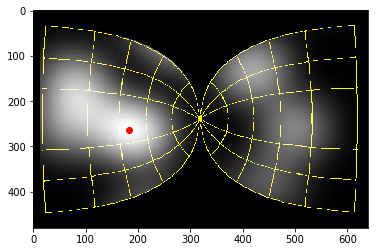

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


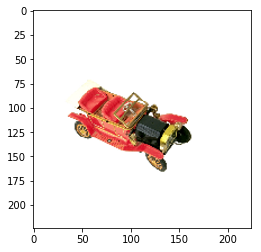

['Fixated area of the image and the classificatoin results']
0	 category: crane; confidence:8.4988,	labelID: n03126707 517
1	 category: switch, electric switch, electrical switch; confidence:8.4778,	labelID: n04372370 844
2	 category: whistle; confidence:8.3157,	labelID: n04579432 902
3	 category: lighter, light, igniter, ignitor; confidence:8.0086,	labelID: n03666591 626
4	 category: reel; confidence:7.2399,	labelID: n04067472 758
Priority map


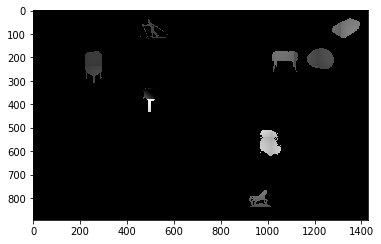

0.7573766530996917


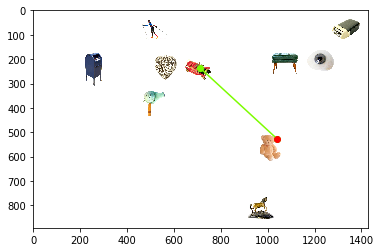

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


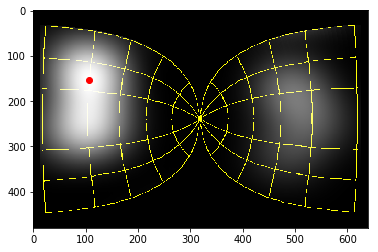

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


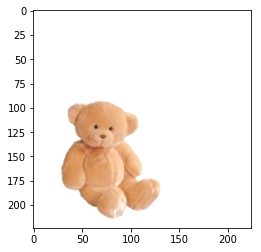

['Fixated area of the image and the classificatoin results']
0	 category: teddy, teddy bear; confidence:10.7784,	labelID: n04399382 850
1	 category: diaper, nappy, napkin; confidence:8.3700,	labelID: n03188531 529
2	 category: nipple; confidence:7.4007,	labelID: n03825788 680
3	 category: Band Aid; confidence:7.0381,	labelID: n02786058 419
4	 category: rubber eraser, rubber, pencil eraser; confidence:6.8917,	labelID: n04116512 767


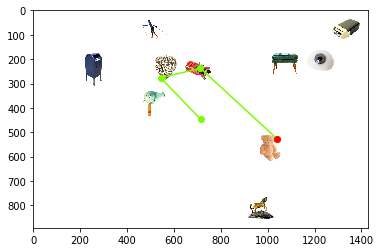

crib    520
object_array_displays_fixation_data/search_displays/present_093.png
Loading image


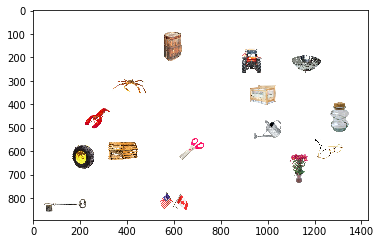

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


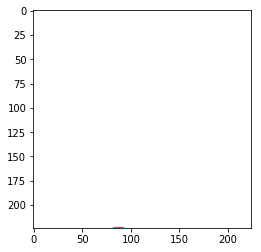

['Fixated area of the image and the classificatoin results']
0	 category: red wine; confidence:4.0366,	labelID: n07892512 966
1	 category: cleaver, meat cleaver, chopper; confidence:3.7518,	labelID: n03041632 499
2	 category: envelope; confidence:3.6253,	labelID: n03291819 549
3	 category: hook, claw; confidence:3.4662,	labelID: n03532672 600
4	 category: lipstick, lip rouge; confidence:3.4075,	labelID: n03676483 629
Priority map


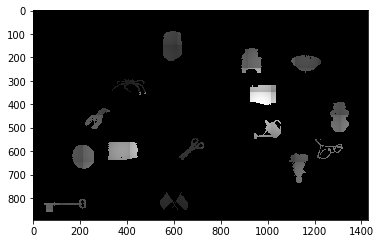

0.9989360615990405


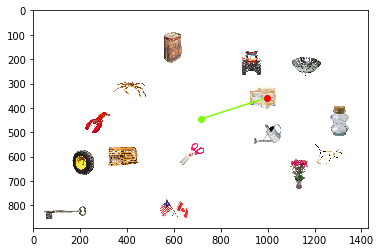

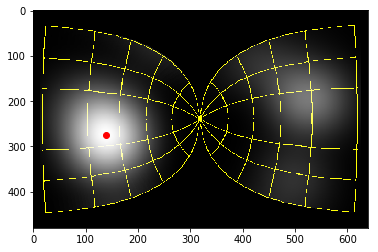

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


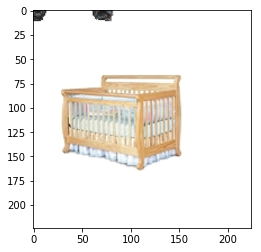

['Fixated area of the image and the classificatoin results']
0	 category: crib, cot; confidence:9.2856,	labelID: n03131574 520
1	 category: hamper; confidence:9.1999,	labelID: n03482405 588
2	 category: shopping basket; confidence:8.9138,	labelID: n04204238 790
3	 category: cradle; confidence:8.8918,	labelID: n03125729 516
4	 category: plate rack; confidence:8.5163,	labelID: n03961711 729


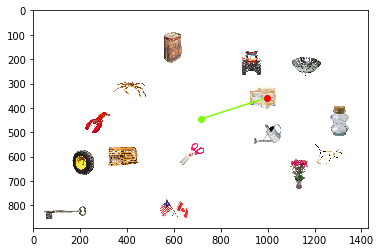

clock    409
object_array_displays_fixation_data/search_displays/present_094.png
Loading image


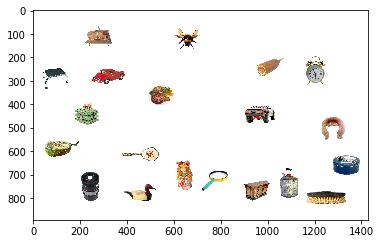

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


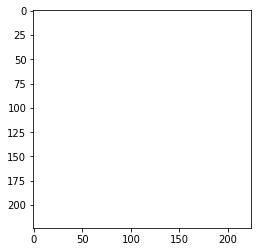

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


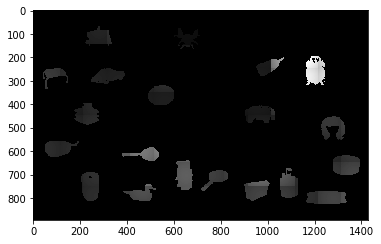

0.9885251073398196


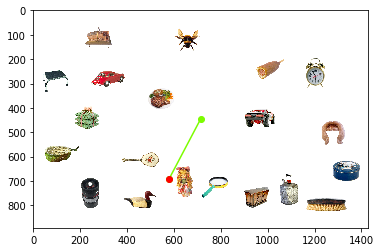

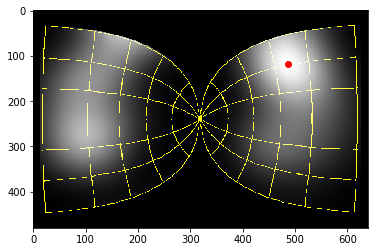

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


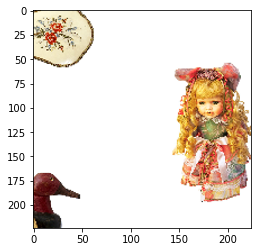

['Fixated area of the image and the classificatoin results']
0	 category: necklace; confidence:6.6009,	labelID: n03814906 679
1	 category: cock; confidence:5.8710,	labelID: n01514668 7
2	 category: strawberry; confidence:5.6472,	labelID: n07745940 949
3	 category: pomegranate; confidence:5.6470,	labelID: n07768694 957
4	 category: hair slide; confidence:5.1182,	labelID: n03476684 584
Priority map


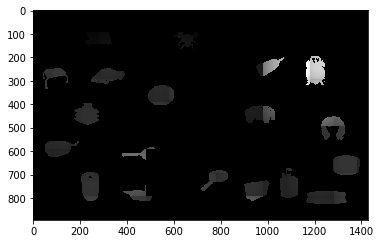

0.937305252667649


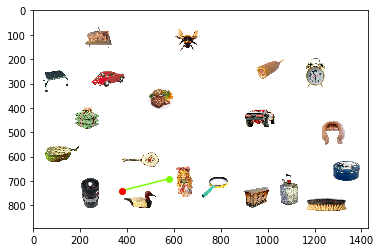

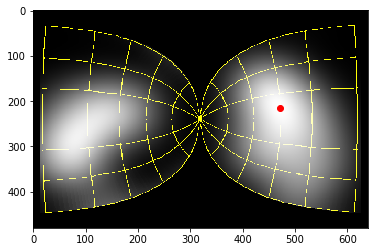

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


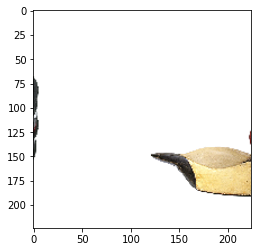

['Fixated area of the image and the classificatoin results']
0	 category: sandal; confidence:6.2885,	labelID: n04133789 774
1	 category: rhinoceros beetle; confidence:5.8375,	labelID: n02174001 306
2	 category: buckeye, horse chestnut, conker; confidence:5.7889,	labelID: n12768682 990
3	 category: clog, geta, patten, sabot; confidence:5.7298,	labelID: n03047690 502
4	 category: chocolate sauce, chocolate syrup; confidence:4.4457,	labelID: n07836838 960
Priority map


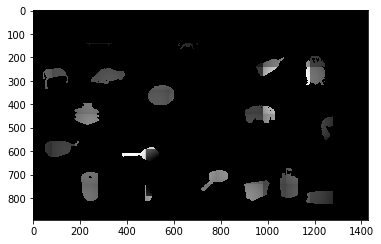

0.9056979615177293


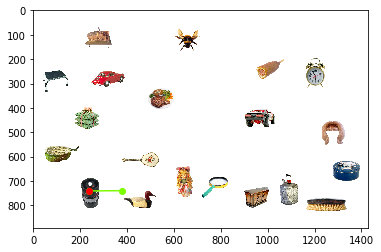

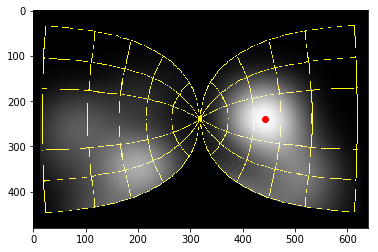

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


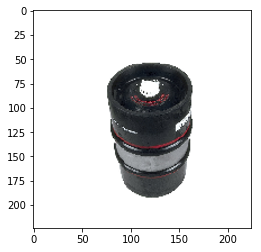

['Fixated area of the image and the classificatoin results']
0	 category: loupe, jeweler's loupe; confidence:10.5994,	labelID: n03692522 633
1	 category: beer bottle; confidence:9.5970,	labelID: n02823428 440
2	 category: puck, hockey puck; confidence:9.5715,	labelID: n04019541 746
3	 category: wine bottle; confidence:9.0940,	labelID: n04591713 907
4	 category: magnetic compass; confidence:8.9096,	labelID: n03706229 635
Priority map


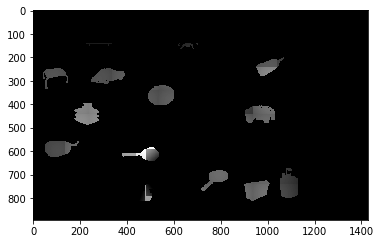

1.0


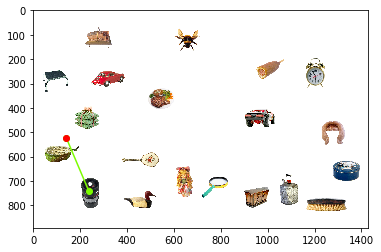

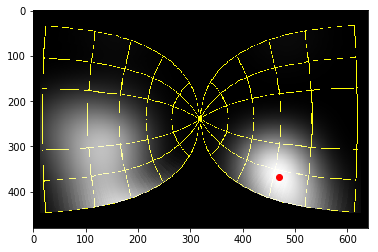

Eye_movement  5
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


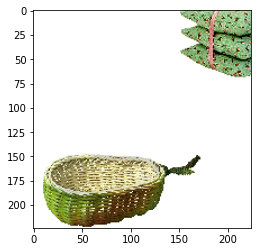

['Fixated area of the image and the classificatoin results']
0	 category: ear, spike, capitulum; confidence:8.3915,	labelID: n13133613 998
1	 category: strainer; confidence:8.1902,	labelID: n04332243 828
2	 category: shopping basket; confidence:8.1058,	labelID: n04204238 790
3	 category: corn; confidence:7.8356,	labelID: n12144580 987
4	 category: acorn; confidence:7.7329,	labelID: n12267677 988
Priority map


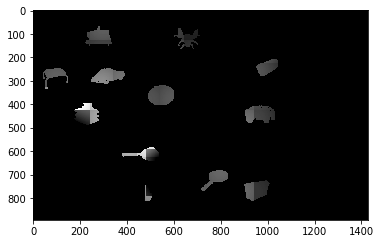

0.9737798018504087


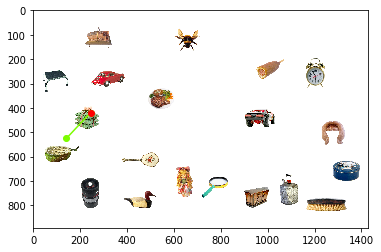

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


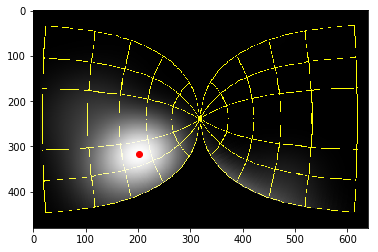

Eye_movement  6
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


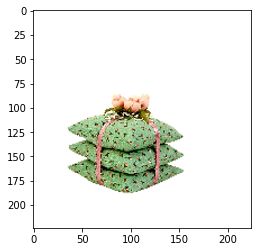

['Fixated area of the image and the classificatoin results']
0	 category: custard apple; confidence:10.8967,	labelID: n07760859 956
1	 category: hair slide; confidence:7.6378,	labelID: n03476684 584
2	 category: artichoke, globe artichoke; confidence:7.2334,	labelID: n07718747 944
3	 category: honeycomb; confidence:7.1098,	labelID: n03530642 599
4	 category: purse; confidence:6.6477,	labelID: n04026417 748
Priority map


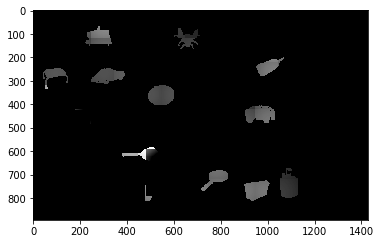

0.6826376405880794


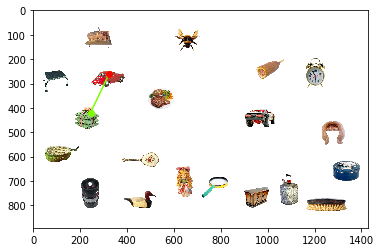

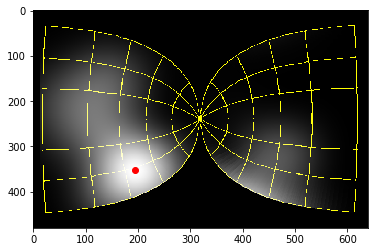

Eye_movement  7
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


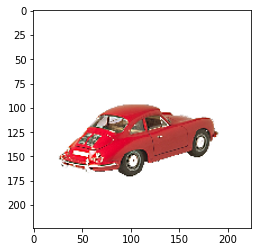

['Fixated area of the image and the classificatoin results']
0	 category: racer, race car, racing car; confidence:9.9400,	labelID: n04037443 751
1	 category: convertible; confidence:9.1422,	labelID: n03100240 511
2	 category: car wheel; confidence:9.0549,	labelID: n02974003 479
3	 category: tow truck, tow car, wrecker; confidence:9.0225,	labelID: n04461696 864
4	 category: pickup, pickup truck; confidence:8.9362,	labelID: n03930630 717
Priority map


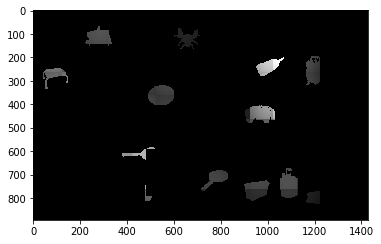

0.5982141425101524


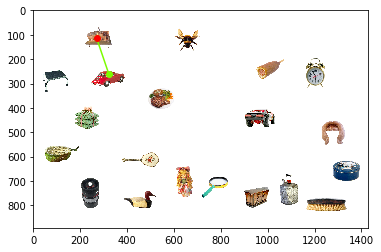

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


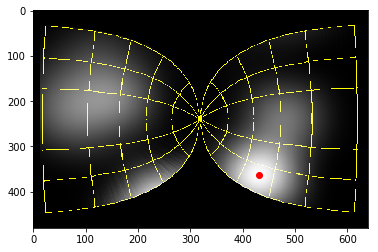

Eye_movement  8
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


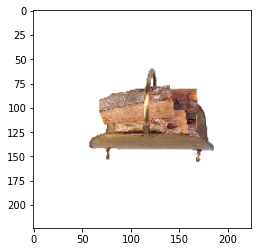

['Fixated area of the image and the classificatoin results']
0	 category: lumbermill, sawmill; confidence:5.9964,	labelID: n03697007 634
1	 category: mousetrap; confidence:5.7527,	labelID: n03794056 674
2	 category: hook, claw; confidence:5.4891,	labelID: n03532672 600
3	 category: chime, bell, gong; confidence:5.2914,	labelID: n03017168 494
4	 category: airship, dirigible; confidence:5.0872,	labelID: n02692877 405
Priority map


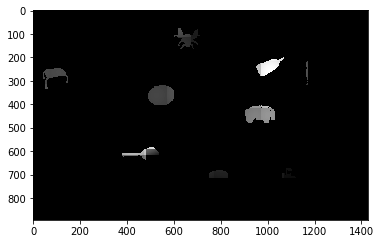

0.9695437229472885


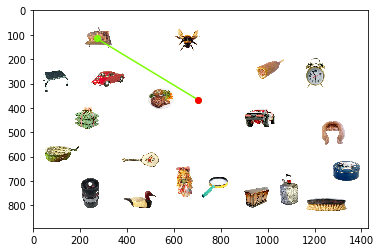

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


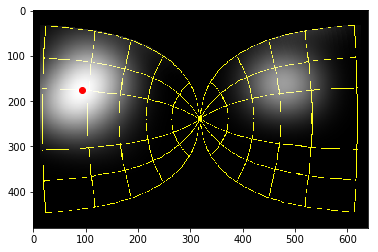

Eye_movement  9
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


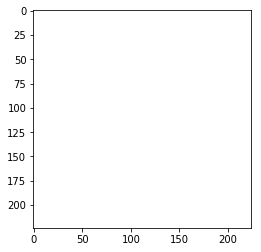

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.4997,	labelID: n03041632 499
1	 category: envelope; confidence:3.3603,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.1079,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:2.9992,	labelID: n03109150 512
4	 category: face powder; confidence:2.9753,	labelID: n03314780 551
Priority map


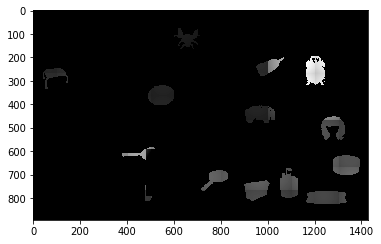

0.8740997926479389


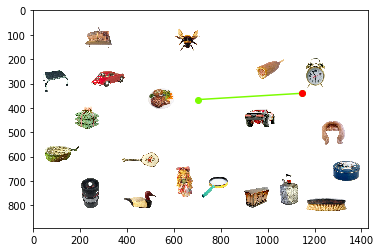

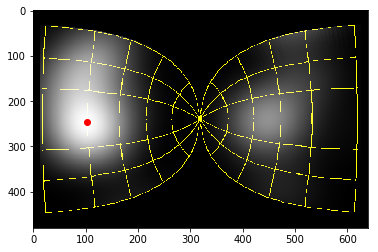

Eye_movement  10
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


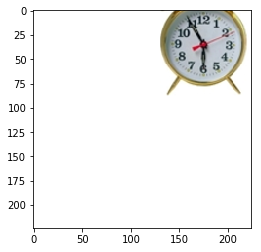

['Fixated area of the image and the classificatoin results']
0	 category: analog clock; confidence:13.6917,	labelID: n02708093 409
1	 category: wall clock; confidence:13.0140,	labelID: n04548280 892
2	 category: stopwatch, stop watch; confidence:12.8295,	labelID: n04328186 826
3	 category: barometer; confidence:12.3227,	labelID: n02794156 426
4	 category: magnetic compass; confidence:11.6217,	labelID: n03706229 635


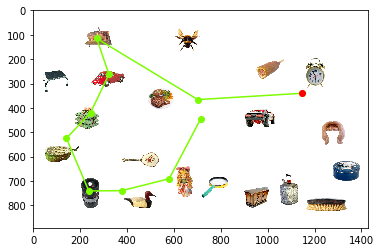

rug    741
object_array_displays_fixation_data/search_displays/present_102.png
Loading image


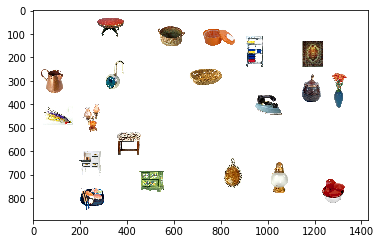

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


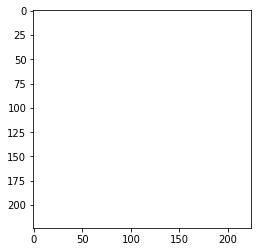

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


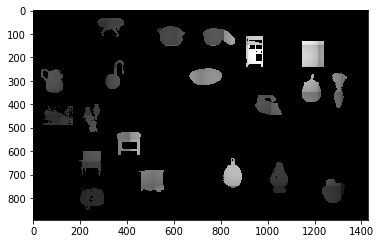

0.9823892884227434


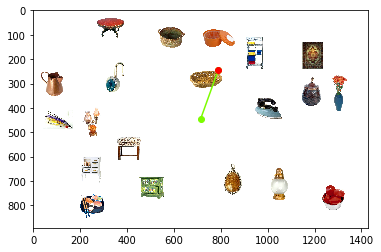

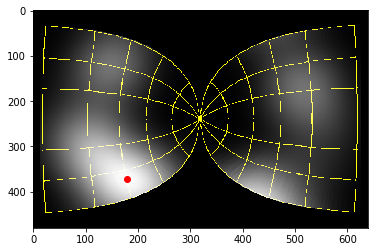

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


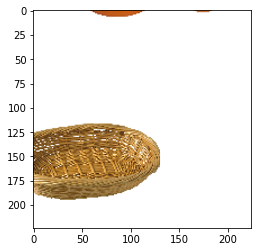

['Fixated area of the image and the classificatoin results']
0	 category: maraca; confidence:8.1298,	labelID: n03720891 641
1	 category: lacewing, lacewing fly; confidence:8.0972,	labelID: n02264363 318
2	 category: cockroach, roach; confidence:7.3963,	labelID: n02233338 314
3	 category: sombrero; confidence:6.8805,	labelID: n04259630 808
4	 category: leafhopper; confidence:6.8637,	labelID: n02259212 317
Priority map


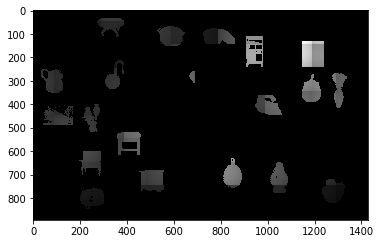

0.9432903864896987


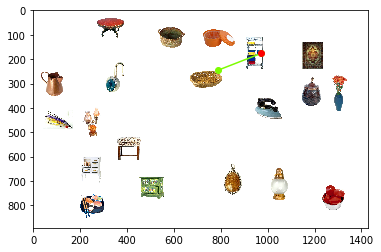

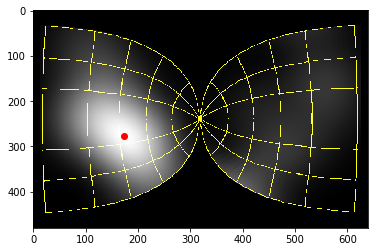

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


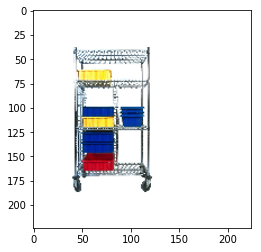

['Fixated area of the image and the classificatoin results']
0	 category: stretcher; confidence:12.6098,	labelID: n04336792 830
1	 category: shopping cart; confidence:11.9143,	labelID: n04204347 791
2	 category: folding chair; confidence:11.4095,	labelID: n03376595 559
3	 category: mousetrap; confidence:10.4791,	labelID: n03794056 674
4	 category: plate rack; confidence:9.1542,	labelID: n03961711 729
Priority map


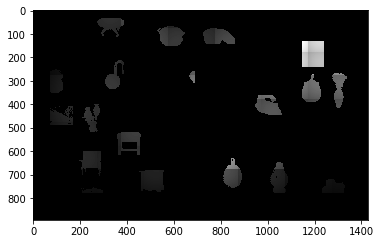

0.9480687407591178


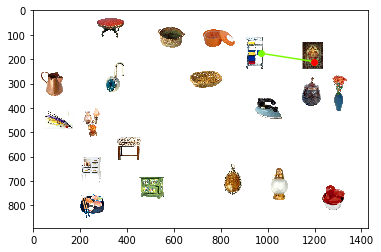

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


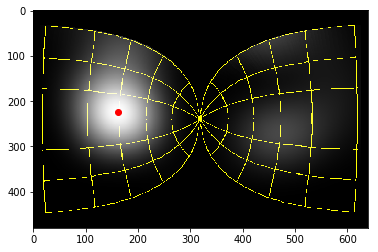

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


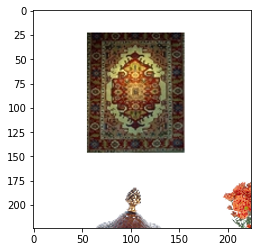

['Fixated area of the image and the classificatoin results']
0	 category: prayer rug, prayer mat; confidence:9.2176,	labelID: n03998194 741
1	 category: throne; confidence:8.2093,	labelID: n04429376 857
2	 category: vestment; confidence:8.0929,	labelID: n04532106 887
3	 category: altar; confidence:6.8915,	labelID: n02699494 406
4	 category: necklace; confidence:6.5051,	labelID: n03814906 679


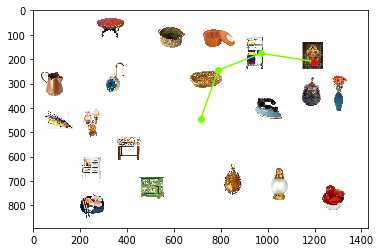

socks    806
object_array_displays_fixation_data/search_displays/present_105.png
Loading image


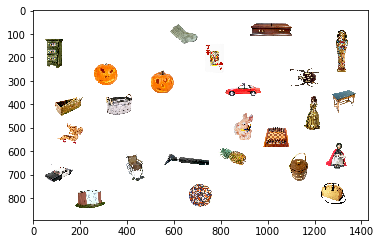

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


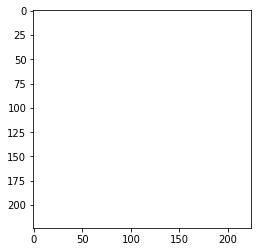

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


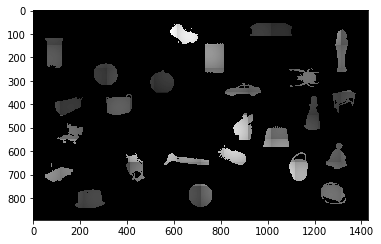

0.9204367410951536


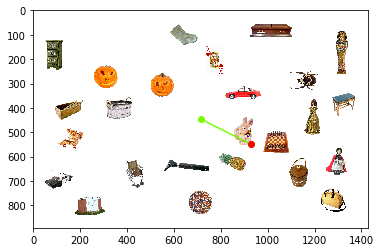

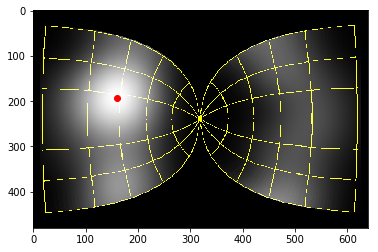

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


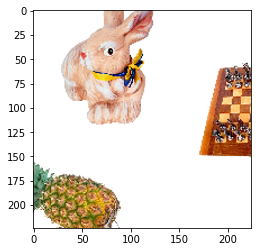

['Fixated area of the image and the classificatoin results']
0	 category: hamper; confidence:8.8886,	labelID: n03482405 588
1	 category: purse; confidence:7.5428,	labelID: n04026417 748
2	 category: piggy bank, penny bank; confidence:7.5314,	labelID: n03935335 719
3	 category: necklace; confidence:7.2948,	labelID: n03814906 679
4	 category: bow tie, bow-tie, bowtie; confidence:7.0580,	labelID: n02883205 457
Priority map


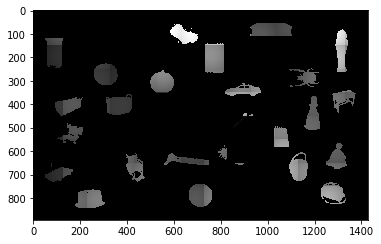

0.9995735215132948


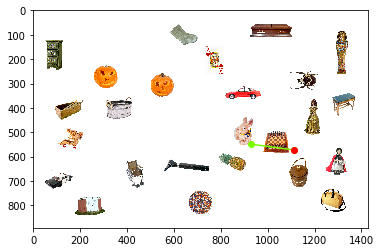

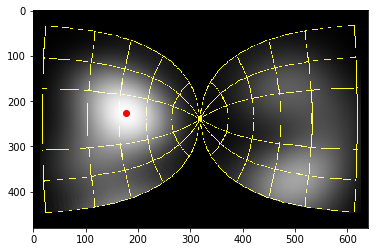

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


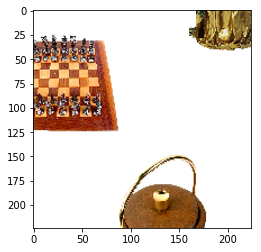

['Fixated area of the image and the classificatoin results']
0	 category: abacus; confidence:10.9012,	labelID: n02666196 398
1	 category: chime, bell, gong; confidence:8.8811,	labelID: n03017168 494
2	 category: magnetic compass; confidence:7.9996,	labelID: n03706229 635
3	 category: buckle; confidence:7.9920,	labelID: n02910353 464
4	 category: purse; confidence:7.9652,	labelID: n04026417 748
Priority map


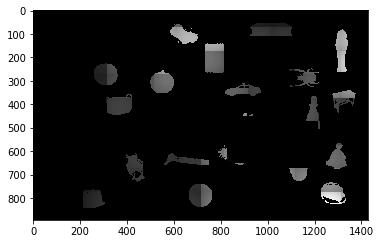

0.9779826153876938


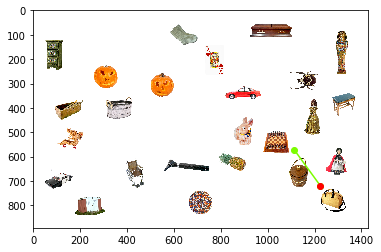

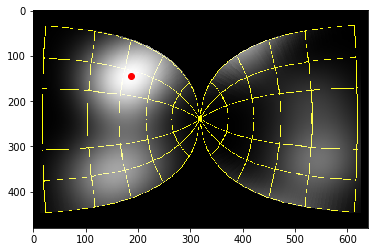

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


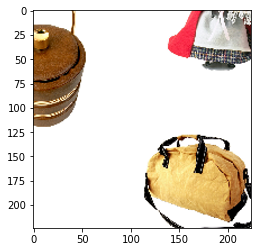

['Fixated area of the image and the classificatoin results']
0	 category: clog, geta, patten, sabot; confidence:8.8664,	labelID: n03047690 502
1	 category: chocolate sauce, chocolate syrup; confidence:8.5989,	labelID: n07836838 960
2	 category: drum, membranophone, tympan; confidence:8.4695,	labelID: n03249569 541
3	 category: bagel, beigel; confidence:8.0787,	labelID: n07693725 931
4	 category: purse; confidence:7.9958,	labelID: n04026417 748
Priority map


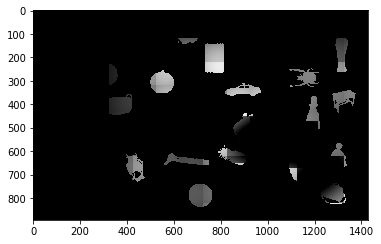

0.9651719082634581


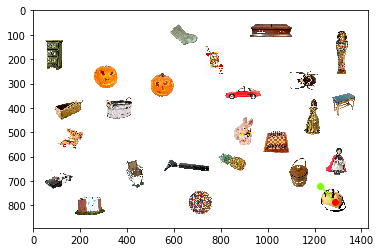

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


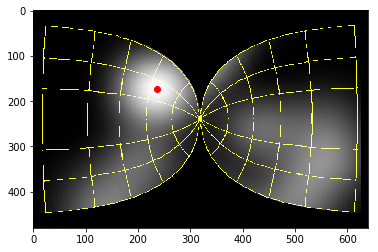

Eye_movement  5
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


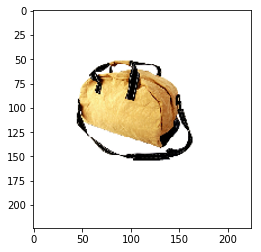

['Fixated area of the image and the classificatoin results']
0	 category: chocolate sauce, chocolate syrup; confidence:7.9951,	labelID: n07836838 960
1	 category: black and gold garden spider, Argiope aurantia; confidence:7.8754,	labelID: n01773157 72
2	 category: garden spider, Aranea diademata; confidence:7.7858,	labelID: n01773797 74
3	 category: rhinoceros beetle; confidence:7.6396,	labelID: n02174001 306
4	 category: barn spider, Araneus cavaticus; confidence:7.6037,	labelID: n01773549 73
Priority map


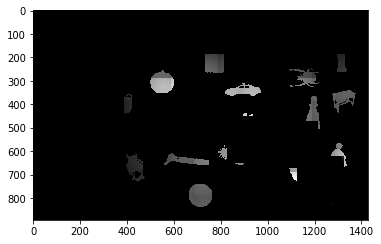

0.6537171776193363


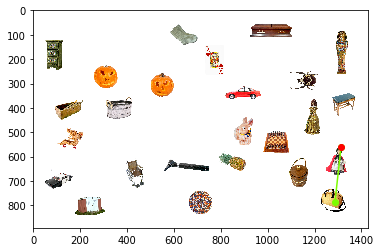

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


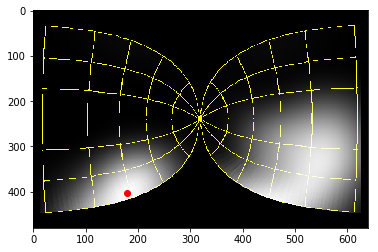

Eye_movement  6
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


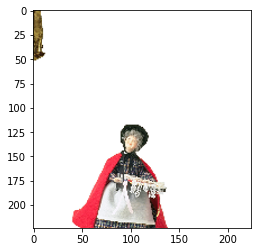

['Fixated area of the image and the classificatoin results']
0	 category: overskirt; confidence:10.7729,	labelID: n03866082 689
1	 category: hoopskirt, crinoline; confidence:10.2813,	labelID: n03534580 601
2	 category: bearskin, busby, shako; confidence:9.6776,	labelID: n02817516 439
3	 category: kimono; confidence:9.6020,	labelID: n03617480 614
4	 category: cloak; confidence:8.5734,	labelID: n03045698 501
Priority map


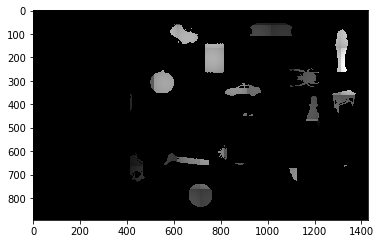

0.9533321223282135


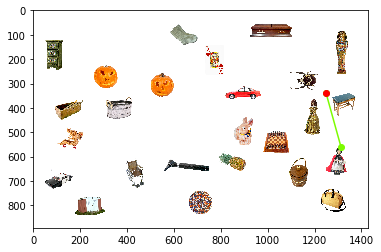

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


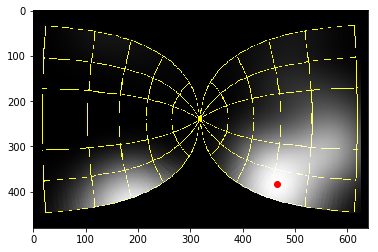

Eye_movement  7
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


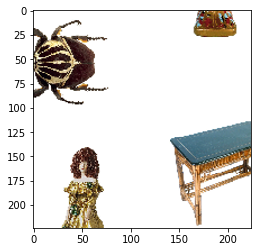

['Fixated area of the image and the classificatoin results']
0	 category: throne; confidence:7.0833,	labelID: n04429376 857
1	 category: hamper; confidence:6.3365,	labelID: n03482405 588
2	 category: tick; confidence:6.1821,	labelID: n01776313 78
3	 category: honeycomb; confidence:6.1028,	labelID: n03530642 599
4	 category: mortarboard; confidence:6.0983,	labelID: n03787032 667
Priority map


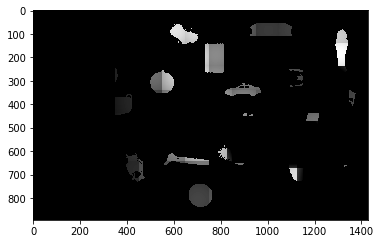

0.9207431368697997


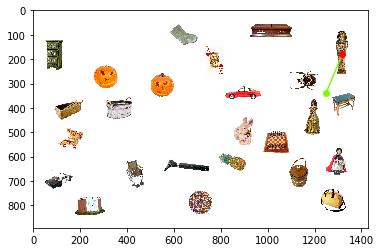

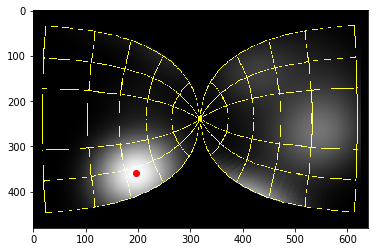

Eye_movement  8
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


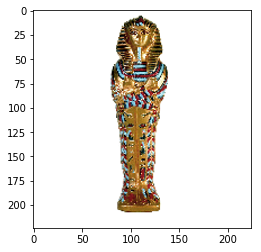

['Fixated area of the image and the classificatoin results']
0	 category: vase; confidence:7.8925,	labelID: n04522168 883
1	 category: letter opener, paper knife, paperknife; confidence:7.7724,	labelID: n03658185 623
2	 category: pedestal, plinth, footstall; confidence:7.5888,	labelID: n03903868 708
3	 category: cowboy boot; confidence:7.3657,	labelID: n03124043 514
4	 category: throne; confidence:7.1988,	labelID: n04429376 857
Priority map


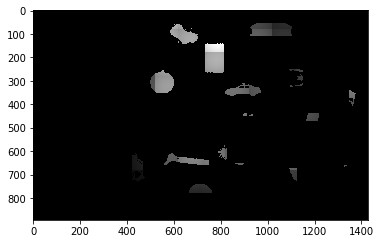

0.8511277631552606


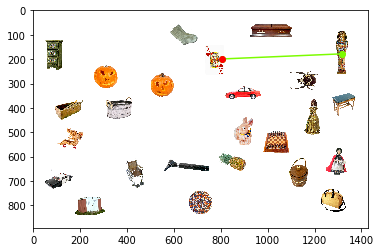

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


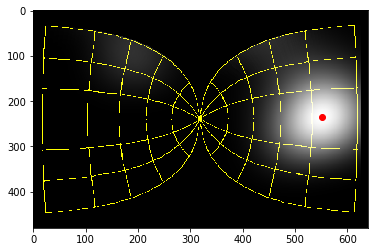

Eye_movement  9
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


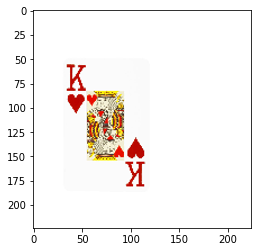

['Fixated area of the image and the classificatoin results']
0	 category: envelope; confidence:9.0763,	labelID: n03291819 549
1	 category: jersey, T-shirt, tee shirt; confidence:7.7432,	labelID: n03595614 610
2	 category: refrigerator, icebox; confidence:6.4896,	labelID: n04070727 760
3	 category: web site, website, internet site, site; confidence:6.4255,	labelID: n06359193 916
4	 category: matchstick; confidence:6.1949,	labelID: n03729826 644
Priority map


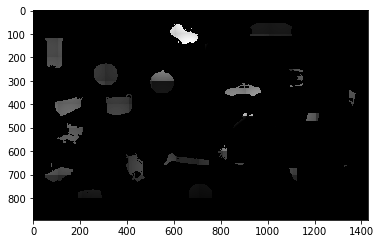

0.9843977929848259


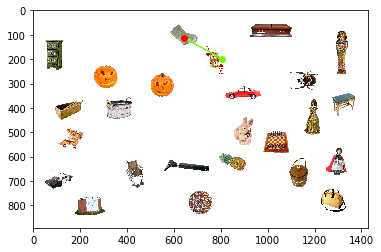

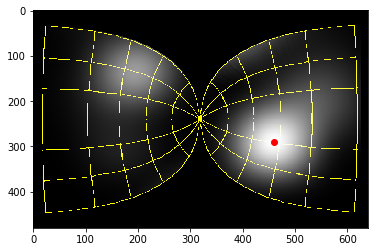

Eye_movement  10
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


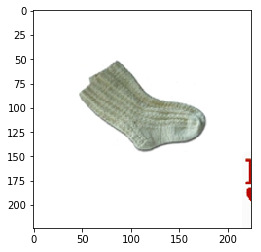

['Fixated area of the image and the classificatoin results']
0	 category: Christmas stocking; confidence:5.6315,	labelID: n03026506 496
1	 category: switch, electric switch, electrical switch; confidence:4.8542,	labelID: n04372370 844
2	 category: swab, swob, mop; confidence:4.7855,	labelID: n04367480 840
3	 category: pencil sharpener; confidence:4.7773,	labelID: n03908714 710
4	 category: water bottle; confidence:4.7748,	labelID: n04557648 898
Priority map


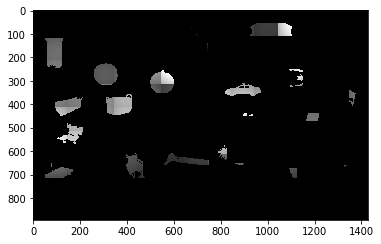

0.4635554100509483


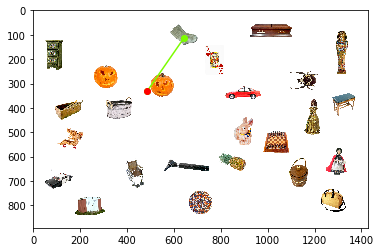

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


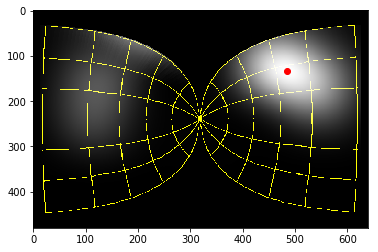

Eye_movement  11
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


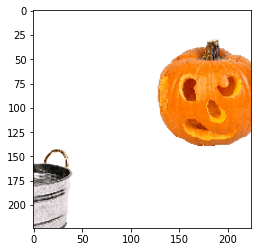

['Fixated area of the image and the classificatoin results']
0	 category: jack-o'-lantern; confidence:9.3425,	labelID: n03590841 607
1	 category: orange; confidence:7.9606,	labelID: n07747607 950
2	 category: candle, taper, wax light; confidence:7.0273,	labelID: n02948072 470
3	 category: pill bottle; confidence:7.0016,	labelID: n03937543 720
4	 category: saltshaker, salt shaker; confidence:6.8456,	labelID: n04131690 773
Priority map


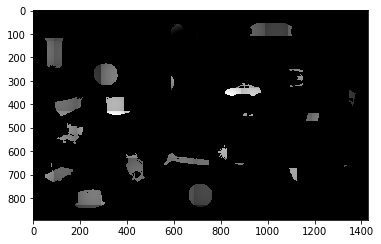

0.5839295870075095


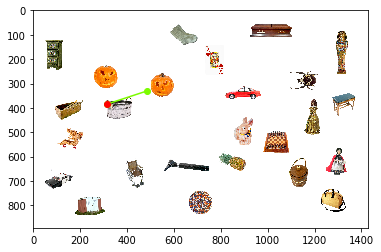

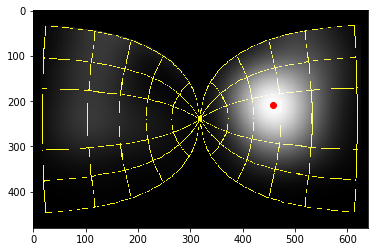

Eye_movement  12
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


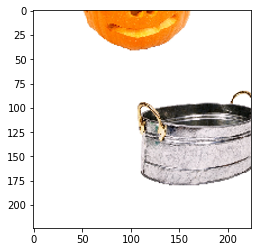

['Fixated area of the image and the classificatoin results']
0	 category: pill bottle; confidence:7.9517,	labelID: n03937543 720
1	 category: jack-o'-lantern; confidence:7.3621,	labelID: n03590841 607
2	 category: magnetic compass; confidence:7.3409,	labelID: n03706229 635
3	 category: whistle; confidence:7.1483,	labelID: n04579432 902
4	 category: orange; confidence:6.8793,	labelID: n07747607 950
Priority map


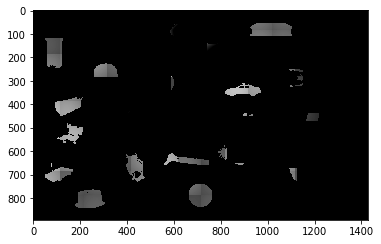

0.5701991241209045


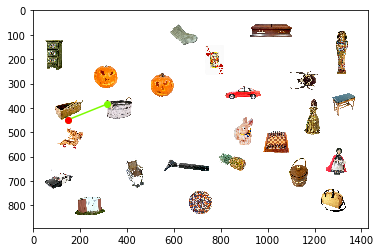

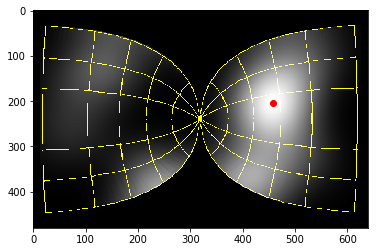

Eye_movement  13
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


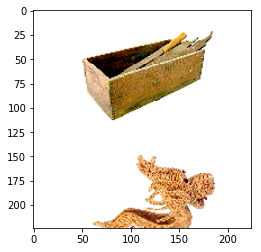

['Fixated area of the image and the classificatoin results']
0	 category: nail; confidence:9.4367,	labelID: n03804744 677
1	 category: pencil sharpener; confidence:9.3598,	labelID: n03908714 710
2	 category: plane, carpenter's plane, woodworking plane; confidence:9.0320,	labelID: n03954731 726
3	 category: honeycomb; confidence:8.7441,	labelID: n03530642 599
4	 category: mousetrap; confidence:8.3394,	labelID: n03794056 674
Priority map


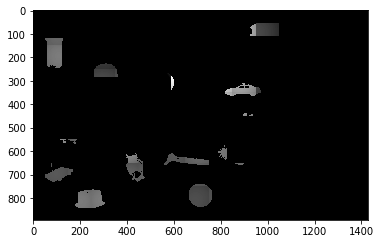

0.5950756163419033


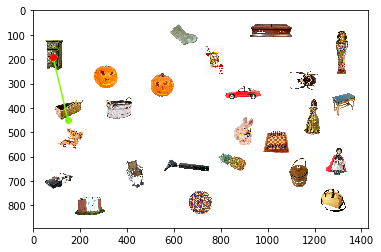

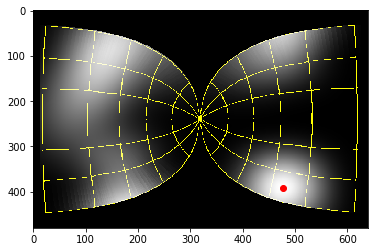

Eye_movement  14
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


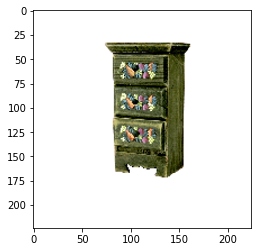

['Fixated area of the image and the classificatoin results']
0	 category: chiffonier, commode; confidence:8.3033,	labelID: n03016953 493
1	 category: wardrobe, closet, press; confidence:7.9404,	labelID: n04550184 894
2	 category: file, file cabinet, filing cabinet; confidence:7.4483,	labelID: n03337140 553
3	 category: desk; confidence:6.9924,	labelID: n03179701 526
4	 category: bookcase; confidence:6.7144,	labelID: n02870880 453
Priority map


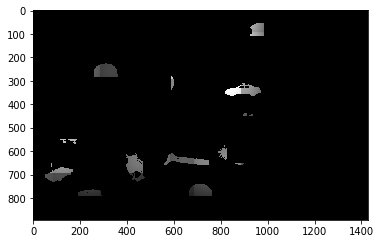

0.5361821769580516


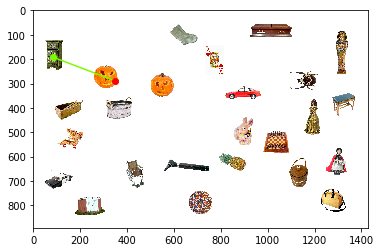

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


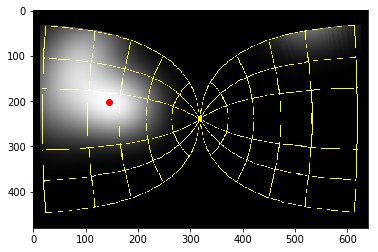

Eye_movement  15
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


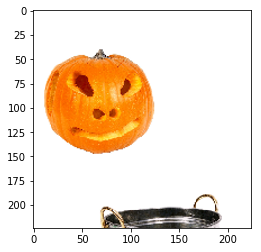

['Fixated area of the image and the classificatoin results']
0	 category: jack-o'-lantern; confidence:6.6926,	labelID: n03590841 607
1	 category: pencil sharpener; confidence:6.4445,	labelID: n03908714 710
2	 category: orange; confidence:6.1546,	labelID: n07747607 950
3	 category: whistle; confidence:5.8940,	labelID: n04579432 902
4	 category: hook, claw; confidence:5.6384,	labelID: n03532672 600
Priority map


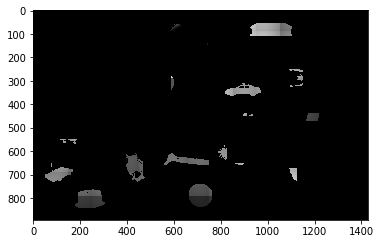

0.4455771120602095


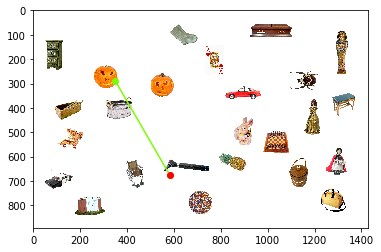

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


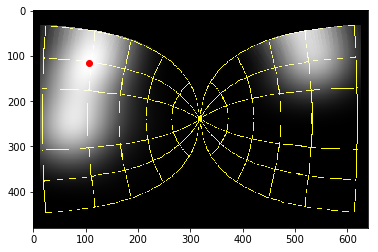

Eye_movement  16
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


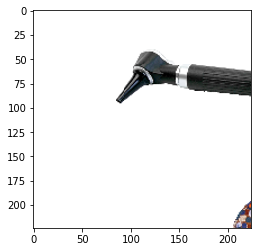

['Fixated area of the image and the classificatoin results']
0	 category: hammer; confidence:10.4564,	labelID: n03481172 587
1	 category: hatchet; confidence:9.2052,	labelID: n03498962 596
2	 category: scabbard; confidence:8.8466,	labelID: n04141327 777
3	 category: cleaver, meat cleaver, chopper; confidence:8.3880,	labelID: n03041632 499
4	 category: nail; confidence:8.1341,	labelID: n03804744 677
Priority map


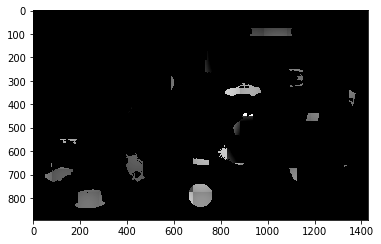

0.7727608276340651


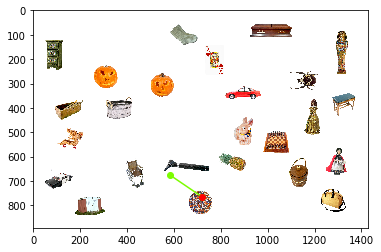

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


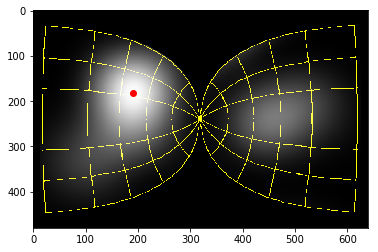

Eye_movement  17
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


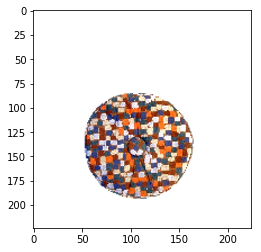

['Fixated area of the image and the classificatoin results']
0	 category: hair slide; confidence:8.9965,	labelID: n03476684 584
1	 category: maraca; confidence:8.6469,	labelID: n03720891 641
2	 category: hook, claw; confidence:6.8170,	labelID: n03532672 600
3	 category: bib; confidence:6.3143,	labelID: n02834397 443
4	 category: strawberry; confidence:6.0110,	labelID: n07745940 949
Priority map


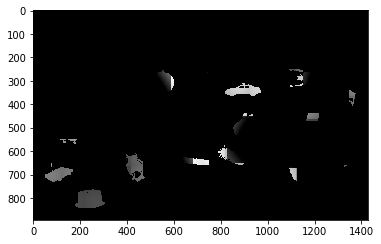

0.8856128451432076


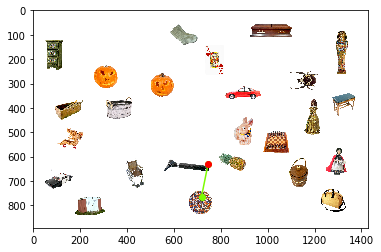

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


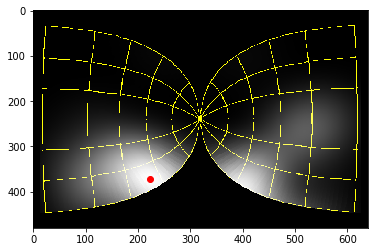

Eye_movement  18
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


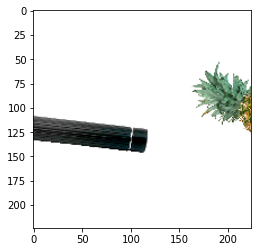

['Fixated area of the image and the classificatoin results']
0	 category: microphone, mike; confidence:6.7708,	labelID: n03759954 650
1	 category: nail; confidence:6.6484,	labelID: n03804744 677
2	 category: radio, wireless; confidence:5.7678,	labelID: n04041544 754
3	 category: screw; confidence:5.7450,	labelID: n04153751 783
4	 category: hook, claw; confidence:5.6273,	labelID: n03532672 600
Priority map


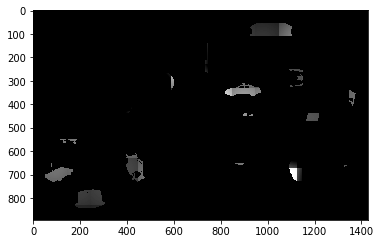

0.889889314542267


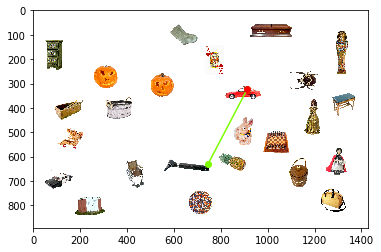

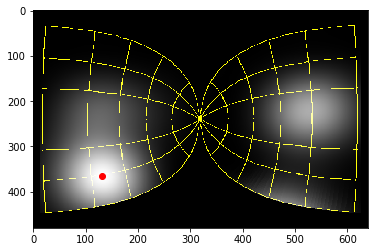

Eye_movement  19
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


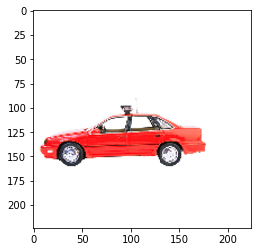

['Fixated area of the image and the classificatoin results']
0	 category: convertible; confidence:10.1634,	labelID: n03100240 511
1	 category: amphibian, amphibious vehicle; confidence:10.0916,	labelID: n02704792 408
2	 category: tow truck, tow car, wrecker; confidence:9.8435,	labelID: n04461696 864
3	 category: racer, race car, racing car; confidence:9.8006,	labelID: n04037443 751
4	 category: beach wagon, station wagon, wagon, estate car, beach waggon, station waggon, waggon; confidence:9.3971,	labelID: n02814533 436
Priority map


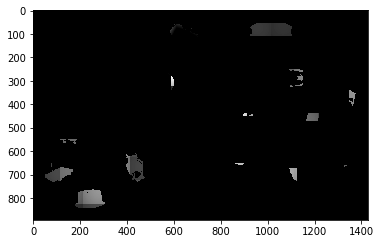

0.5515218554768049


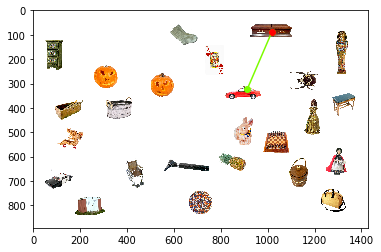

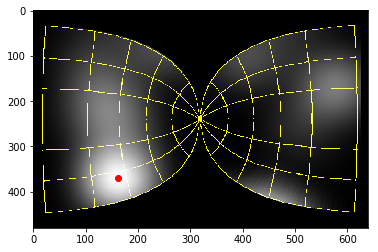

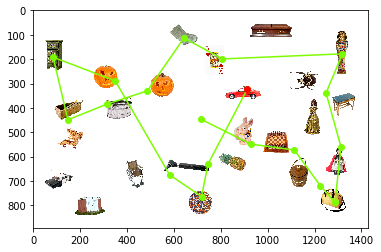

tent    672
object_array_displays_fixation_data/search_displays/present_106.png
Loading image


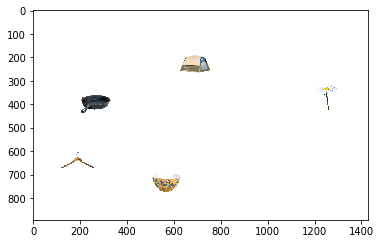

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


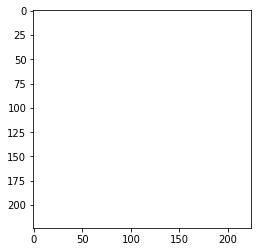

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


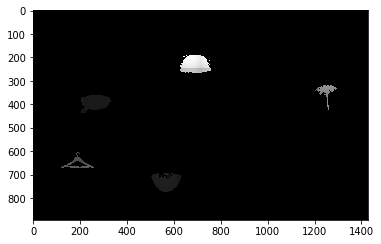

0.9999361921072725


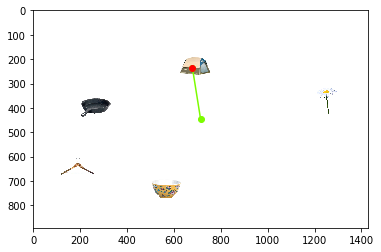

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


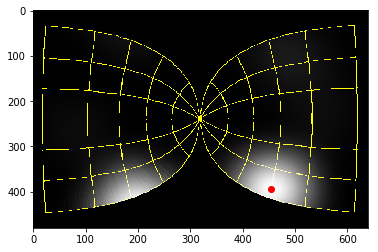

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


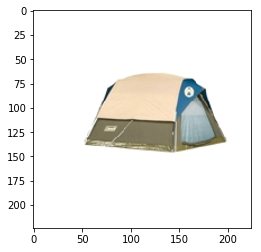

['Fixated area of the image and the classificatoin results']
0	 category: pencil sharpener; confidence:8.4834,	labelID: n03908714 710
1	 category: mountain tent; confidence:6.4740,	labelID: n03792972 672
2	 category: mousetrap; confidence:6.4438,	labelID: n03794056 674
3	 category: mouse, computer mouse; confidence:6.3195,	labelID: n03793489 673
4	 category: wallet, billfold, notecase, pocketbook; confidence:6.3136,	labelID: n04548362 893


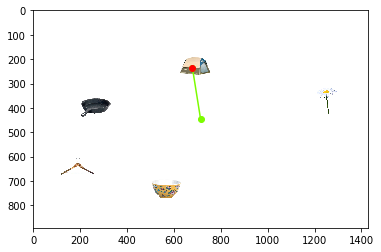

clock    409
object_array_displays_fixation_data/search_displays/present_107.png
Loading image


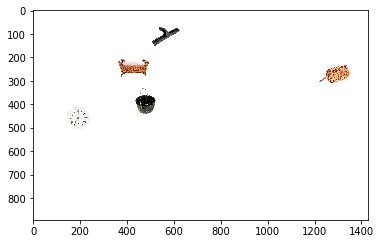

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


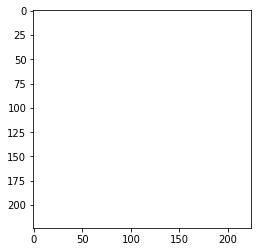

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


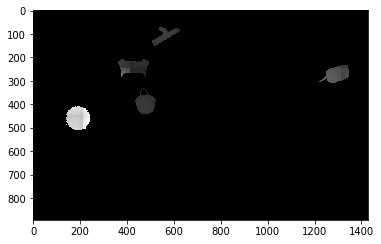

0.8099737358441481


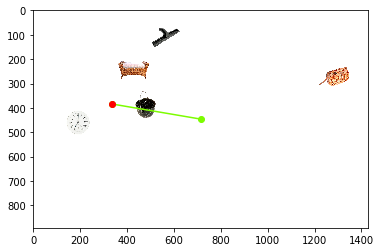

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


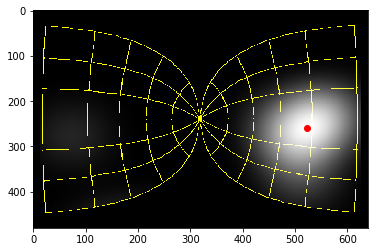

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


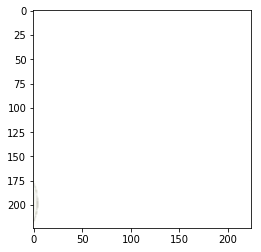

['Fixated area of the image and the classificatoin results']
0	 category: strainer; confidence:4.9563,	labelID: n04332243 828
1	 category: golf ball; confidence:4.4862,	labelID: n03445777 574
2	 category: magnetic compass; confidence:4.4481,	labelID: n03706229 635
3	 category: spotlight, spot; confidence:4.4421,	labelID: n04286575 818
4	 category: microphone, mike; confidence:4.4339,	labelID: n03759954 650
Priority map


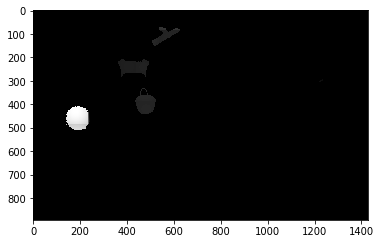

0.9040604916427024


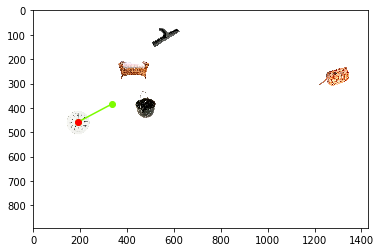

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


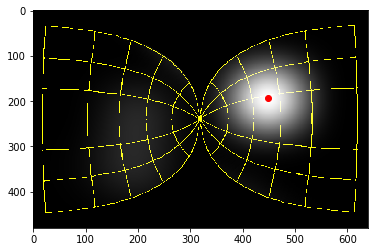

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


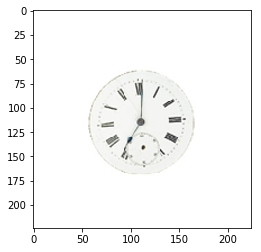

['Fixated area of the image and the classificatoin results']
0	 category: analog clock; confidence:14.3248,	labelID: n02708093 409
1	 category: wall clock; confidence:14.2647,	labelID: n04548280 892
2	 category: barometer; confidence:8.5644,	labelID: n02794156 426
3	 category: magnetic compass; confidence:7.9257,	labelID: n03706229 635
4	 category: stopwatch, stop watch; confidence:7.7017,	labelID: n04328186 826


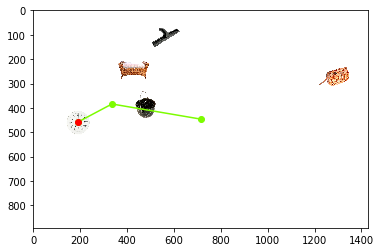

fan    545
object_array_displays_fixation_data/search_displays/present_108.png
Loading image


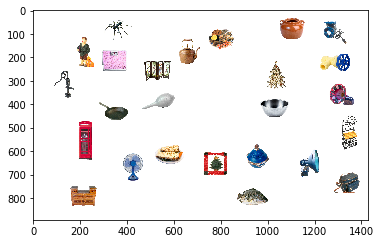

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


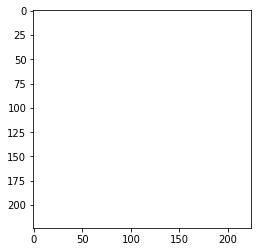

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


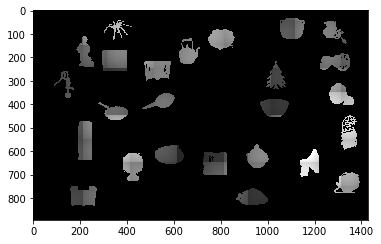

0.9569625283373233


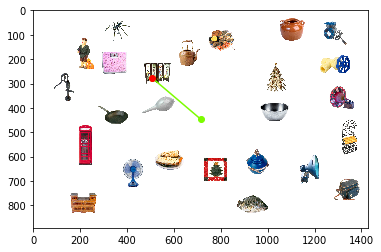

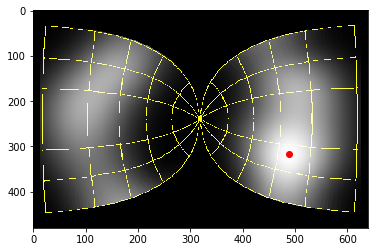

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


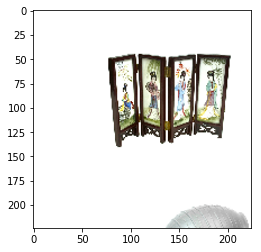

['Fixated area of the image and the classificatoin results']
0	 category: plate rack; confidence:5.2518,	labelID: n03961711 729
1	 category: binder, ring-binder; confidence:5.1980,	labelID: n02840245 446
2	 category: gong, tam-tam; confidence:5.0469,	labelID: n03447721 577
3	 category: wardrobe, closet, press; confidence:4.8824,	labelID: n04550184 894
4	 category: chime, bell, gong; confidence:4.6765,	labelID: n03017168 494
Priority map


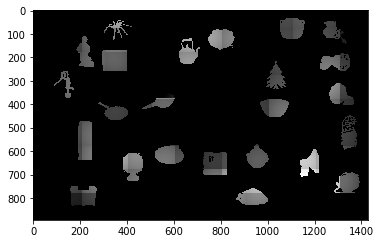

0.9846160002682718


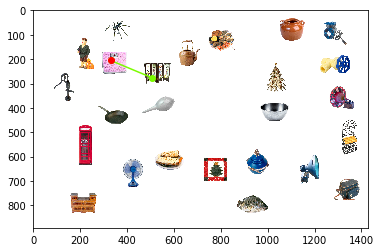

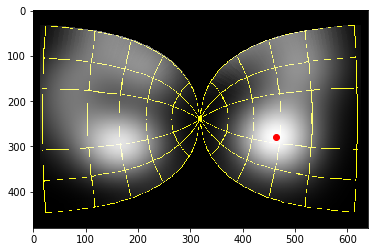

Eye_movement  3
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


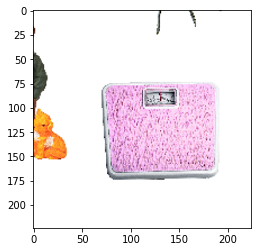

['Fixated area of the image and the classificatoin results']
0	 category: pencil sharpener; confidence:8.8697,	labelID: n03908714 710
1	 category: rubber eraser, rubber, pencil eraser; confidence:8.5074,	labelID: n04116512 767
2	 category: purse; confidence:8.0780,	labelID: n04026417 748
3	 category: pencil box, pencil case; confidence:7.2692,	labelID: n03908618 709
4	 category: safety pin; confidence:6.7822,	labelID: n04127249 772
Priority map


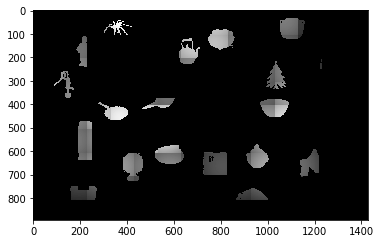

0.9739506249765241


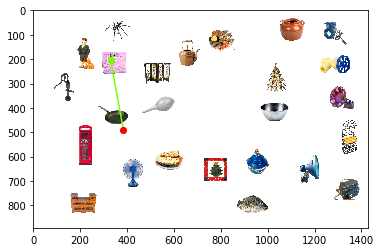

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


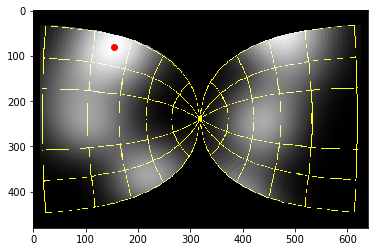

Eye_movement  4
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


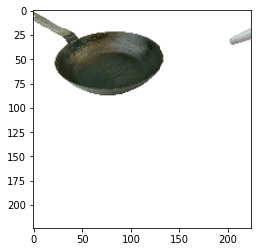

['Fixated area of the image and the classificatoin results']
0	 category: frying pan, frypan, skillet; confidence:10.2438,	labelID: n03400231 567
1	 category: wok; confidence:9.5248,	labelID: n04596742 909
2	 category: ladle; confidence:8.7287,	labelID: n03633091 618
3	 category: gong, tam-tam; confidence:8.3055,	labelID: n03447721 577
4	 category: strainer; confidence:8.2243,	labelID: n04332243 828
Priority map


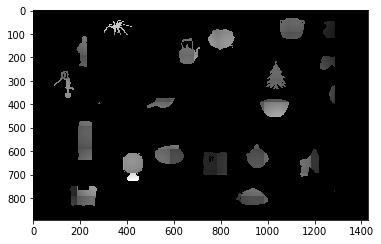

0.9206554234773981


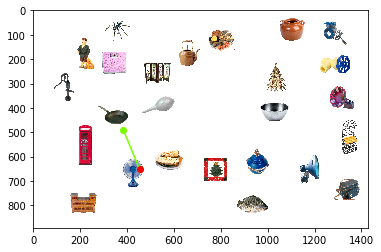

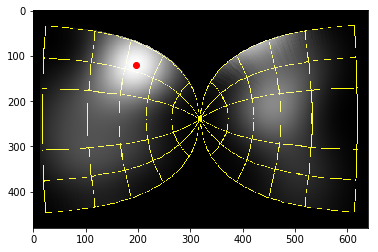

Eye_movement  5
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


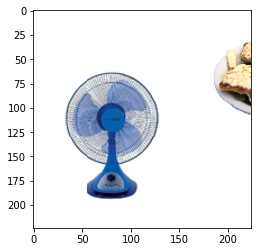

['Fixated area of the image and the classificatoin results']
0	 category: scale, weighing machine; confidence:5.3185,	labelID: n04141975 778
1	 category: hair slide; confidence:5.1993,	labelID: n03476684 584
2	 category: sandal; confidence:5.1626,	labelID: n04133789 774
3	 category: strainer; confidence:5.1086,	labelID: n04332243 828
4	 category: can opener, tin opener; confidence:5.0406,	labelID: n02951585 473
Priority map


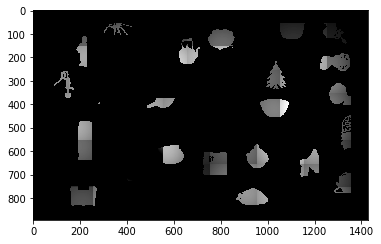

0.6360147904388306


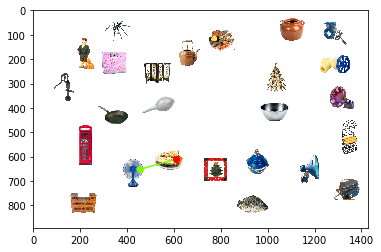

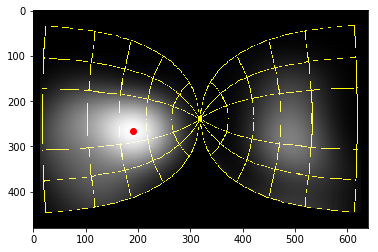

Eye_movement  6
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


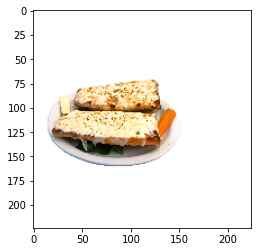

['Fixated area of the image and the classificatoin results']
0	 category: waffle iron; confidence:9.9878,	labelID: n04542943 891
1	 category: toaster; confidence:8.0328,	labelID: n04442312 859
2	 category: face powder; confidence:7.4427,	labelID: n03314780 551
3	 category: French loaf; confidence:7.4160,	labelID: n07684084 930
4	 category: plate; confidence:7.0777,	labelID: n07579787 923
Priority map


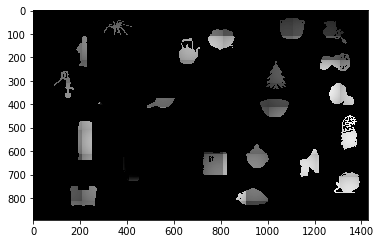

0.8847526222986362


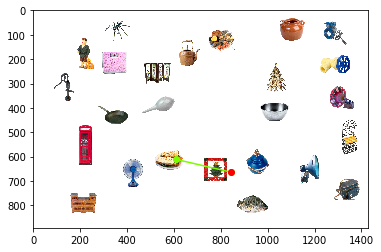

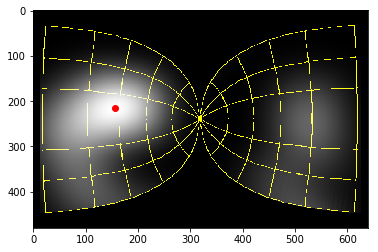

Eye_movement  7
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


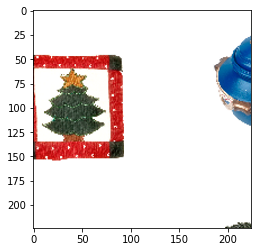

['Fixated area of the image and the classificatoin results']
0	 category: necklace; confidence:6.8987,	labelID: n03814906 679
1	 category: wallet, billfold, notecase, pocketbook; confidence:6.5566,	labelID: n04548362 893
2	 category: purse; confidence:6.3783,	labelID: n04026417 748
3	 category: bottlecap; confidence:6.1946,	labelID: n02877765 455
4	 category: packet; confidence:6.1892,	labelID: n03871628 692
Priority map


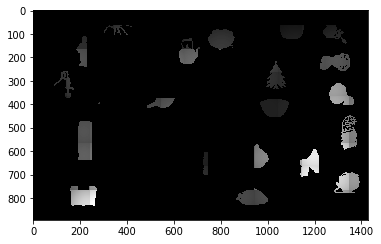

0.9978111073385727


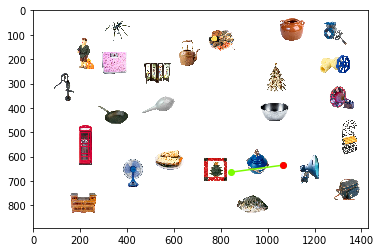

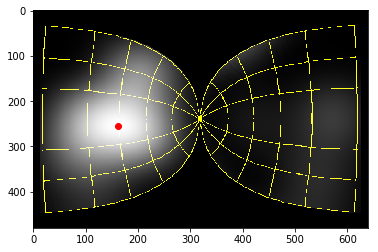

Eye_movement  8
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


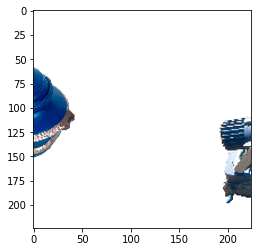

['Fixated area of the image and the classificatoin results']
0	 category: parachute, chute; confidence:7.0333,	labelID: n03888257 701
1	 category: knee pad; confidence:5.7778,	labelID: n03623198 615
2	 category: swab, swob, mop; confidence:5.5337,	labelID: n04367480 840
3	 category: puck, hockey puck; confidence:5.5148,	labelID: n04019541 746
4	 category: water bottle; confidence:5.3556,	labelID: n04557648 898
Priority map


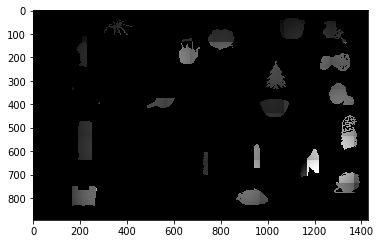

1.0


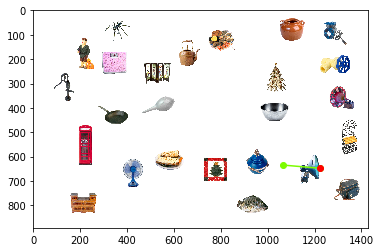

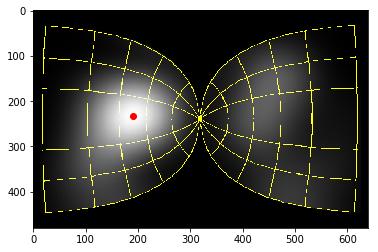

Eye_movement  9
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


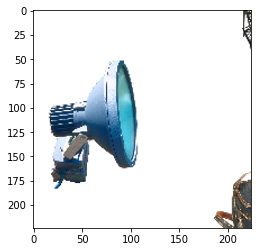

['Fixated area of the image and the classificatoin results']
0	 category: airship, dirigible; confidence:8.1221,	labelID: n02692877 405
1	 category: spotlight, spot; confidence:7.7931,	labelID: n04286575 818
2	 category: warplane, military plane; confidence:6.9215,	labelID: n04552348 895
3	 category: reel; confidence:5.7100,	labelID: n04067472 758
4	 category: wing; confidence:5.5725,	labelID: n04592741 908
Priority map


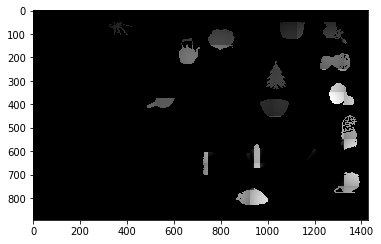

0.9916013514179864


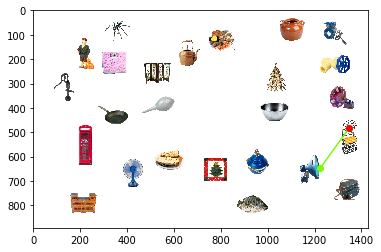

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


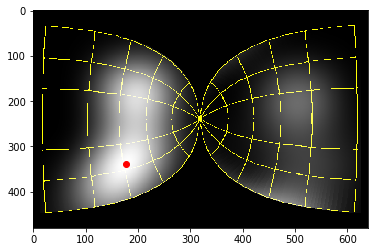

Eye_movement  10
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


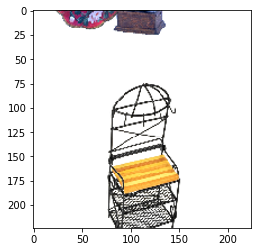

['Fixated area of the image and the classificatoin results']
0	 category: shopping cart; confidence:11.0338,	labelID: n04204347 791
1	 category: crane; confidence:10.4979,	labelID: n03126707 517
2	 category: shopping basket; confidence:9.3830,	labelID: n04204238 790
3	 category: hamper; confidence:8.3923,	labelID: n03482405 588
4	 category: mousetrap; confidence:7.8103,	labelID: n03794056 674
Priority map


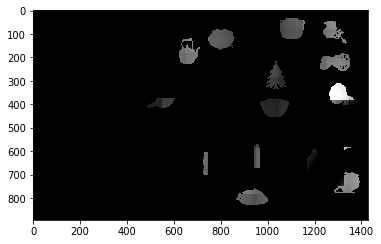

0.9121949789531844


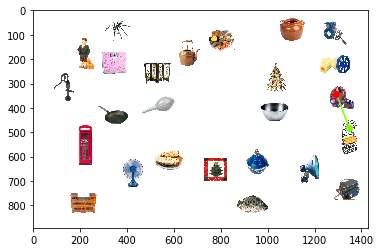

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


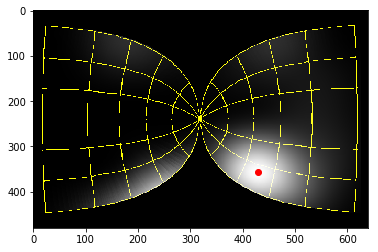

Eye_movement  11
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


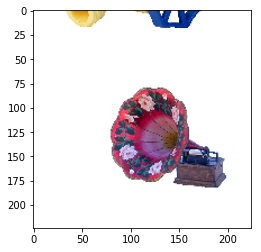

['Fixated area of the image and the classificatoin results']
0	 category: balloon; confidence:9.1646,	labelID: n02782093 417
1	 category: parachute, chute; confidence:7.0817,	labelID: n03888257 701
2	 category: hair slide; confidence:6.3745,	labelID: n03476684 584
3	 category: pencil sharpener; confidence:6.1178,	labelID: n03908714 710
4	 category: hamper; confidence:6.0925,	labelID: n03482405 588
Priority map


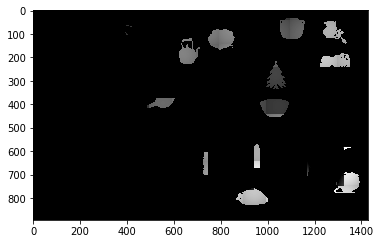

0.6316673820565853


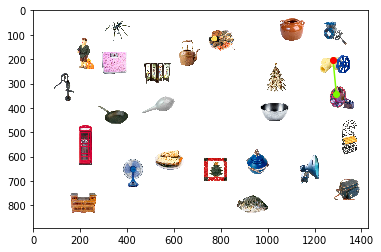

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


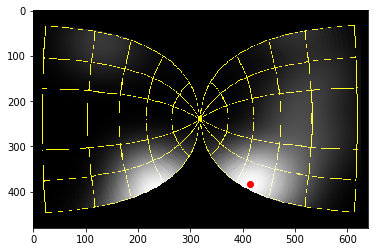

Eye_movement  12
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


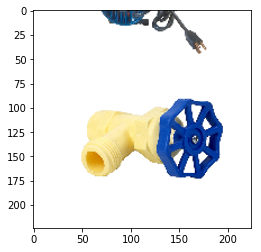

['Fixated area of the image and the classificatoin results']
0	 category: whistle; confidence:8.4838,	labelID: n04579432 902
1	 category: power drill; confidence:7.7984,	labelID: n03995372 740
2	 category: spotlight, spot; confidence:7.3906,	labelID: n04286575 818
3	 category: hook, claw; confidence:7.1336,	labelID: n03532672 600
4	 category: water bottle; confidence:6.3606,	labelID: n04557648 898
Priority map


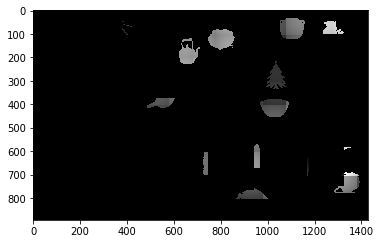

0.6536529646708314


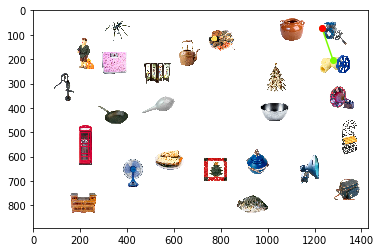

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


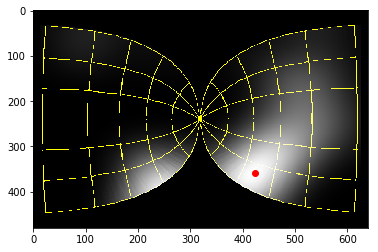

Eye_movement  13
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


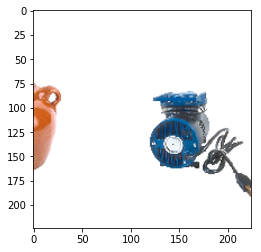

['Fixated area of the image and the classificatoin results']
0	 category: whistle; confidence:6.6785,	labelID: n04579432 902
1	 category: hair slide; confidence:6.5712,	labelID: n03476684 584
2	 category: necklace; confidence:6.2787,	labelID: n03814906 679
3	 category: piggy bank, penny bank; confidence:6.2169,	labelID: n03935335 719
4	 category: water jug; confidence:5.6295,	labelID: n04560804 899
Priority map


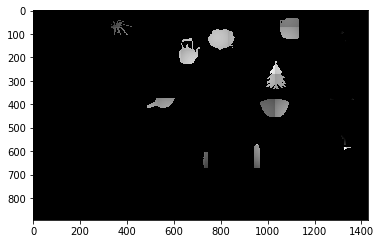

0.5475650960240236


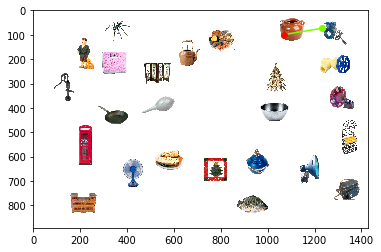

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


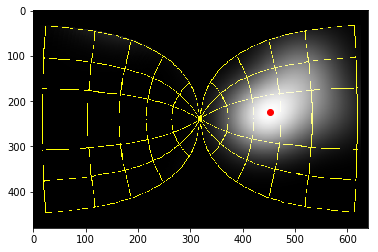

Eye_movement  14
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


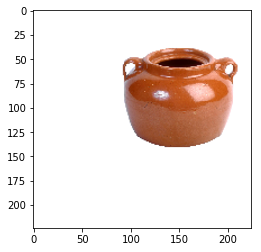

['Fixated area of the image and the classificatoin results']
0	 category: bagel, beigel; confidence:9.4413,	labelID: n07693725 931
1	 category: pretzel; confidence:9.0294,	labelID: n07695742 932
2	 category: teapot; confidence:7.3601,	labelID: n04398044 849
3	 category: piggy bank, penny bank; confidence:7.1636,	labelID: n03935335 719
4	 category: ocarina, sweet potato; confidence:7.0021,	labelID: n03840681 684
Priority map


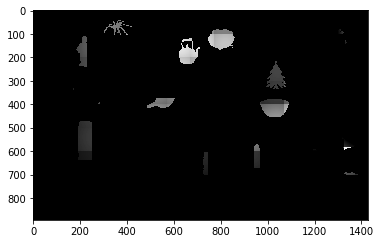

0.746399596506933


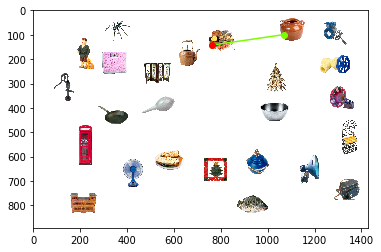

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


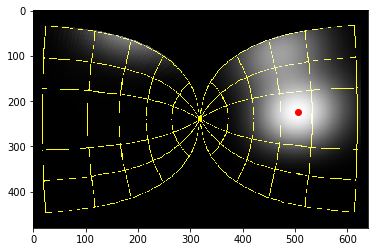

Eye_movement  15
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


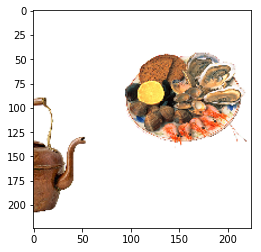

['Fixated area of the image and the classificatoin results']
0	 category: tick; confidence:7.2611,	labelID: n01776313 78
1	 category: hair slide; confidence:6.7884,	labelID: n03476684 584
2	 category: necklace; confidence:6.3569,	labelID: n03814906 679
3	 category: buckeye, horse chestnut, conker; confidence:5.5668,	labelID: n12768682 990
4	 category: hen-of-the-woods, hen of the woods, Polyporus frondosus, Grifola frondosa; confidence:5.4137,	labelID: n13052670 996
Priority map


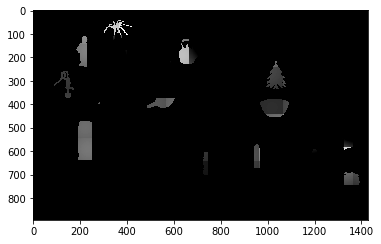

0.9811190199297832


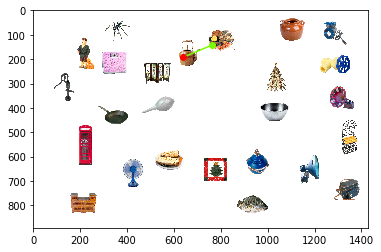

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


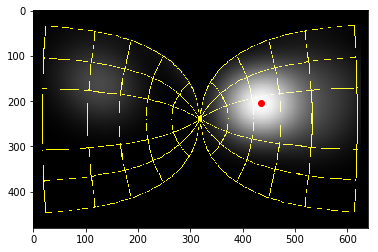

Eye_movement  16
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


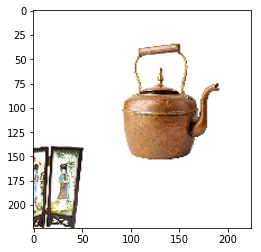

['Fixated area of the image and the classificatoin results']
0	 category: teapot; confidence:7.7672,	labelID: n04398044 849
1	 category: coffeepot; confidence:7.5400,	labelID: n03063689 505
2	 category: water jug; confidence:7.2224,	labelID: n04560804 899
3	 category: chime, bell, gong; confidence:7.1411,	labelID: n03017168 494
4	 category: pitcher, ewer; confidence:6.4002,	labelID: n03950228 725
Priority map


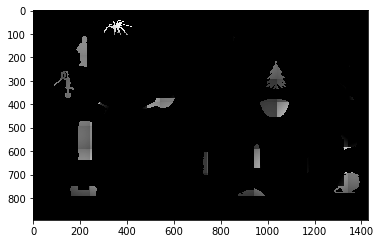

0.9545006421144232


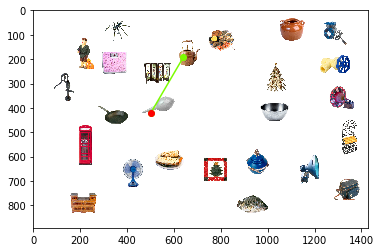

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


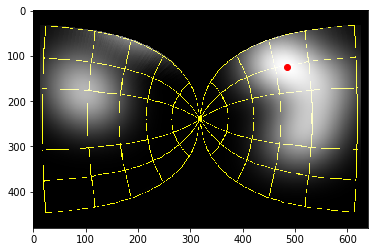

Eye_movement  17
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


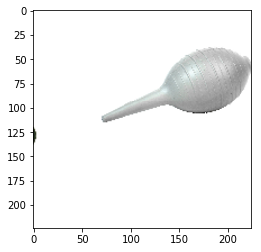

['Fixated area of the image and the classificatoin results']
0	 category: maraca; confidence:12.2264,	labelID: n03720891 641
1	 category: snail; confidence:10.2147,	labelID: n01944390 113
2	 category: acorn; confidence:8.0434,	labelID: n12267677 988
3	 category: plunger, plumber's helper; confidence:7.7453,	labelID: n03970156 731
4	 category: ladle; confidence:7.6877,	labelID: n03633091 618
Priority map


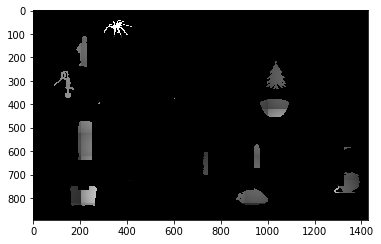

0.7994103727743856


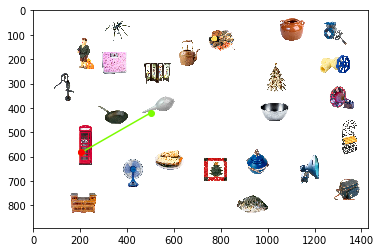

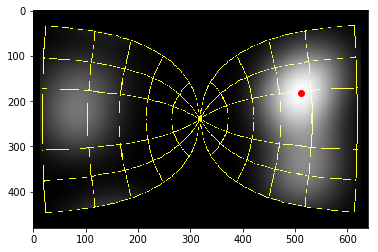

Eye_movement  18
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


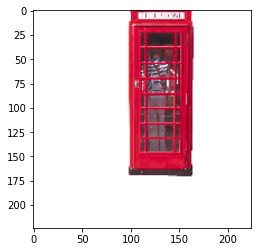

['Fixated area of the image and the classificatoin results']
0	 category: abacus; confidence:7.6647,	labelID: n02666196 398
1	 category: whistle; confidence:6.9078,	labelID: n04579432 902
2	 category: mousetrap; confidence:6.8653,	labelID: n03794056 674
3	 category: buckle; confidence:6.8271,	labelID: n02910353 464
4	 category: dial telephone, dial phone; confidence:6.6668,	labelID: n03187595 528
Priority map


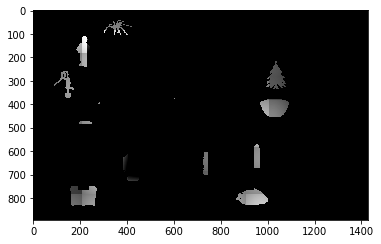

0.6893292733905811


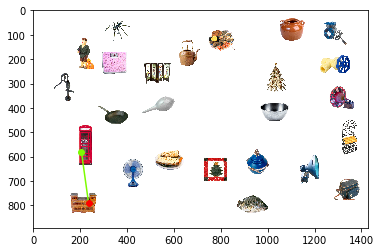

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


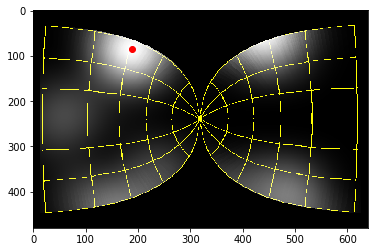

Eye_movement  19
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


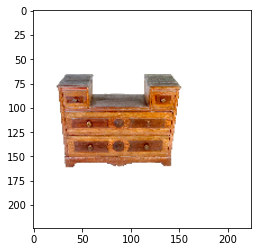

['Fixated area of the image and the classificatoin results']
0	 category: hamper; confidence:10.6898,	labelID: n03482405 588
1	 category: chest; confidence:8.8619,	labelID: n03014705 492
2	 category: crate; confidence:7.1663,	labelID: n03127925 519
3	 category: mousetrap; confidence:6.9966,	labelID: n03794056 674
4	 category: guillotine; confidence:6.6976,	labelID: n03467068 583
Priority map


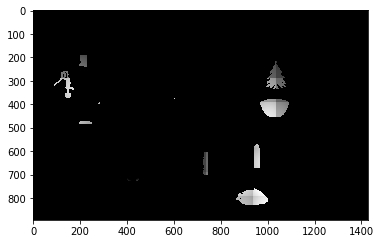

0.42870957839007123


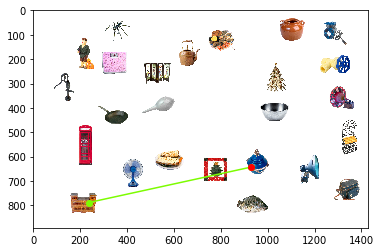

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


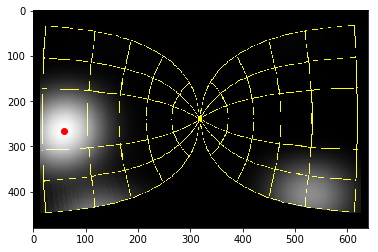

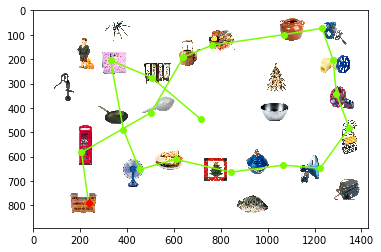

tent    672
object_array_displays_fixation_data/search_displays/present_110.png
Loading image


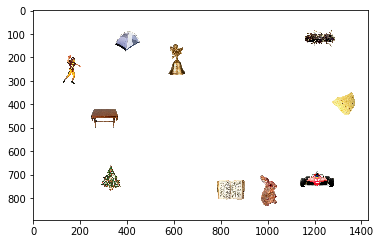

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


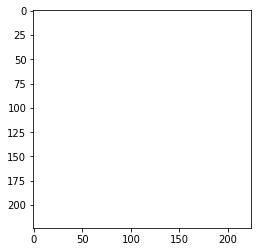

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


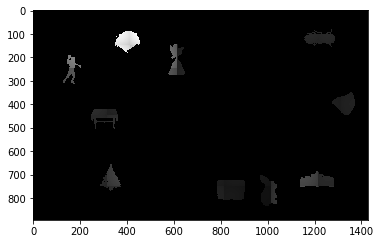

0.7882484654971859


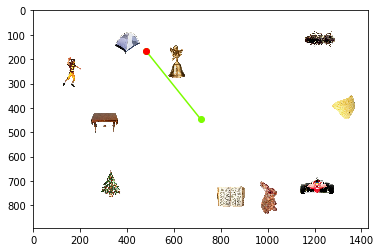

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


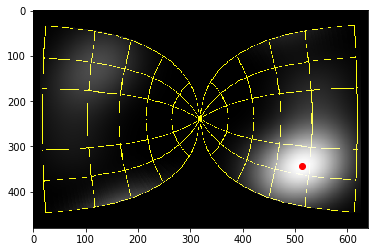

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


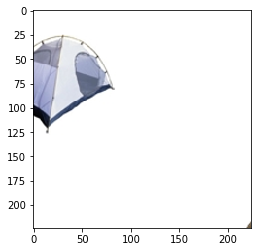

['Fixated area of the image and the classificatoin results']
0	 category: parachute, chute; confidence:11.2942,	labelID: n03888257 701
1	 category: mountain tent; confidence:10.6545,	labelID: n03792972 672
2	 category: umbrella; confidence:10.2780,	labelID: n04507155 879
3	 category: beacon, lighthouse, beacon light, pharos; confidence:6.3157,	labelID: n02814860 437
4	 category: sunglass; confidence:5.7497,	labelID: n04355933 836


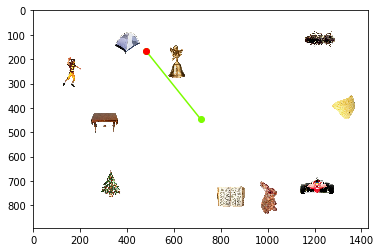

clock    409
object_array_displays_fixation_data/search_displays/present_112.png
Loading image


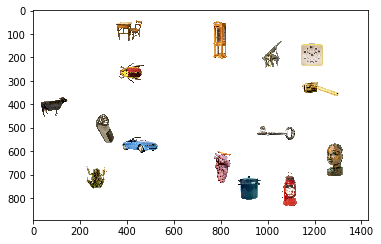

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


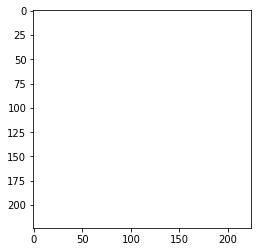

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


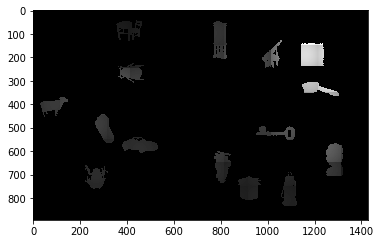

0.8593433959533052


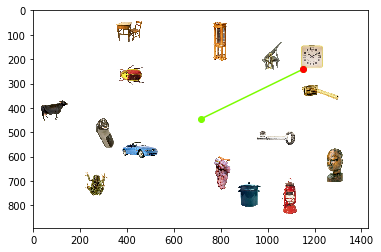

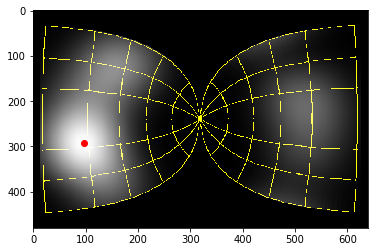

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


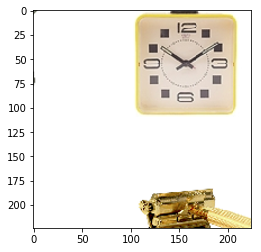

['Fixated area of the image and the classificatoin results']
0	 category: analog clock; confidence:7.8469,	labelID: n02708093 409
1	 category: switch, electric switch, electrical switch; confidence:7.4793,	labelID: n04372370 844
2	 category: pencil sharpener; confidence:7.1875,	labelID: n03908714 710
3	 category: mousetrap; confidence:7.0744,	labelID: n03794056 674
4	 category: magnetic compass; confidence:7.0107,	labelID: n03706229 635


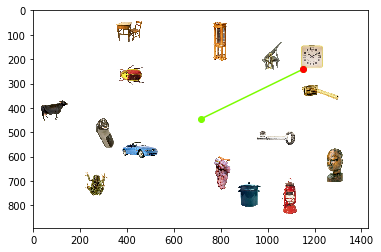

fan    545
object_array_displays_fixation_data/search_displays/present_118.png
Loading image


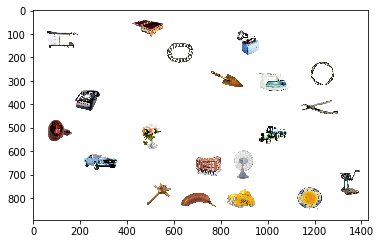

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


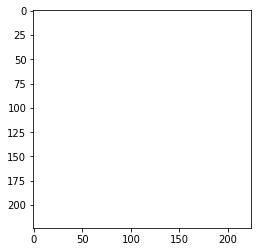

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


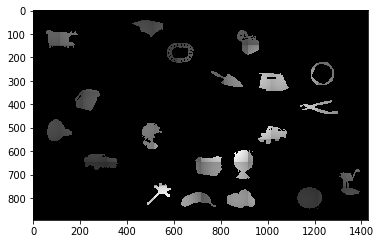

0.9844165028969648


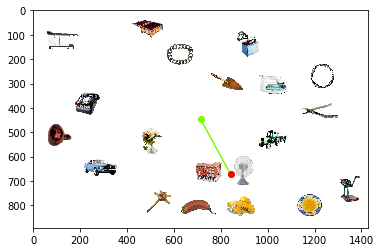

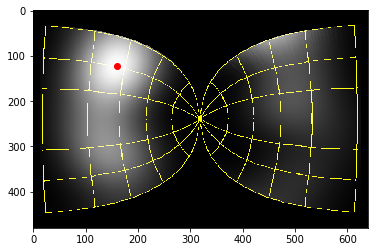

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


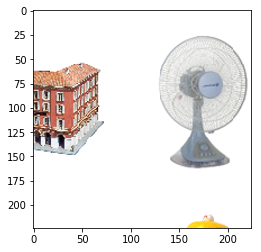

['Fixated area of the image and the classificatoin results']
0	 category: scale, weighing machine; confidence:7.3283,	labelID: n04141975 778
1	 category: electric fan, blower; confidence:6.2858,	labelID: n03271574 545
2	 category: magnetic compass; confidence:6.2366,	labelID: n03706229 635
3	 category: mousetrap; confidence:6.0453,	labelID: n03794056 674
4	 category: hamper; confidence:5.9344,	labelID: n03482405 588


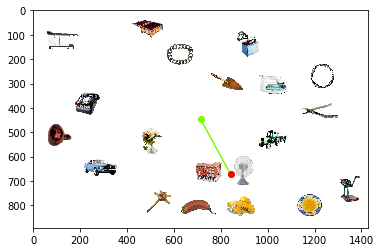

rug    741
object_array_displays_fixation_data/search_displays/present_125.png
Loading image


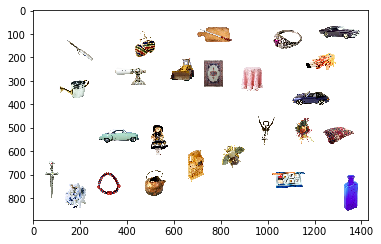

(893, 1428, 3)
Eye_movement  1
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


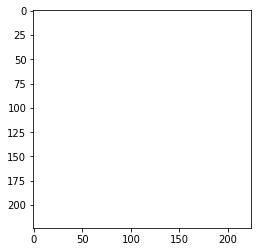

['Fixated area of the image and the classificatoin results']
0	 category: cleaver, meat cleaver, chopper; confidence:3.5071,	labelID: n03041632 499
1	 category: envelope; confidence:3.3408,	labelID: n03291819 549
2	 category: can opener, tin opener; confidence:3.0919,	labelID: n02951585 473
3	 category: corkscrew, bottle screw; confidence:3.0105,	labelID: n03109150 512
4	 category: face powder; confidence:2.9736,	labelID: n03314780 551
Priority map


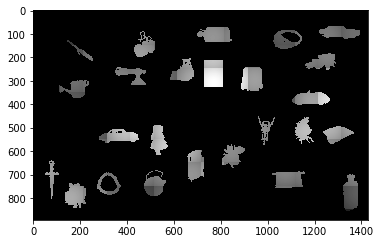

1.0


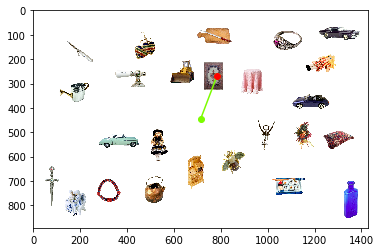

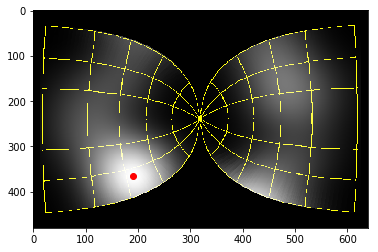

Eye_movement  2
INFO:tensorflow:Restoring parameters from ./modelparams/vgg_16.ckpt


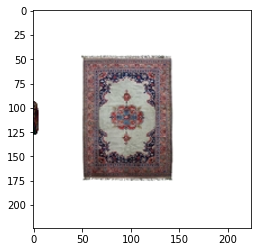

['Fixated area of the image and the classificatoin results']
0	 category: prayer rug, prayer mat; confidence:6.9032,	labelID: n03998194 741
1	 category: doormat, welcome mat; confidence:6.5009,	labelID: n03223299 539
2	 category: necklace; confidence:6.3040,	labelID: n03814906 679
3	 category: lighter, light, igniter, ignitor; confidence:6.0098,	labelID: n03666591 626
4	 category: Windsor tie; confidence:5.9338,	labelID: n04591157 906


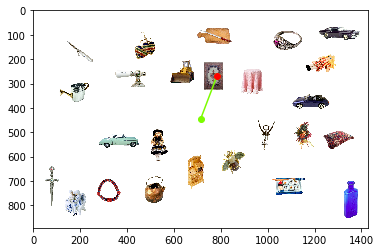

In [4]:
# RF Organization
    
crop_sizes= np.array([[200, 200], [200, 200], [250, 250], [250, 250], [300, 300], [350, 350], [400, 400], [450, 450], [500, 500]])

row_steps = [100+100*x for x in range(5)] 
col_steps = [100+100*x for x in range(8)] 
row_shifts = np.concatenate((np.negative(row_steps[::-1]) , [0] , (row_steps)), axis=0) 
col_shifts = np.concatenate((np.negative(col_steps[::-1]) , [0] , (col_steps)), axis=0) 
print(row_shifts)


# for filename in glob.glob('final_images/*.jpg'):
#test_images_path = [glob.glob(test_images_dir + "*.jpg")][0]

#image_name = 'used_TP/COCO_val2014_000000117899.jpg'

max_num_fixs = 20
use_image_foreground_for_object_arrays = 1

use_GradCAM = 1
use_CCF = 0
if (use_CCF):
    CCF_w = np.zeros( (len(cates),512))
    for c in range(len(cates)):
        image_dir = "./object_array_displays_fixation_data/CCFs_object_array_categories/"
        w = np.load(image_dir + cates[c] + '_conv5_3_mean_map_w.npy')
        CCF_w[c,:] = w / np.max(w)

apply_IOR = 1
IOR_size = 200  # pixels
IOR_offset = math.floor(IOR_size/2)
IOR_sigma = IOR_size/2 ;
filt_IOR = gauss2D([IOR_size,IOR_size], IOR_sigma) 
filt_IOR = filt_IOR/np.max(filt_IOR)

all_fixations = np.zeros((len(search_displays_data),max_num_fixs,2))
target_presence = np.zeros((len(search_displays_data)))

for im_num in range(len(search_displays_data)):
    
    
    cat_name = search_displays_data["categorical_cue"][im_num]
    cat_name = '_'.join(cat_name.split())
    
    search_target = imagenet_cat_dict[cat_name] 
    print(cat_name + '    ' + str(search_target) )
    image_name = search_displays_data["disp_im_name"][im_num]
    
    image_path = test_images_dir + '/' + image_name
    print(image_path)

    search_im = load_image(image_path)
    
    with open('./Image_names_object_array_dislays.txt', 'a') as f1:
        f1.write(image_name + os.linesep)
    
    plt.imshow(search_im)
    plt.show()
    print(search_im.shape)
    im_size = search_im.shape
    im_h = im_size[0]
    im_w = im_size[1]

    fixation_map = np.zeros((im_h+IOR_size,im_w+IOR_size));

    im_col_fix = math.floor(im_w/2) # 493 #
    im_row_fix = math.floor(im_h/2)  # 673 #
    
    im_corner_row = 1500-math.floor(im_h/2)
    im_corner_col = 2000-math.floor(im_w/2) 

    fixations_row = np.zeros((max_num_fixs))
    fixations_col = np.zeros((max_num_fixs))
    
    fixations_row[0] = im_row_fix
    fixations_col[0] = im_col_fix

    for fix in range(1,max_num_fixs):
        
        print("Eye_movement  " + str(fix))

        row_fix = im_corner_row + im_row_fix 
        col_fix = im_corner_col + im_col_fix

        im_foreground = 255-np.mean(search_im.astype(float), axis=2)
        im_foreground_norm = im_foreground #np.multiply(im_foreground,np.divide(im_foreground, im_foreground))
        nonzero = im_foreground > 0
        im_foreground_norm[nonzero] /= im_foreground[nonzero]
    #     plt.imshow(im_foreground_norm)
    #     plt.show()

        backg = 255*np.ones((3000,4000,3))
        backg[im_corner_row:im_corner_row + im_h,im_corner_col:im_corner_col+im_w,:]=search_im;
        backg = np.uint8(backg)
#         plt.imshow(backg)
#         plt.show()

        backg_RF = backg;
        sample_size = len(col_shifts)* len(row_shifts) 
        conv5_3_feat = np.zeros((sample_size,14,14,512),dtype=float)
        #conv5_3_grads = np.zeros((sample_size,14,14,512),dtype=float)
        conv5_3_p = np.zeros((sample_size,14,14),dtype=float)

        conv5_3_p_ub = np.zeros((sample_size,14,14),dtype=float)

        crop_box_center_all = np.zeros((sample_size,2),dtype=float)
        crop_box_corner_all = np.zeros((sample_size,2),dtype=float)

        g_2 = tf.Graph()          
        with g_2.as_default():
            vgg_inputs = tf.placeholder(dtype=tf.float32, shape=[None, 224, 224, 3], name='input_image')
            with slim.arg_scope(vgg_arg_scope()):
                vgg_output, vgg_endpoints = vgg(vgg_inputs, is_training=False)

            # todo: Compute gradient layer by layer
            init_fn = slim.assign_from_checkpoint_fn(model_path, slim.get_model_variables('vgg_16'))

            sess_2 = tf.Session(graph=g_2)
            sess_2.run(tf.global_variables_initializer())
            init_fn(sess_2)
            crop_index_overall = 0
            for row_RF in range(len(row_shifts)):  # 

                sample_size = len(col_shifts)
                crop_set = np.zeros((sample_size,224,224,3),dtype=float)
                crop_index = 0

                for col_RF in range(len(col_shifts)):  #
                    row_dis = abs(math.floor((len(row_shifts)/2)) - row_RF) 
                    col_dis = abs(math.floor((len(col_shifts)/2)) - col_RF) 
                    crop_ind = max(row_dis,col_dis)

                    crop_size = crop_sizes[crop_ind]
                    #print(crop_size)
                    crop_box_center = np.array([row_fix + row_shifts[row_RF] , col_fix + col_shifts[col_RF]]) 
                    crop_box_center_all[crop_index_overall] = crop_box_center
                    #print(crop_box_center)
                    crop_corner = crop_box_center - math.floor(crop_size[0]/2) 
                    crop_box_corner_all[crop_index_overall] = crop_corner
                    #print(crop_corner)
                    im_crop = image_crop(backg_RF,np.concatenate((crop_corner, crop_size), axis = 0)) 



                    s_image = Image.fromarray(im_crop)
                    s_image = s_image.resize([224, 224], resample=Image.BICUBIC)
                    im_crop_re = np.asarray(s_image, dtype=np.float32)

                    if row_RF == math.floor(len(row_shifts)/2) and col_RF == math.floor(len(col_shifts)/2):  
                        plt.imshow(s_image)
                        plt.show()
                        time.sleep(0.5)

            #         if len(s_image.shape) < 3:
            #             print("Image is not RGB 3Dimensional data")
                    im_crop_re = preprocessing.mean_image_subtraction(im_crop_re)
                    im_crop_re = np.expand_dims(im_crop_re, axis=0)

                    crop_set[crop_index,:,:,:] = im_crop_re
                    crop_index = crop_index + 1 
                    crop_index_overall = crop_index_overall + 1
                  # crop_ind = crop_array(col_RF);

                #print('Running the session')
                vgg_all_output = sess_2.run([vgg_output, vgg_endpoints], feed_dict={vgg_inputs: crop_set})
                [current_vgg_output, current_vgg_endpoints] = vgg_all_output
                
                conv5_3_f = current_vgg_endpoints['vgg_16/conv5/conv5_3']                

                if row_RF == math.floor(len(row_shifts)/2):
                    
                    print(["Fixated area of the image and the classificatoin results"])

                    s_output = current_vgg_output[math.floor(len(col_shifts)/2)]
                    sorted_cates = np.argsort(-s_output)
                    selected_cates = sorted_cates[0:5]

                    for i, catId in enumerate(selected_cates):
                        # !!!: Notice here this is a catId+1 instead of catID
                        print('{:d}\t category: {:s}; confidence:{:.4f},\tlabelID: {:s} {:d}'.format(i, labels_to_names[
                            catId + 1], s_output[catId], label_names[catId], catId))

                if use_GradCAM:
                # apply grad-cam

                    layer_name =  'vgg_16/conv5/conv5_3'
                    conv_layer = vgg_endpoints[layer_name]  #'vgg_16/conv5/conv5_3'

                    one_hot = tf.sparse_to_dense(search_target, [1000], 1.0)
                    signal_one_hot = tf.multiply(vgg_endpoints['vgg_16/fc8'], one_hot)
                    loss = tf.reduce_mean(signal_one_hot)

                    grads = tf.gradients(loss, conv_layer)[0]
                #     # Normalizing the gradients
                    norm_grads = tf.div(grads, tf.sqrt(tf.reduce_mean(tf.square(grads))) + tf.constant(1e-5))

                    outputs, grads_val, loss_val = sess_2.run([conv_layer, norm_grads, loss], feed_dict={vgg_inputs: crop_set})
            #         output = output[0]           # [7,7,512]
            #         grads_val = grads_val[0]	 # [7,7,512]
                    outputs = np.asarray(outputs)
                    grads_val = np.asarray(grads_val)
                    #outputs_re = np.reshape(outputs,(outputs.shape[0]*outputs.shape[1]*outputs.shape[2], outputs.shape[3]))

                    all_weights = np.mean(grads_val, axis = (1, 2)) 			# [?,512]
                    all_weights = all_weights/np.max(all_weights)
                    p = np.ones(outputs.shape[0 : 3], dtype = np.float32)	# [?,14,14]
                    p_ub = np.ones(outputs.shape[0 : 3], dtype=np.float32)  # [?,14,14]    
                    #np.matmul(output_re, np.transpose(weights))

                    for j in range(outputs.shape[0]):
                        weights = all_weights[j,:]
                        output = outputs[j,:]
            #           # Taking a weighted average
                        for i, w in enumerate(weights):
                            p[j,:] += w * output[:, :, i]
                        
                        
                elif(use_CCF == 1):
                                                     
                    weights = CCF_w[cates.index(cat_name),:]
                    
                    p = np.matmul(conv5_3_f,weights)
                        
                
                p_ub = np.mean(conv5_3_f, axis=3 )

                ind_beg=17*(row_RF)
                conv5_3_feat[ind_beg:ind_beg+17,:,:,:] = current_vgg_endpoints['vgg_16/conv5/conv5_3']
                #conv5_3_grads[ind_beg:ind_beg+17,:,:,:] = grads_val
                conv5_3_p[ind_beg:ind_beg+17,:,:] = p

                conv5_3_p_ub[ind_beg:ind_beg+17,:,:] = p_ub


        if(s_output[search_target] > 5  and search_target in selected_cates[:5]):
            target_presence[im_num] = 1
            break
        
        priority_big = np.zeros((3000,4000))

        crop_box_center_all = crop_box_center_all.astype(int)
        priority_big[crop_box_center_all[:,0], crop_box_center_all[:,1]] = np.max(conv5_3_p, axis = (1, 2))

        filt = gauss2D( (200,200), 100)
        priority_big_map = signal.fftconvolve(priority_big, filt, mode='same')

        priority_map = priority_big_map[im_corner_row:im_corner_row+im_h, im_corner_col:im_corner_col + im_w]
        priority_map = priority_map/np.max(priority_map)
        #priority_map = priority_map 
        if (use_image_foreground_for_object_arrays == 1):
            priority_map = np.multiply(im_foreground_norm, priority_map)

        if (apply_IOR): 
            #fixation_map[row_im_f+IOR_offset,col_im_f+IOR_offset] = 1 
            fixation_map[im_row_fix:im_row_fix+2*IOR_offset,im_col_fix:im_col_fix+2*IOR_offset] = \
                fixation_map[im_row_fix:im_row_fix+2*IOR_offset,im_col_fix:im_col_fix+2*IOR_offset] + filt_IOR
            IOR_map = fixation_map[IOR_offset:IOR_offset+im_h,IOR_offset:IOR_offset+im_w] 
            #IOR_map = IOR_map / np.max(IOR_map)
            priority_map_fixs = priority_map - IOR_map 
            priority_map_fixs= priority_map_fixs.clip(min=0)
            
            

        print("Priority map")
        plt.imshow(priority_map_fixs, cmap='gray')  # _fixs/np.max(priority_map_fixs)
        plt.show()
        time.sleep(0.5)
        print(np.max(priority_map_fixs))
        if(np.max(priority_map_fixs) < 0.4):
            break
            
        # MASC_core is the main function 
        # input arguments: 
        #     priority_map: Priority map
        #     RETINA_PIXDEG: The number of pixels in one degree visual angle of the visual display  
        #     im_col_fix: The column for the current fixation (x)
        #     im_row_fix: The row for the current fixtion (y)
        # outputs: 
        #     col_im_m: The column for the next fixation (x)
        #     row_im_m: The row for the next fixation (x)
        #     moto_Coll_framed: The activity map in the motor layer of the SC 
        #     col_m_coll: the column coordiatne of the winning population in the SC motor map
        #     row_m_coll: the row coordiatne of the winning population in the SC motor map

        RETINA_PIXDEG = 22
        col_im_m, row_im_m, moto_Coll_framed, col_m_coll, row_m_coll = MASC_core(priority_map_fixs, RETINA_PIXDEG, im_col_fix, im_row_fix)



        plt.imshow(search_im, aspect='auto')
        plt.plot([im_col_fix, col_im_m], [im_row_fix, row_im_m], '-o', color='lawngreen')
        plt.plot(col_im_m, row_im_m, 'o',color='red')
        plt.show()

        plt.imshow(moto_Coll_framed, aspect='auto')
        plt.plot(col_m_coll, row_m_coll, 'o',color='red')
        plt.show()

        im_col_fix = col_im_m
        im_row_fix = row_im_m

        fixations_row[fix] = im_row_fix
        fixations_col[fix] = im_col_fix

    plt.imshow(search_im, aspect='auto')
    plt.plot(fixations_col[0:fix], fixations_row[0:fix], '-o', color='lawngreen')
    plt.plot(fixations_col[fix-1], fixations_row[fix-1], 'o',color='red')
    plt.savefig('./object_array_displays_fixation_data/GradCAM_model_scanpaths_present/' + image_name.split('.')[0] + \
                '_scanpath_'+ str(target_presence[im_num]) + '.jpg')

    plt.show()
    
    
    all_fixations[im_num,:,0] = fixations_col
    all_fixations[im_num,:,1] = fixations_row
    
    np.save('Deep-BCN_GradCAM_object_array_target_present.npy',all_fixations)
    np.save('Deep-BCN_GradCAM_object_array_target_present_response.npy',target_presence)

In [5]:
target_presence

array([1., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0.,
       1., 1., 1., 1., 1., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 0., 1., 1., 0., 1., 1., 1., 1.])

In [6]:
1 - sum(target_presence)/45

0.11111111111111116

In [7]:
sum(target_presence)

40.0